In [1]:
import matplotlib
# matplotlib.use('qt5agg')
import matplotlib.pyplot as plt
import time
import numpy as np
import query_db
import matplotlib.gridspec as gridspec
import spectral_analysis as sa
from scipy.special import erf
import datafidelity as df

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [22]:
query_dm15_max_fewer_bins = ["SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source < .95 or dm15_from_fits < .95)) and source != 'swift_uv'",
                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source >= .95 and dm15_source < 1.15) or (dm15_from_fits >= .95 and dm15_from_fits < 1.15)) and source != 'swift_uv'",
                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source >= 1.15 and dm15_source < 1.25) or (dm15_from_fits >= 1.15 and dm15_from_fits < 1.25)) and source != 'swift_uv' and Supernovae.SN not in ('2006x', '2008ia')",
                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source >= 1.25 and dm15_source < 1.42) or (dm15_from_fits >= 1.25 and dm15_from_fits < 1.42)) and source != 'swift_uv'",
                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source >= 1.42 and dm15_source < 1.7) or (dm15_from_fits >= 1.42 and dm15_from_fits < 1.7)) and source != 'swift_uv'",
                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source >= 1.7 or dm15_from_fits >= 1.7)) and source != 'swift_uv'"]
# query_dm15_max_fewer_bins = ["SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -2 and phase <= 2 and ((dm15_source < .95 or dm15_from_fits < .95)) and source != 'swift_uv'",
#                          "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -2 and phase <= 2 and ((dm15_source >= .95 and dm15_source < 1.15) or (dm15_from_fits >= .95 and dm15_from_fits < 1.15)) and source != 'swift_uv'",
#                          "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -2 and phase <= 2 and ((dm15_source >= 1.15 and dm15_source < 1.25) or (dm15_from_fits >= 1.15 and dm15_from_fits < 1.25)) and source != 'swift_uv' and Supernovae.SN not in ('2006x', '2008ia')",
#                          "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -2 and phase <= 2 and ((dm15_source >= 1.25 and dm15_source < 1.42) or (dm15_from_fits >= 1.25 and dm15_from_fits < 1.42)) and source != 'swift_uv'",
#                          "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -2 and phase <= 2 and ((dm15_source >= 1.42 and dm15_source < 1.7) or (dm15_from_fits >= 1.42 and dm15_from_fits < 1.7)) and source != 'swift_uv'",
#                          "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -2 and phase <= 2 and ((dm15_source >= 1.7 or dm15_from_fits >= 1.7)) and source != 'swift_uv'"]
# query_dm15_max_fewer_bins = ["SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and (dm15_cfa < .9 or dm15_from_fits < .9)",
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= .9 and dm15_cfa < 1.) or (dm15_from_fits >= .9 and dm15_from_fits < 1))",
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= 1 and dm15_cfa < 1.05) or (dm15_from_fits >= 1 and dm15_from_fits < 1.05))",
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= 1.05 and dm15_cfa < 1.1) or (dm15_from_fits >= 1.05 and dm15_from_fits < 1.1))",
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= 1.1 and dm15_cfa < 1.2) or (dm15_from_fits >= 1.1 and dm15_from_fits < 1.2))",
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= 1.2 and dm15_cfa < 1.3) or (dm15_from_fits >= 1.2 and dm15_from_fits < 1.3))", 
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= 1.3 and dm15_cfa < 1.4) or (dm15_from_fits >= 1.3 and dm15_from_fits < 1.4))", 
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_cfa >= 1.4 and dm15_cfa < 1.6) or (dm15_from_fits >= 1.4 and dm15_from_fits < 1.6))",
#                         "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and (dm15_cfa >= 1.6 or dm15_from_fits >= 1.6)"]

In [23]:
comps_dm15_max_fewer_bins_med, sn_arrays_med, boot_sn_arrays_med = query_db.main(len(query_dm15_max_fewer_bins), query_dm15_max_fewer_bins, boot='b', medmean=2)

SQL Query: SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source < .95 or dm15_from_fits < .95)) and source != 'swift_uv'
159 questionable files currently ignored
1 questionable spectra removed 76 spectra left
0 Peculiar Ias removed 76 spectra left
74 spectra with host corrections
159 questionable files currently ignored
27 valid SNe found
Arrays cleaned
27 spectra may have telluric contamination
1994s sn1994s-19940616-uoi.flm 34.8971198257 0.94 None 0.998840596273 0.015177 bsnip 3124.0 11082.0 11.0
Host correction...
1998es sn1998es-19981125-ui-corrected.flm 69.1436677309 0.85 None 0.496750833938 0.010567 bsnip 3346.0 10044.0 8.0
Host correction...
1999aa sn1999aa-19990223-ui.flm 44.0459361476 0.78 None 0.460351148368 0.014443 bsnip 3344.0 10350.0 14.0
Host correction...
2001cp sn2001cp-20010629-ui.flm 24.0178237234 0.88 None 0.917447344588 0.022402 bsnip 3278.0 10124.0 13.0
Host correction...
2001eh sn2001eh

In [24]:
SN = sn_arrays_med[0][0]
print np.median(SN.ivar[SN.x1:SN.x2])

49906.3078189


In [6]:
# comps_dm15_max_fewer_bins_mean, sn_arrays_mean, boot_sn_arrays_mean = query_db.main(len(query_dm15_max_fewer_bins), query_dm15_max_fewer_bins, boot='b', medmean=1)
comps_dm15_max_fewer_bins_mean, sn_arrays_mean, boot_sn_arrays_mean = query_db.main(len(query_dm15_max_fewer_bins), query_dm15_max_fewer_bins, boot='b', medmean=1, selection='max_coverage')

SQL Query: SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ((dm15_source < .95 or dm15_from_fits < .95)) and source != 'swift_uv'
159 questionable files currently ignored
1 questionable spectra removed 76 spectra left
0 Peculiar Ias removed 76 spectra left
74 spectra with host corrections
159 questionable files currently ignored
27 valid SNe found
Arrays cleaned
27 spectra may have telluric contamination
1994s sn1994s-19940616-uoi.flm 34.8971198257 0.94 None 0.998840596273 0.015177 bsnip 3124.0 11082.0 11.0
Host correction...
1998es sn1998es-19981125-ui-corrected.flm 69.1436677309 0.85 None 0.496750833938 0.010567 bsnip 3346.0 10044.0 8.0
Host correction...
1999aa sn1999aa-19990223-ui.flm 44.0459361476 0.78 None 0.460351148368 0.014443 bsnip 3344.0 10350.0 14.0
Host correction...
2001cp sn2001cp-20010629-ui.flm 24.0178237234 0.88 None 0.917447344588 0.022402 bsnip 3278.0 10124.0 13.0
Host correction...
2001eh sn2001eh

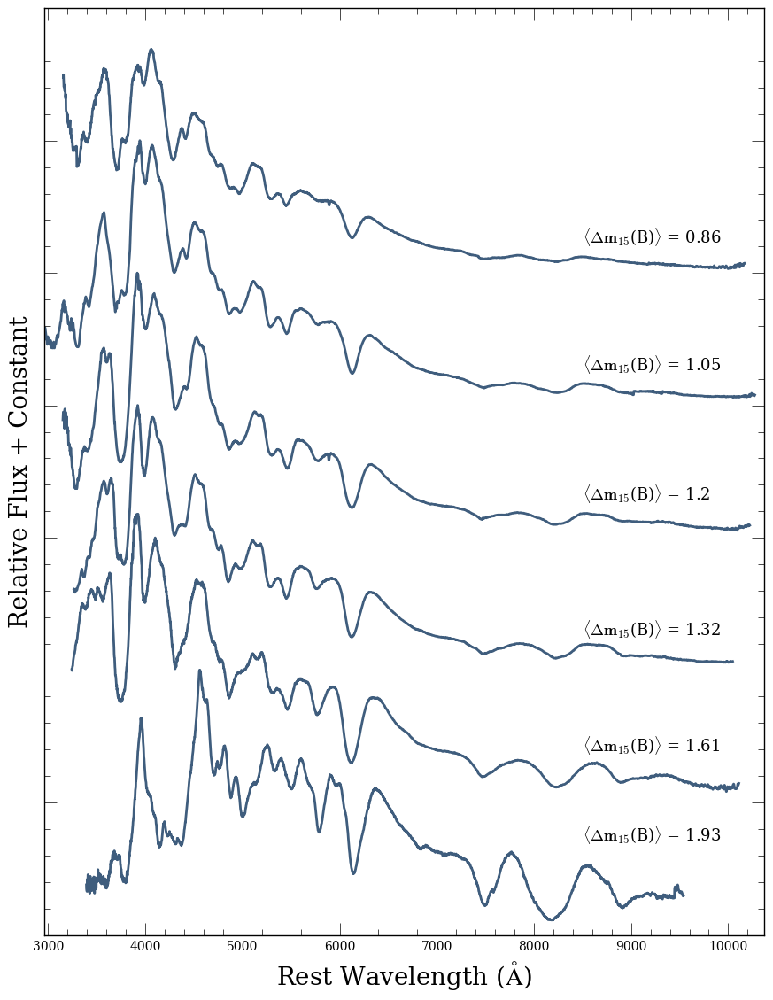

In [121]:
query_db.set_min_num_spec(comps_dm15_max_fewer_bins_mean, 5)
query_db.stacked_plot(comps_dm15_max_fewer_bins_mean, savename = 'main_composites/dm15_split_max')
# query_db.stacked_plot(comps_dm15_max_fewer_bins_mean)

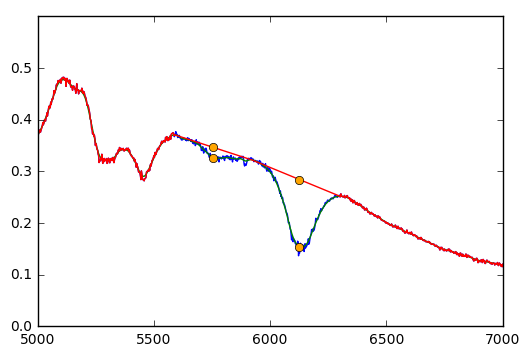

0.88 0.151973550521


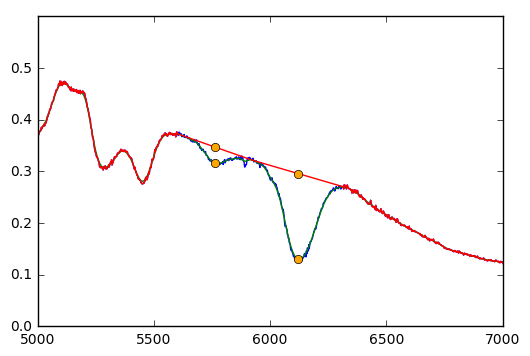

1.06 0.189242134797


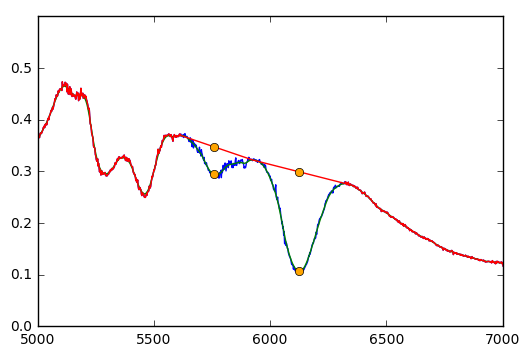

1.2 0.27662024053


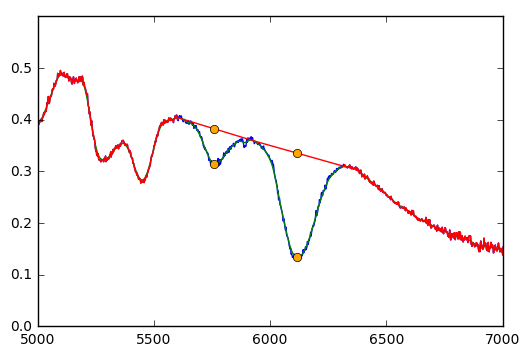

1.33 0.334305492888


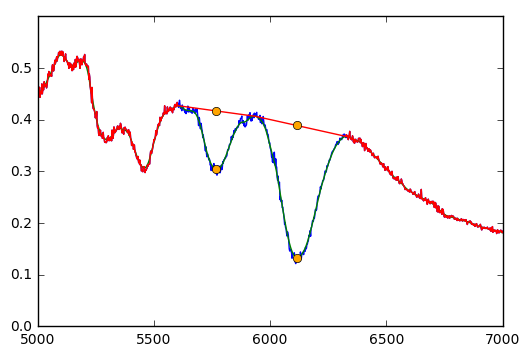

1.57 0.441379643482


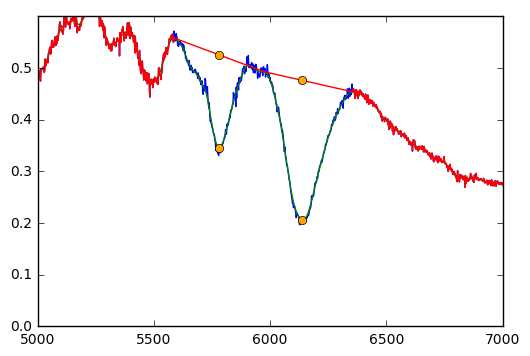

1.91 0.665934873164


In [7]:
si_ratios_med = []
phases_med = []
dm15s_med = []
for comp in comps_dm15_max_fewer_bins_med:
    p = np.average(comp.phase_array[comp.x1:comp.x2])
    dm15 = np.round(np.nanmean(comp.dm15_array[comp.x1:comp.x2]),2)
    r = sa.measure_si_ratio(comp.wavelength[comp.x1:comp.x2], comp.flux[comp.x1:comp.x2], vexp=.002)
    print dm15, r
    phases_med.append(p)
    dm15s_med.append(dm15)
    si_ratios_med.append(r)

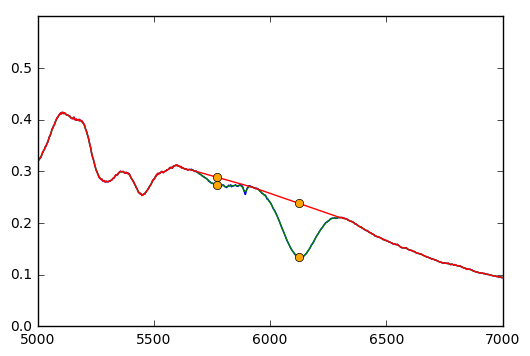

0.86 0.149559842986


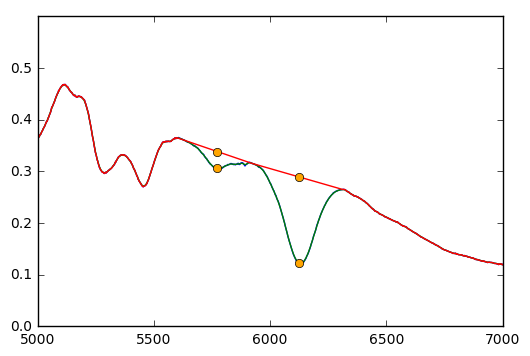

1.06 0.196297311956


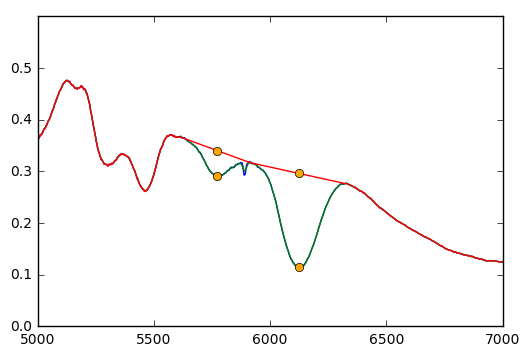

1.2 0.272171287658


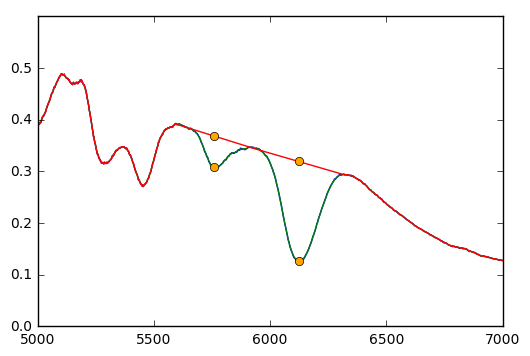

1.33 0.309794389839


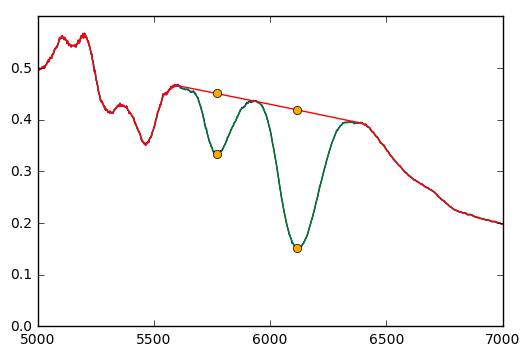

1.6 0.438638170124


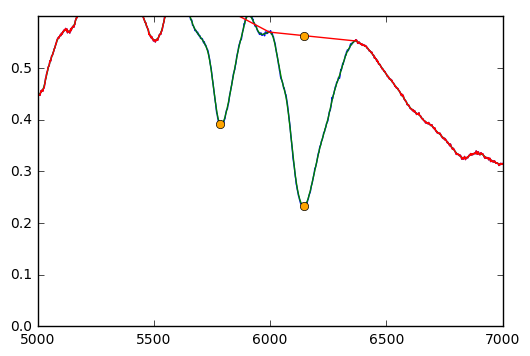

1.93 0.693520632634


In [8]:
si_ratios_mean = []
phases_mean = []
dm15s_mean = []
for comp in comps_dm15_max_fewer_bins_mean:
    p = np.average(comp.phase_array[comp.x1:comp.x2])
    dm15 = np.round(np.nanmean(comp.dm15_array[comp.x1:comp.x2]),2)
    r = sa.measure_si_ratio(comp.wavelength[comp.x1:comp.x2], comp.flux[comp.x1:comp.x2], vexp=.001)
    print dm15, r
    phases_mean.append(p)
    dm15s_mean.append(dm15)
    si_ratios_mean.append(r)

0


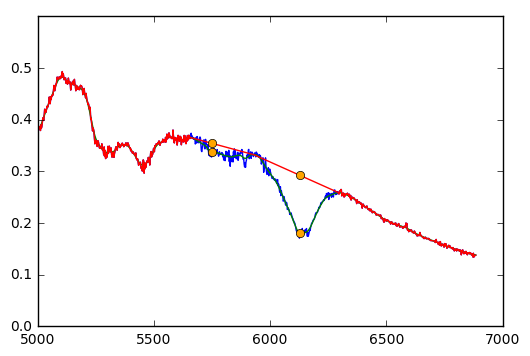

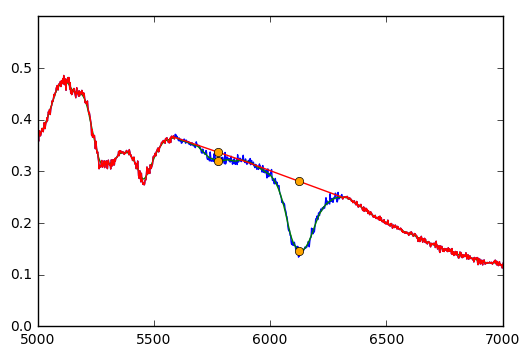

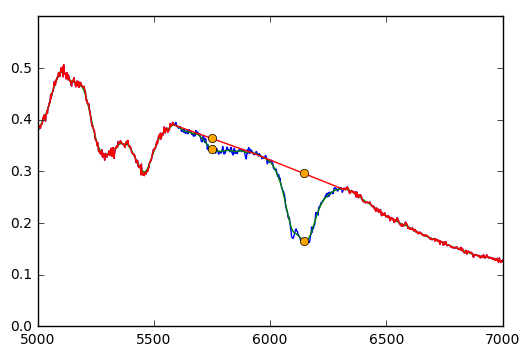

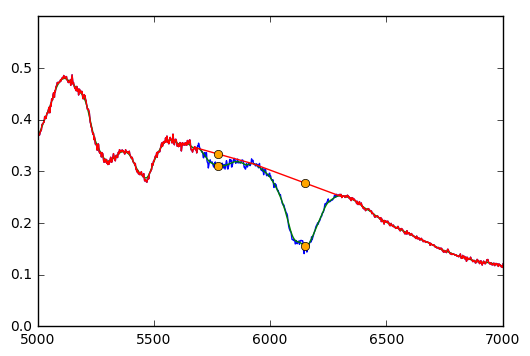

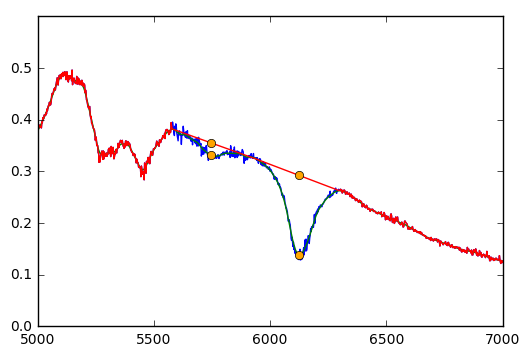

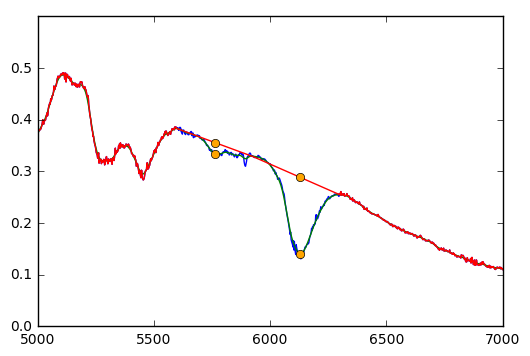

Could not find maximum in a specified range!


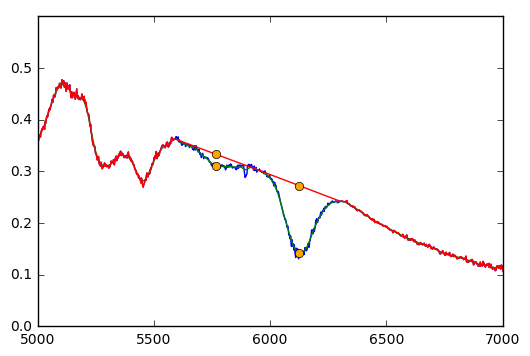

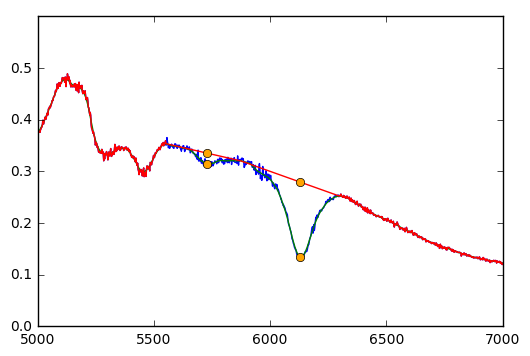

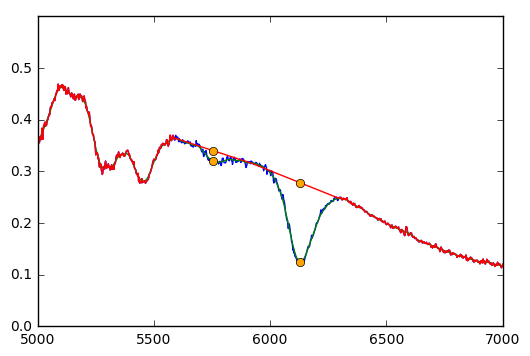

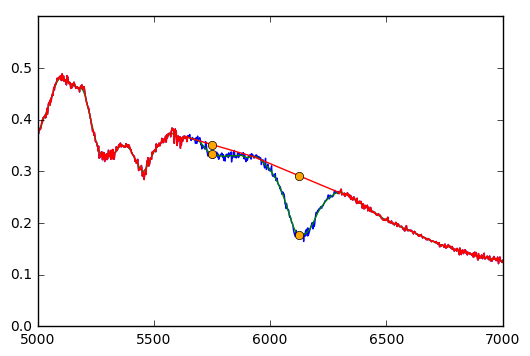

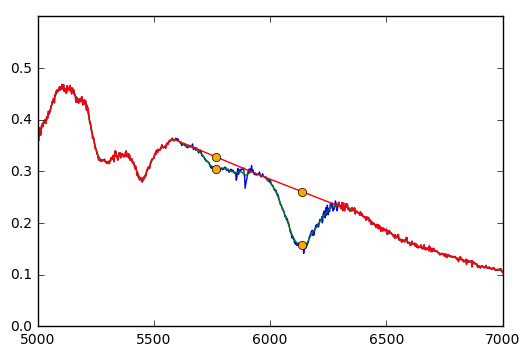

...

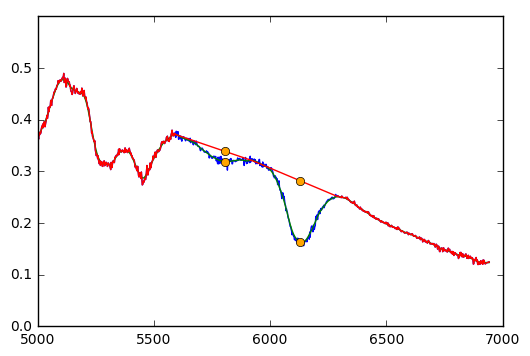

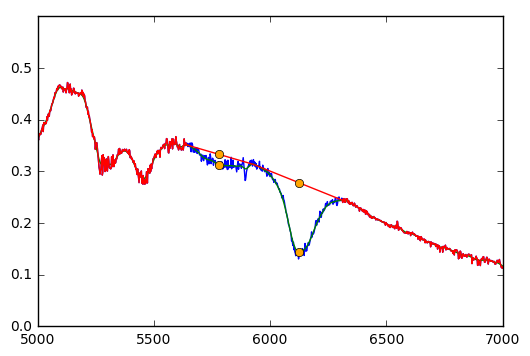

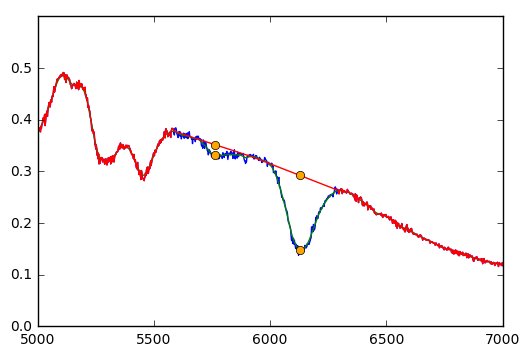

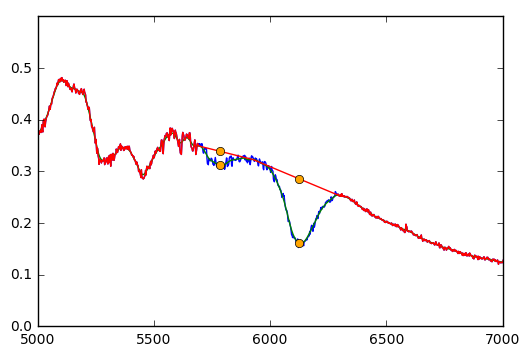

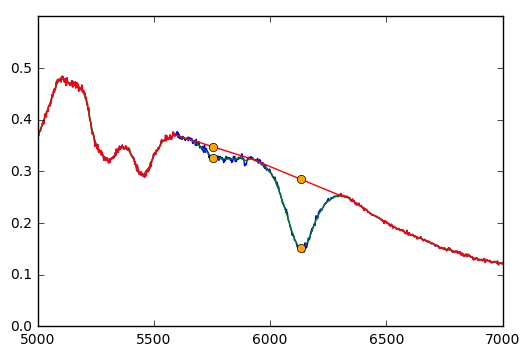

Could not find maximum in a specified range!


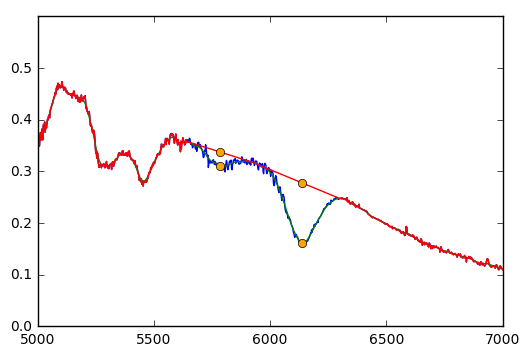

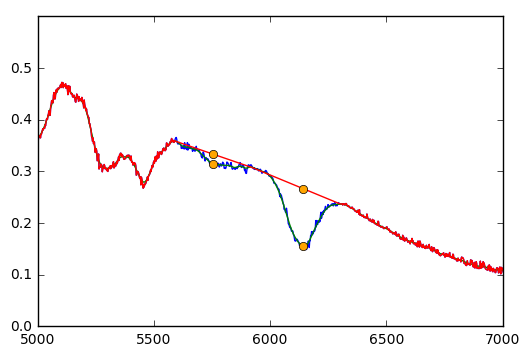

Could not find maximum in a specified range!
Could not find maximum in a specified range!


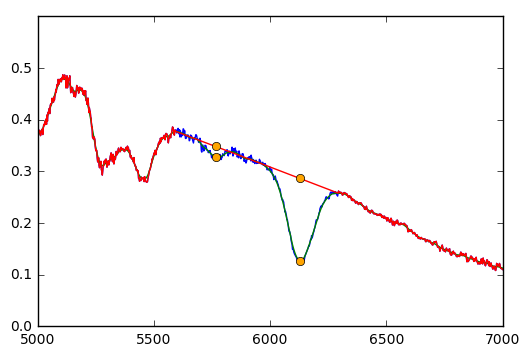

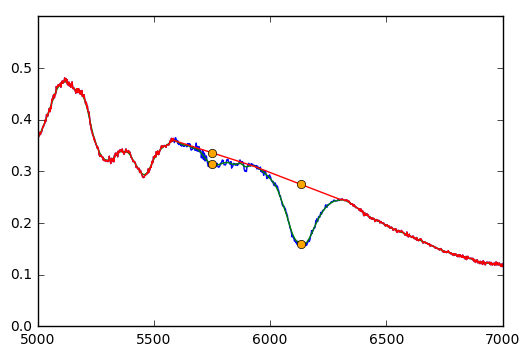

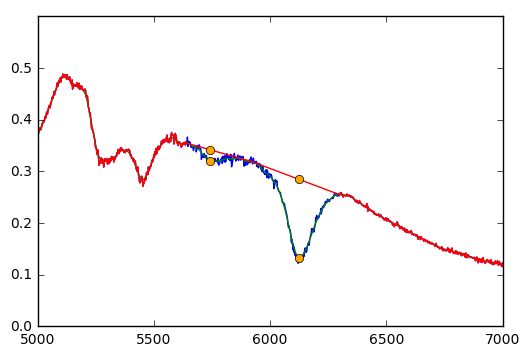

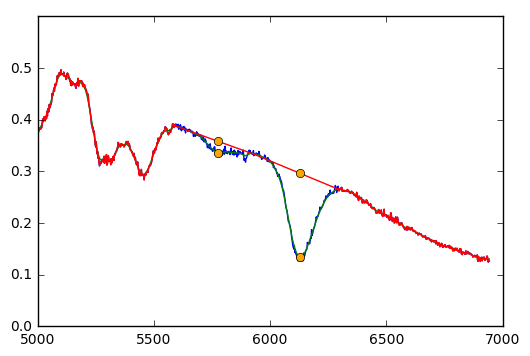

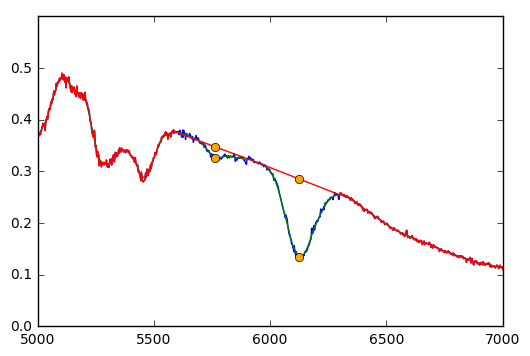

...

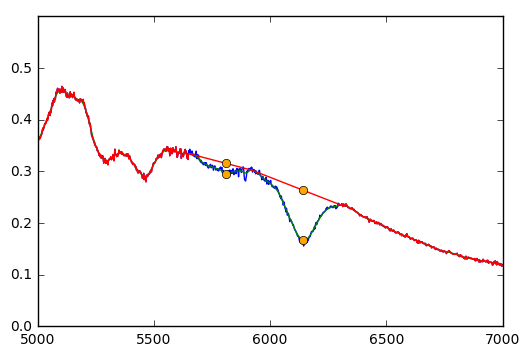

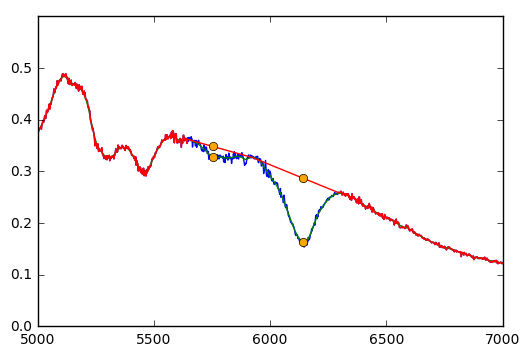

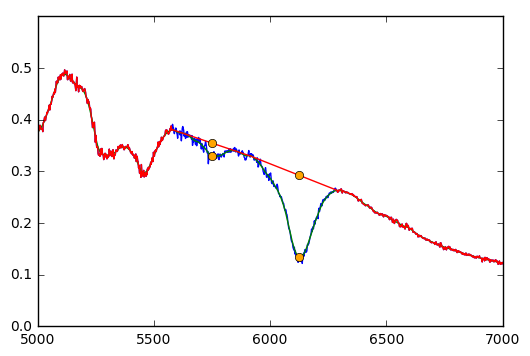

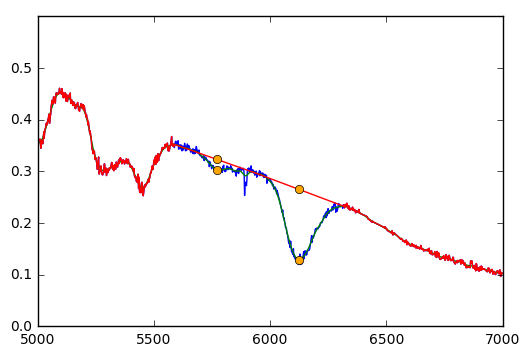

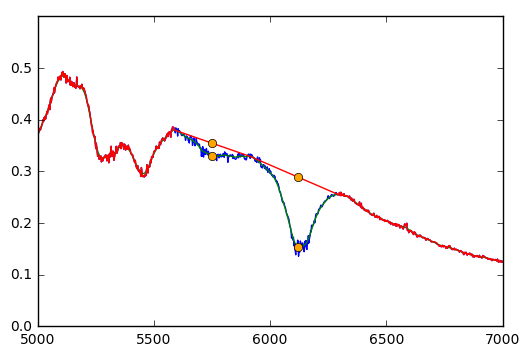

Could not find maximum in a specified range!


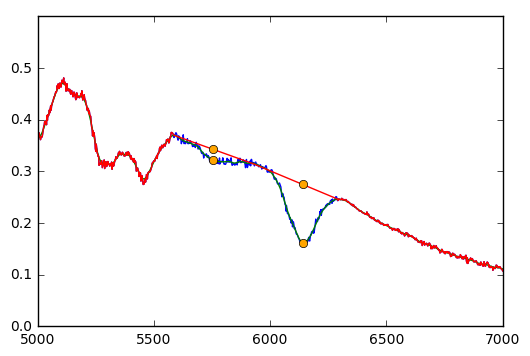

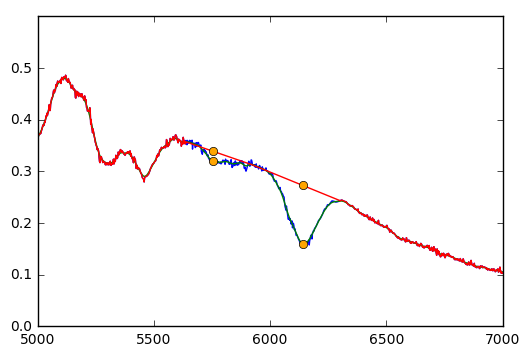

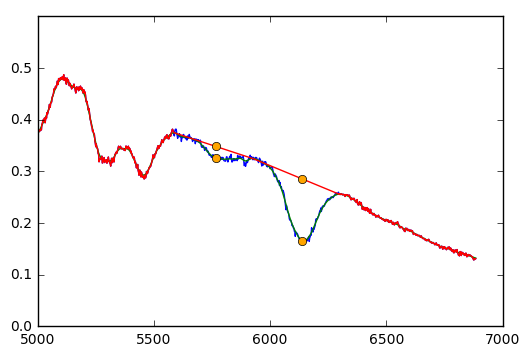

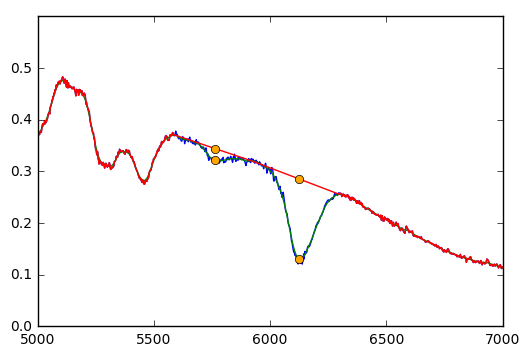

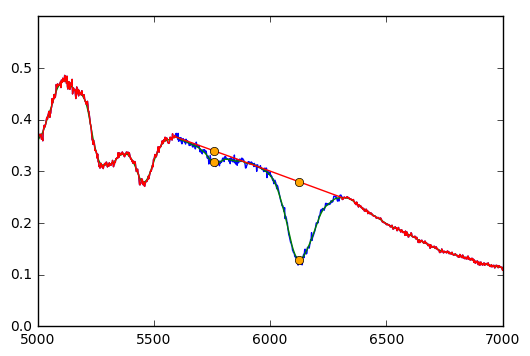

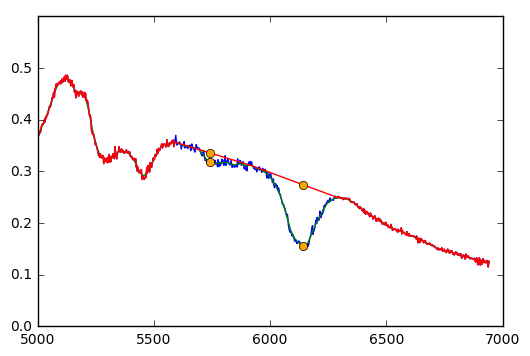

Could not find maximum in a specified range!


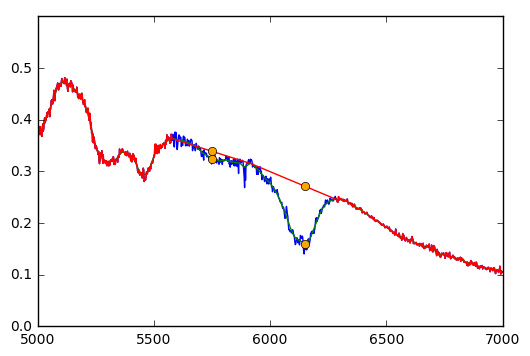

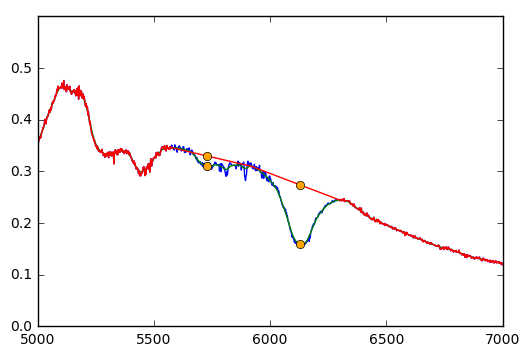

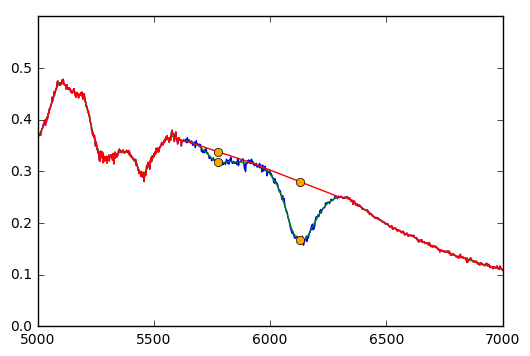

Could not find maximum in a specified range!


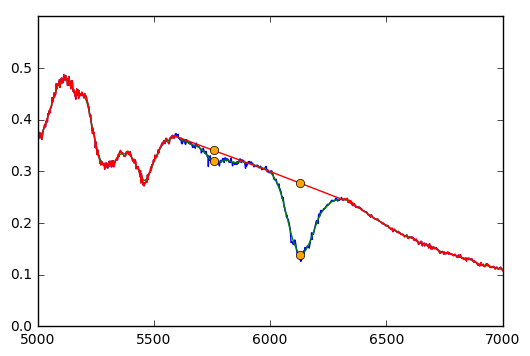

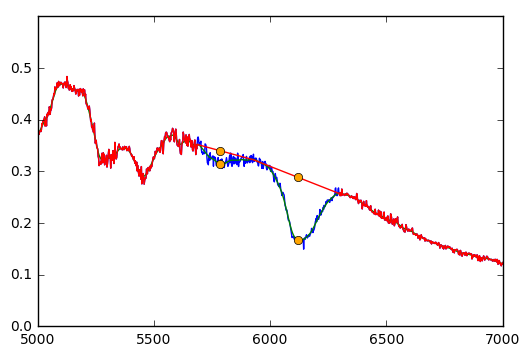

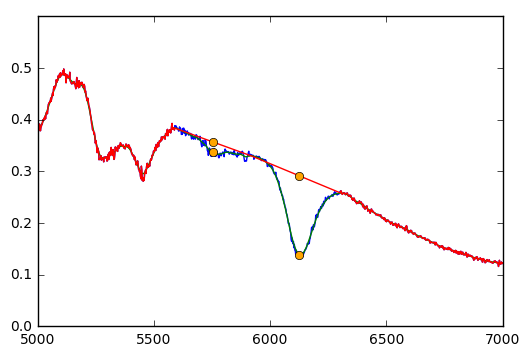

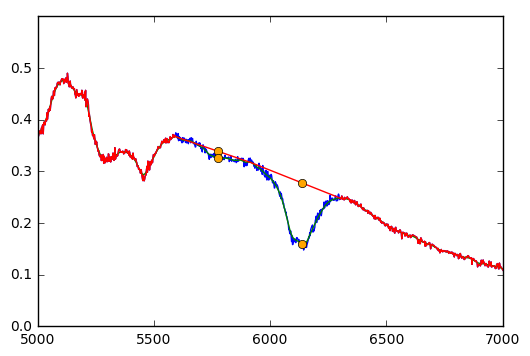

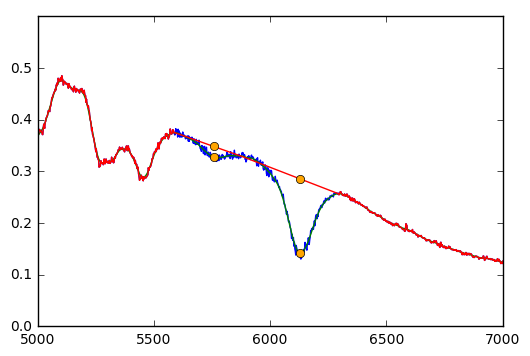

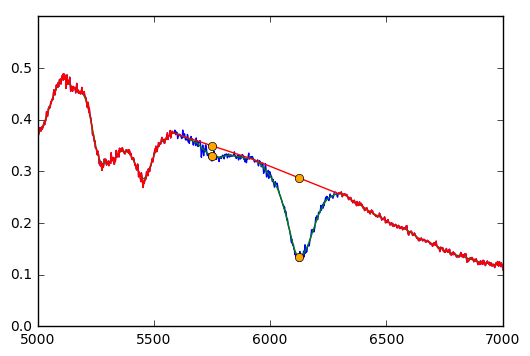

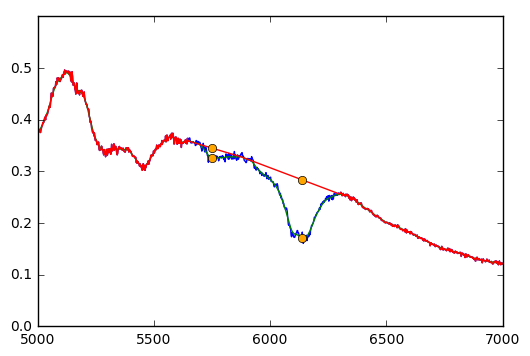

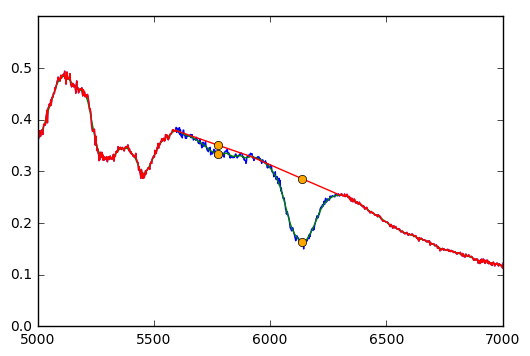

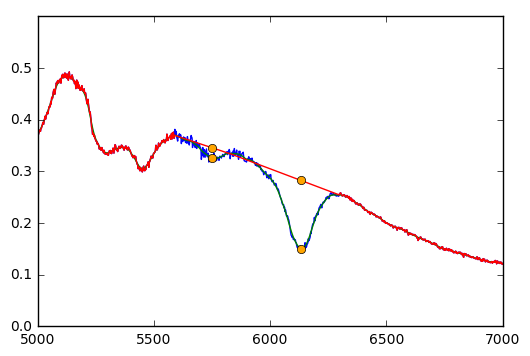

Could not find maximum in a specified range!


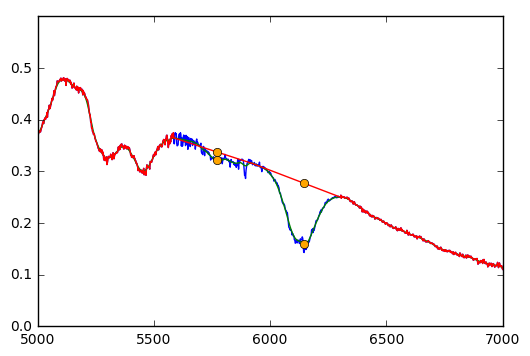

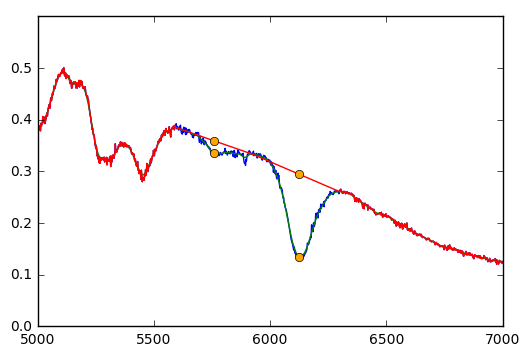

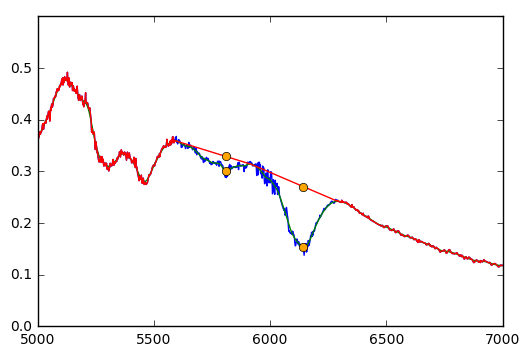

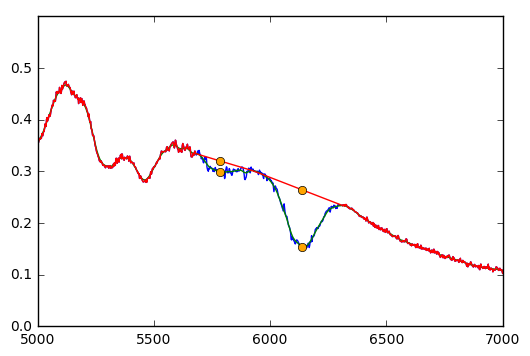

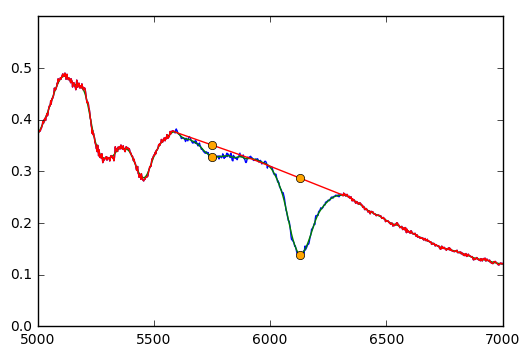

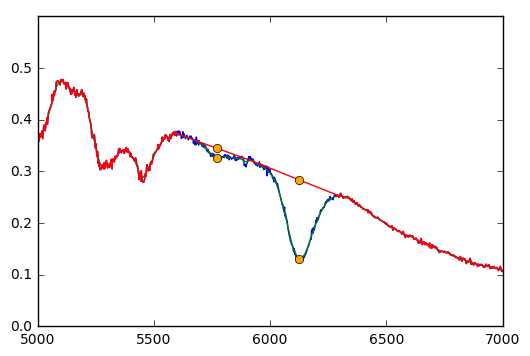

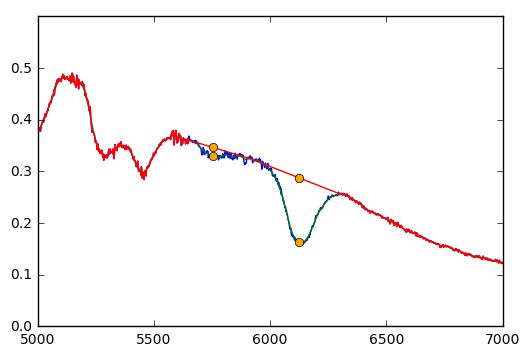

Could not find maximum in a specified range!
Could not find maximum in a specified range!


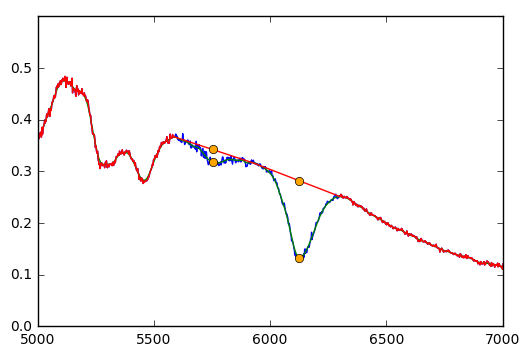

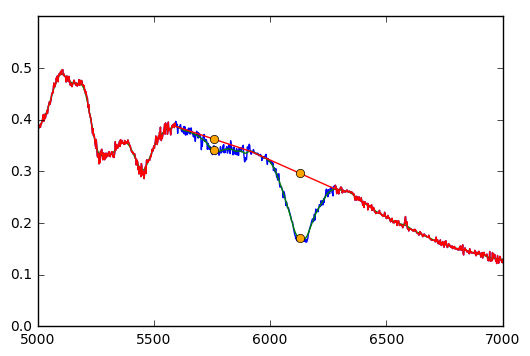

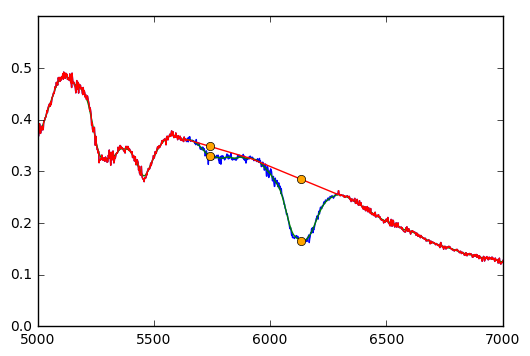

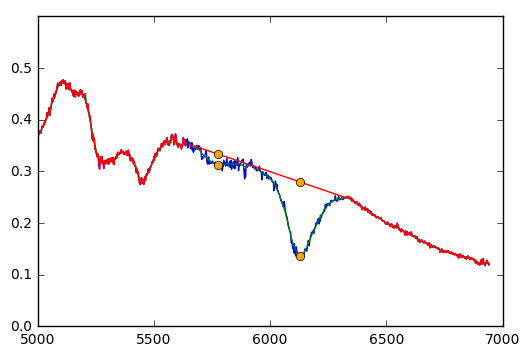

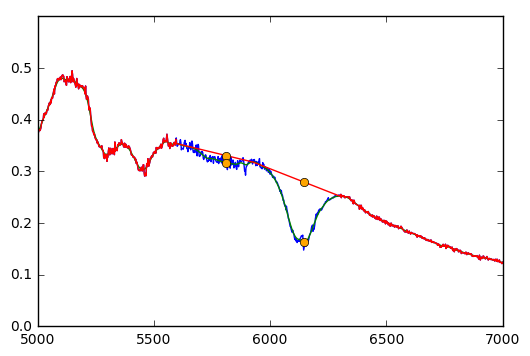

...

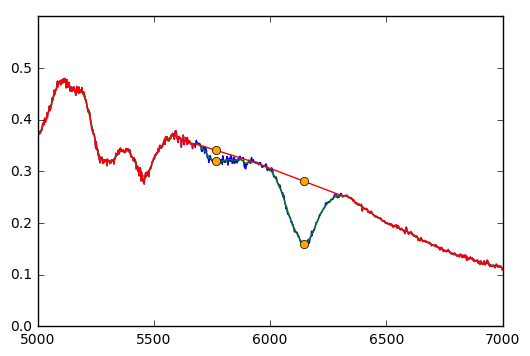

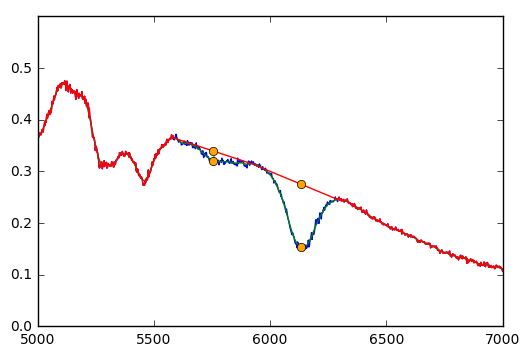

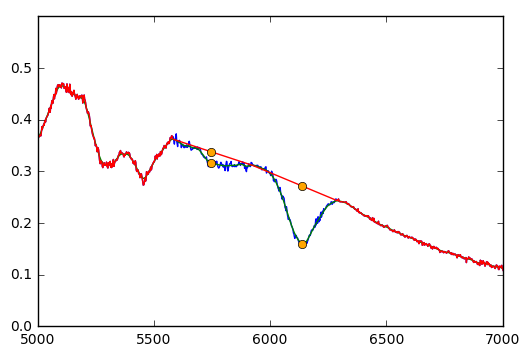

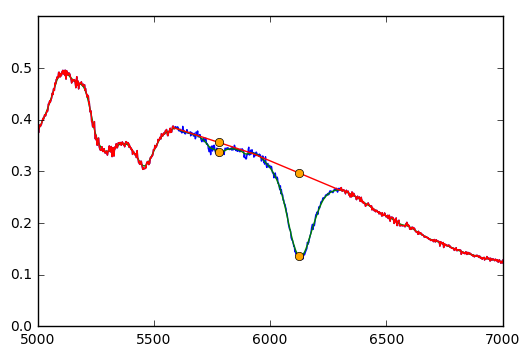

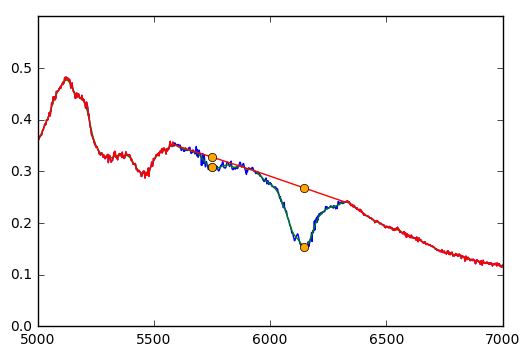

Could not find maximum in a specified range!


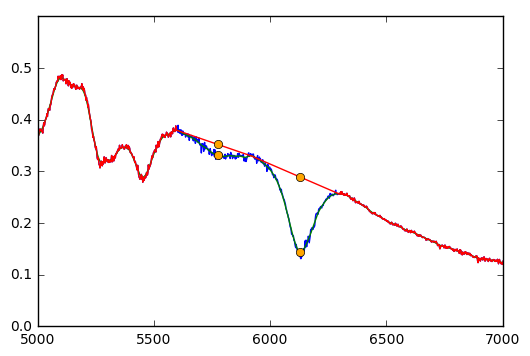

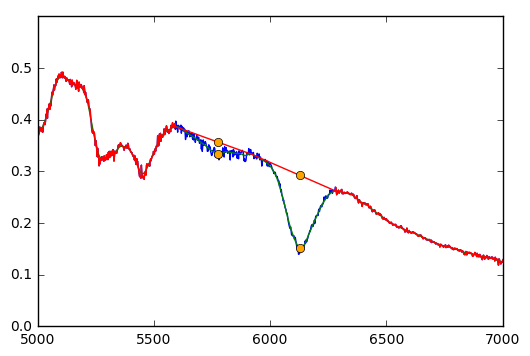

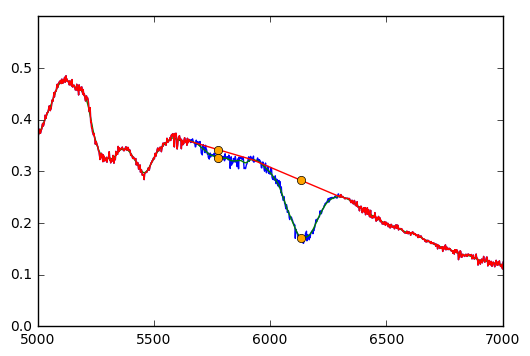

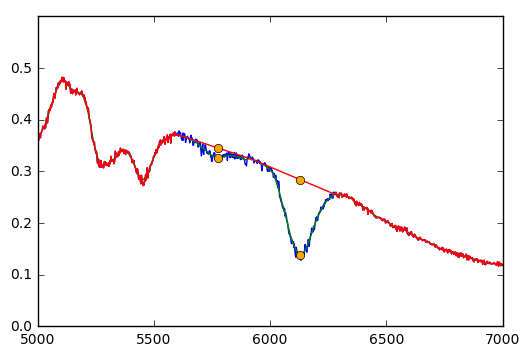

1


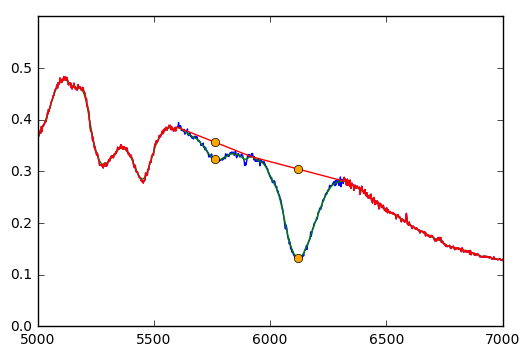

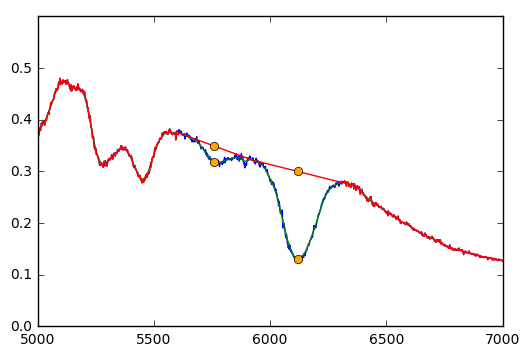

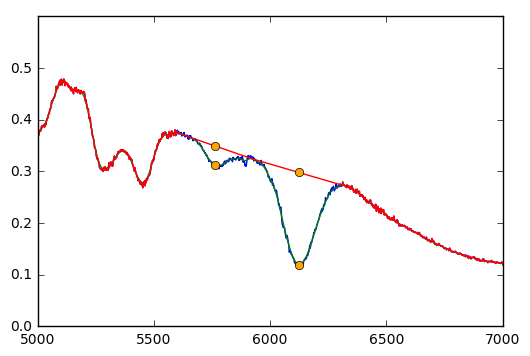

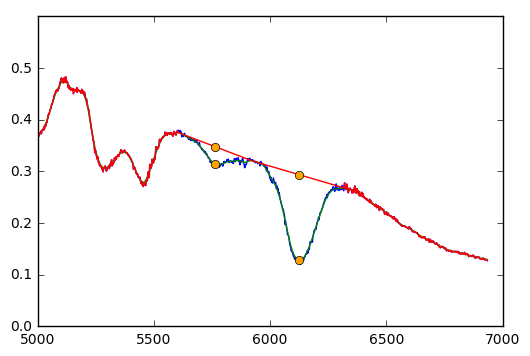

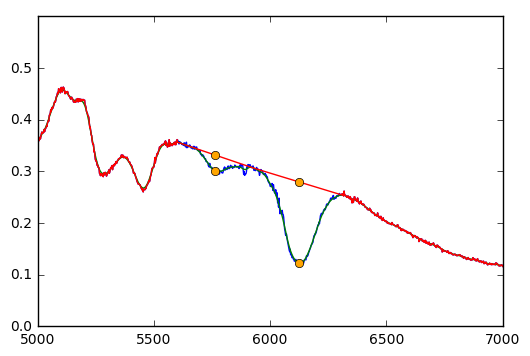

...

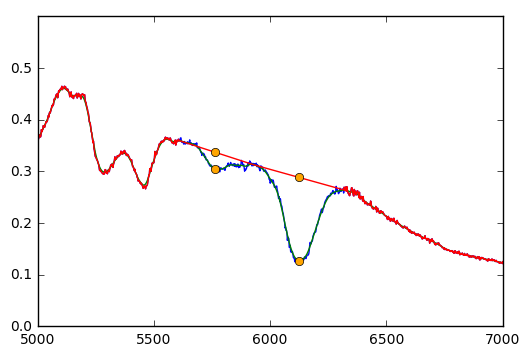

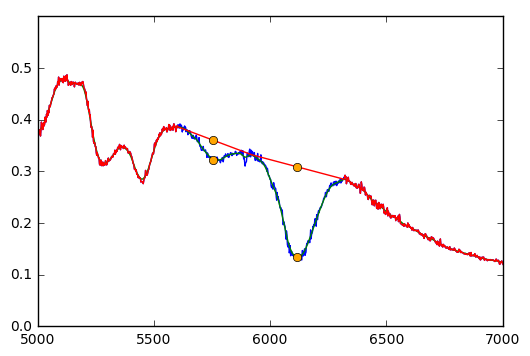

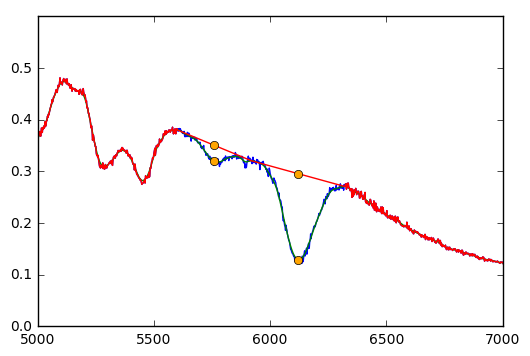

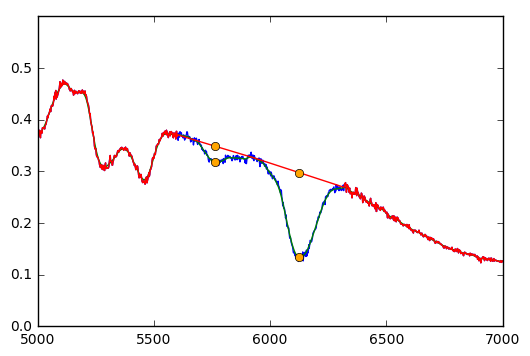

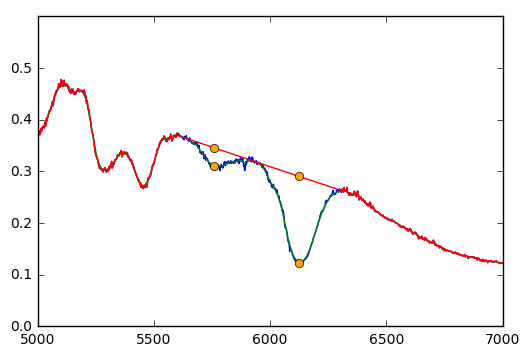

Could not find maximum in a specified range!


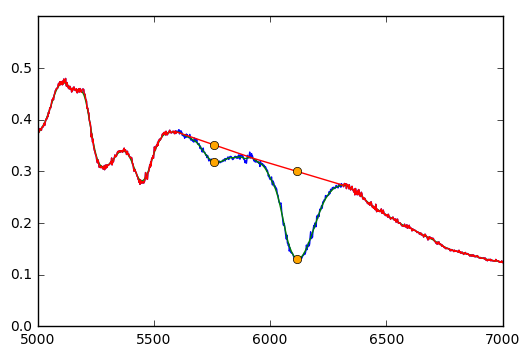

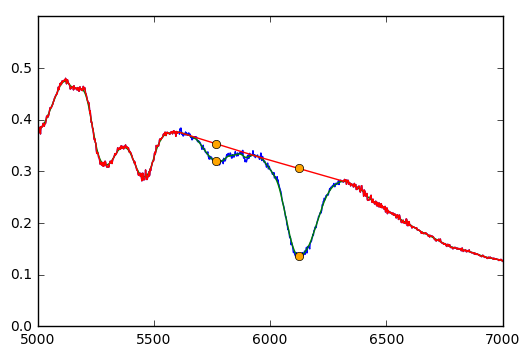

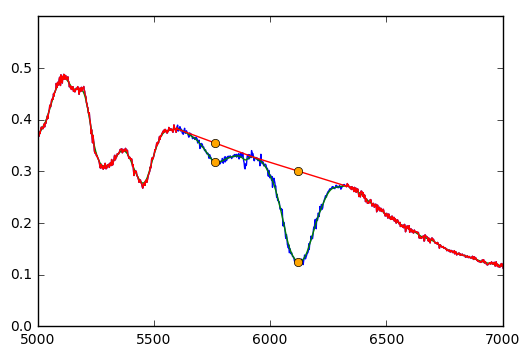

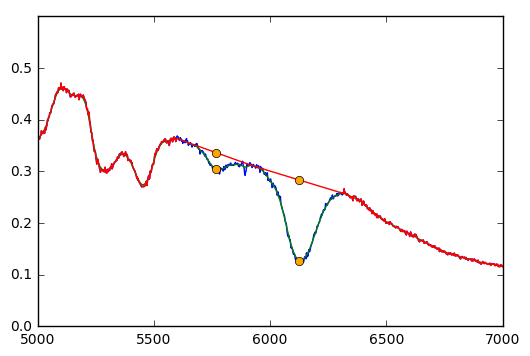

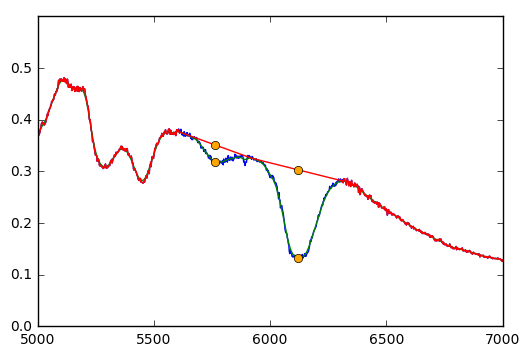

...

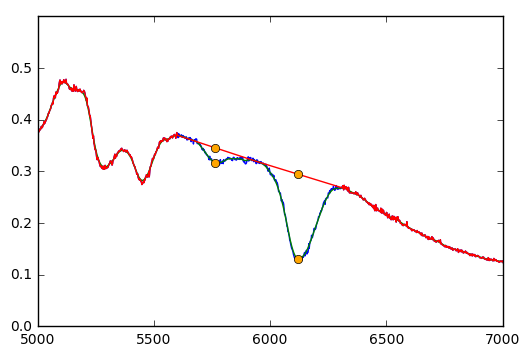

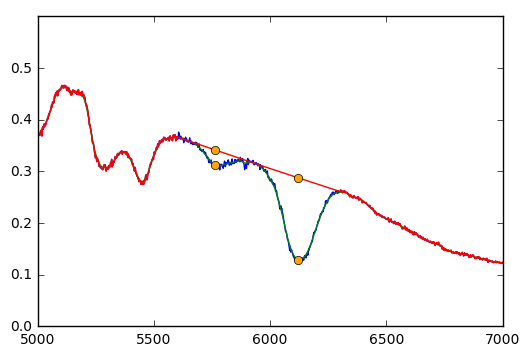

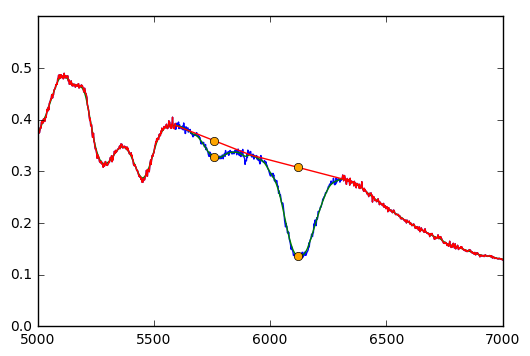

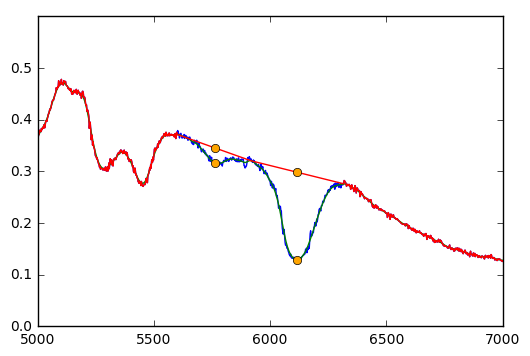

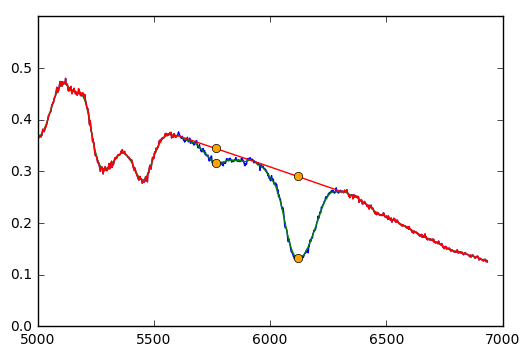

2


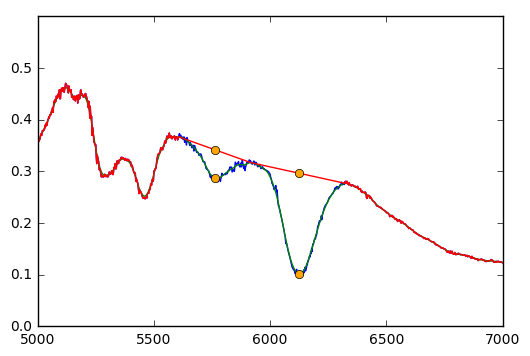

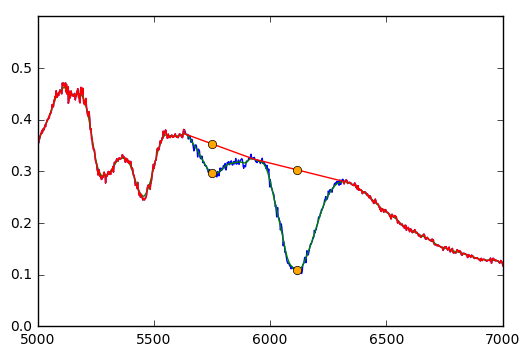

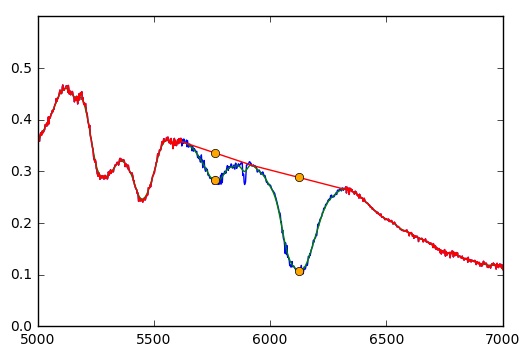

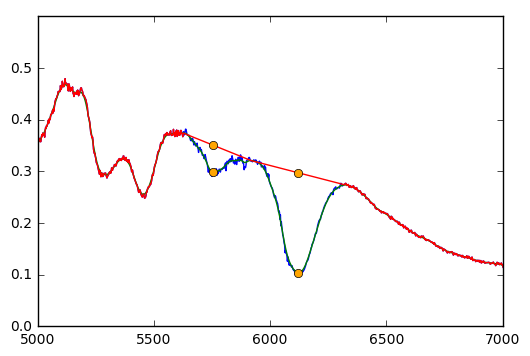

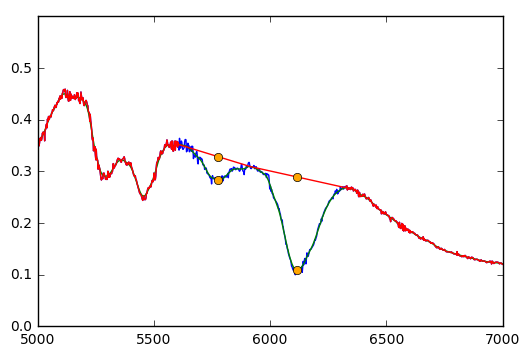

...

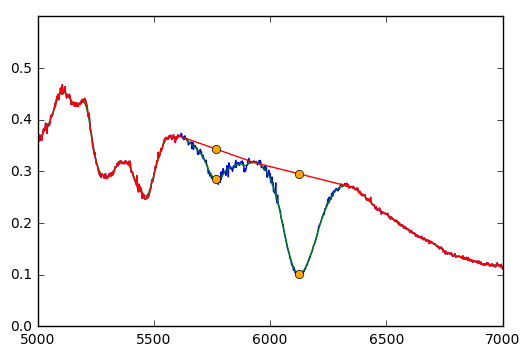

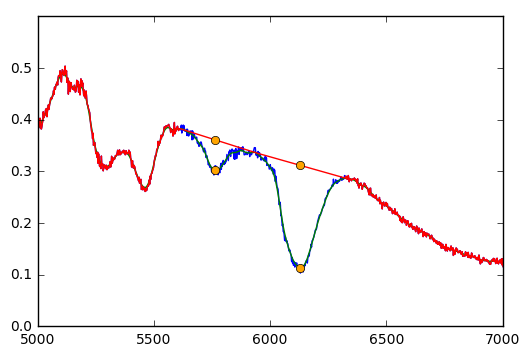

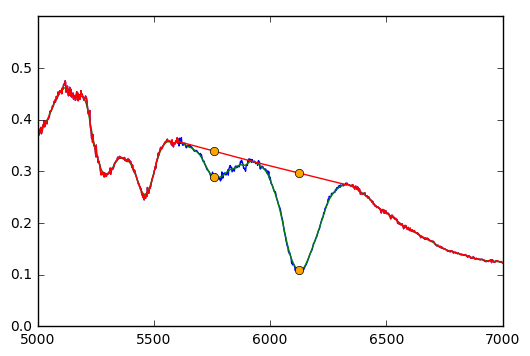

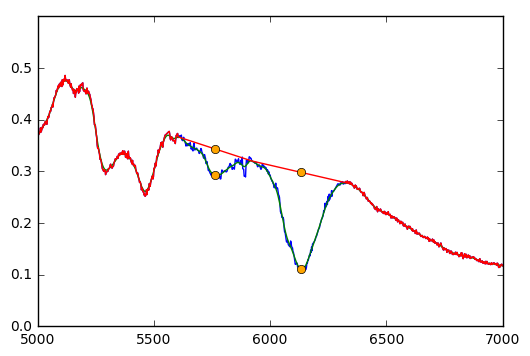

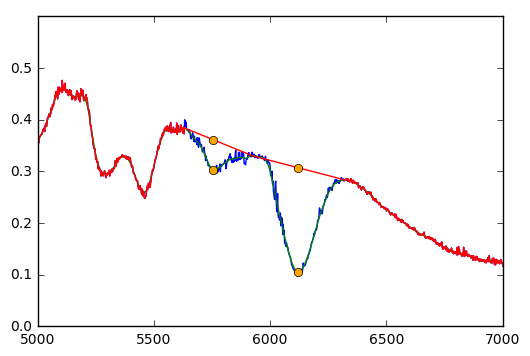

3


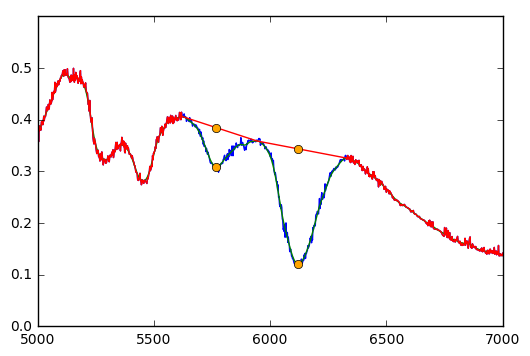

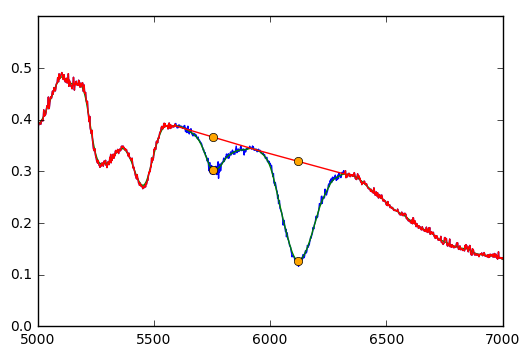

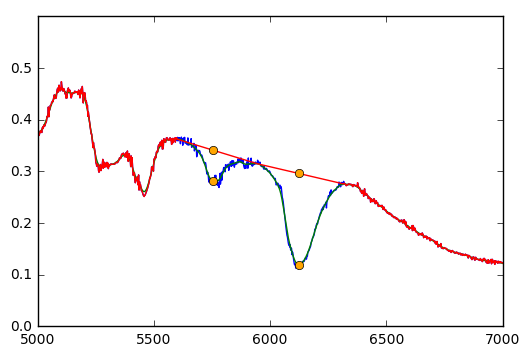

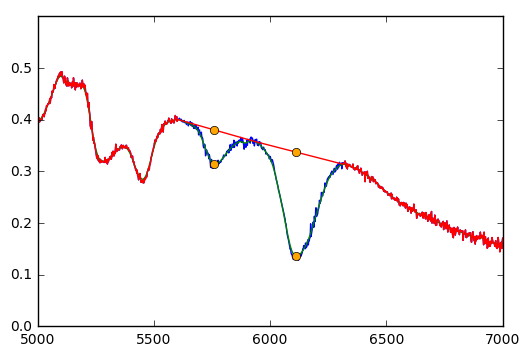

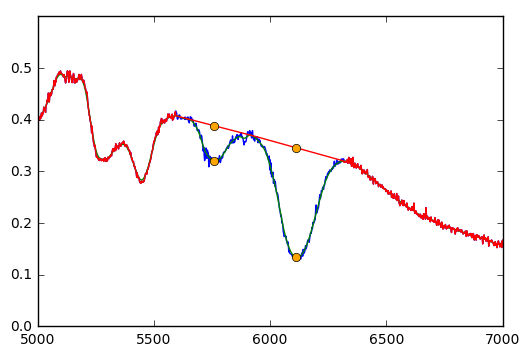

...

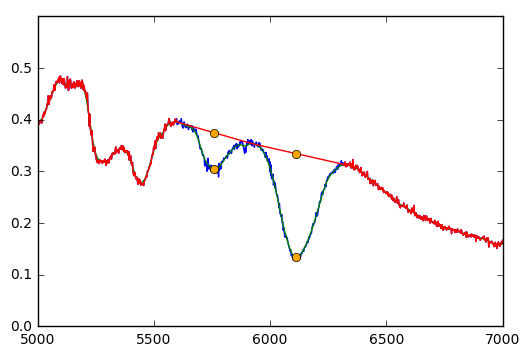

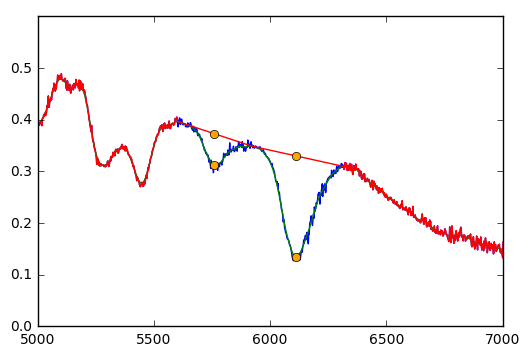

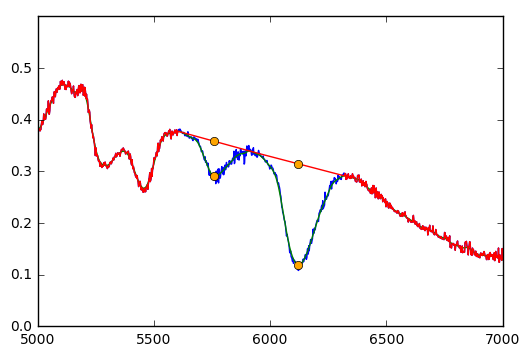

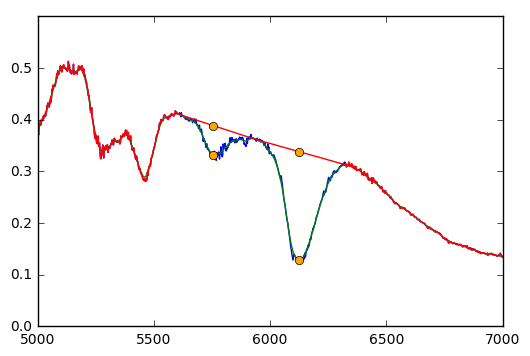

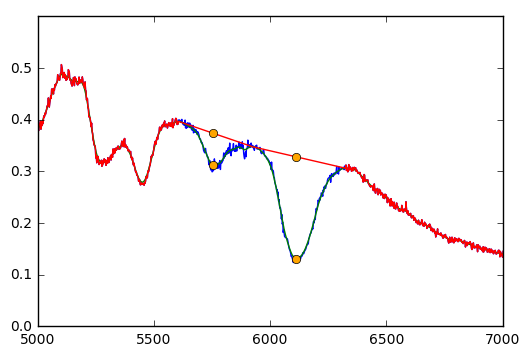

Could not find maximum in a specified range!


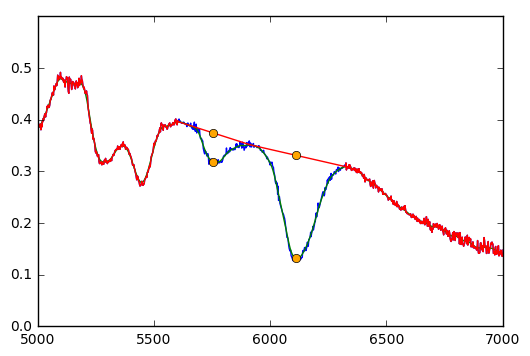

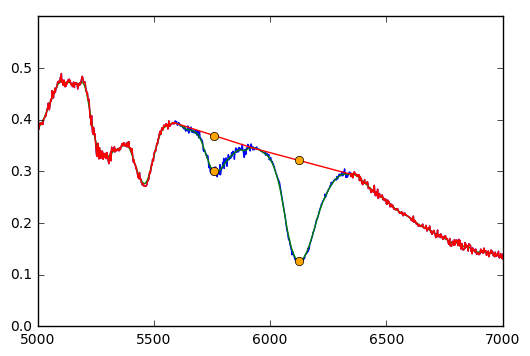

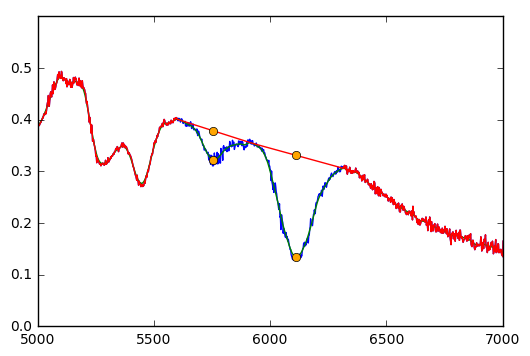

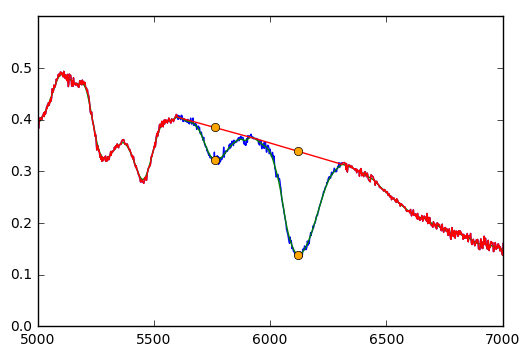

Could not find maximum in a specified range!


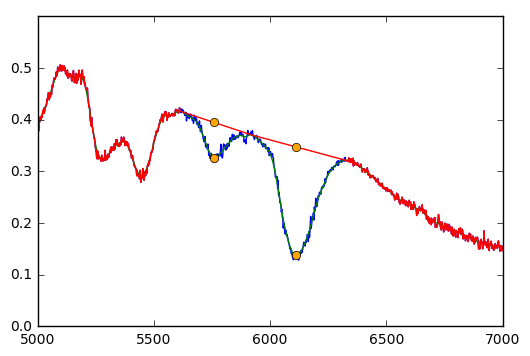

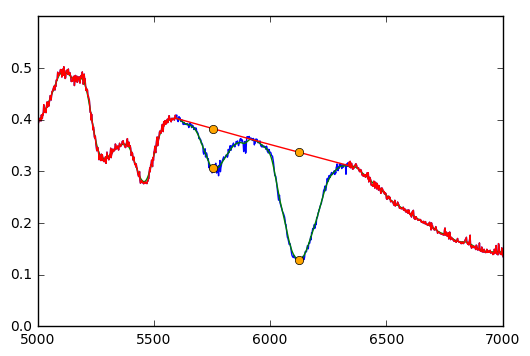

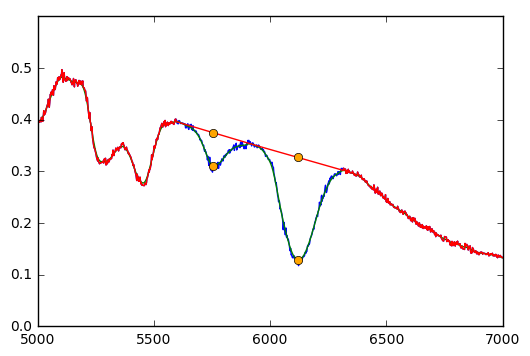

Could not find maximum in a specified range!


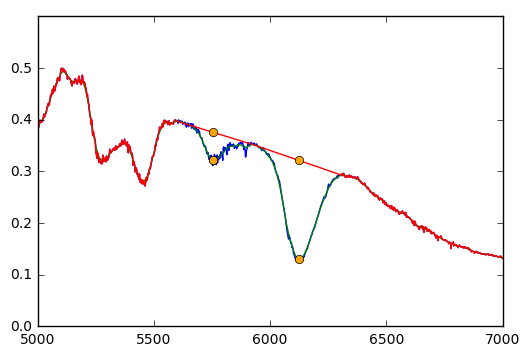

Could not find maximum in a specified range!


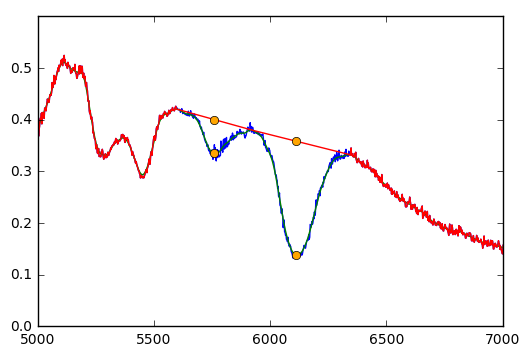

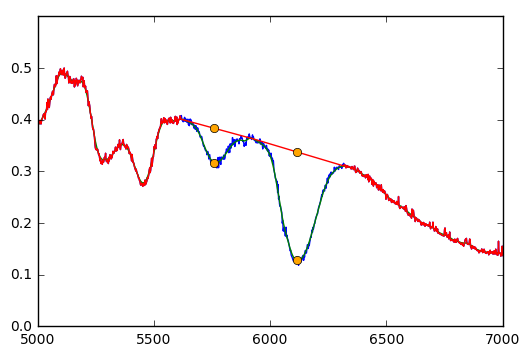

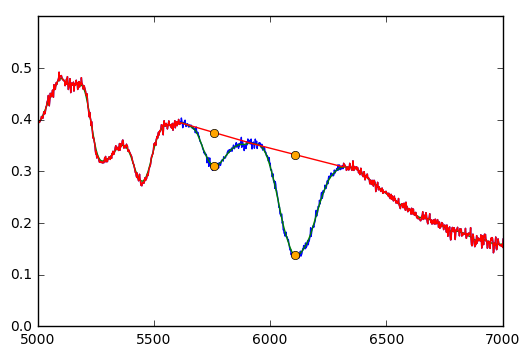

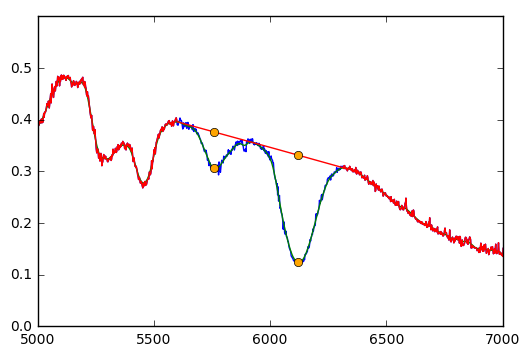

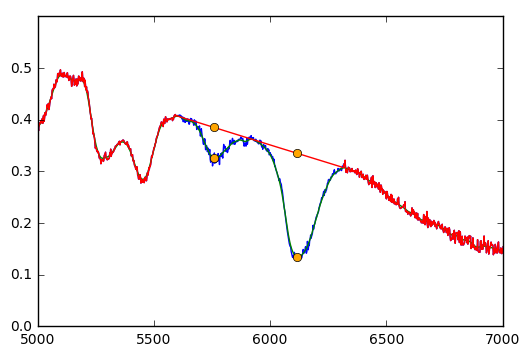

...

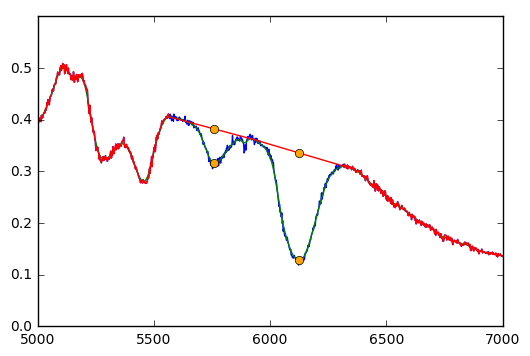

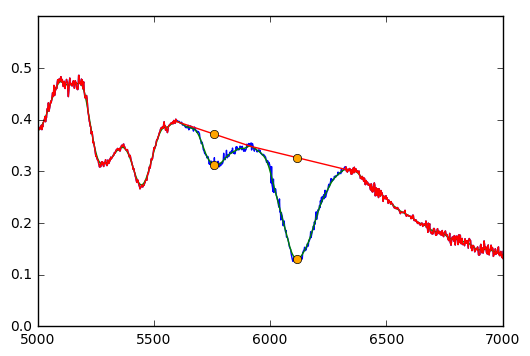

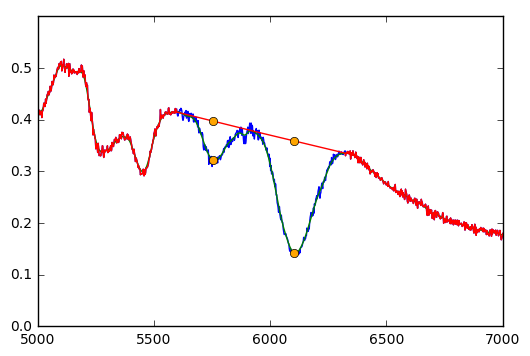

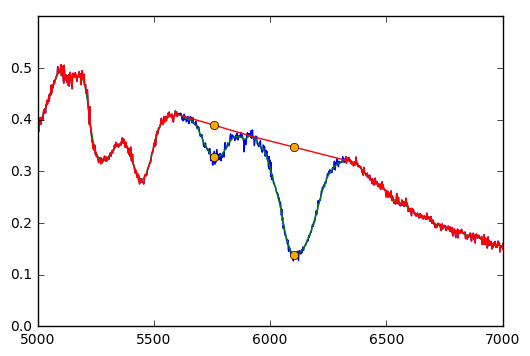

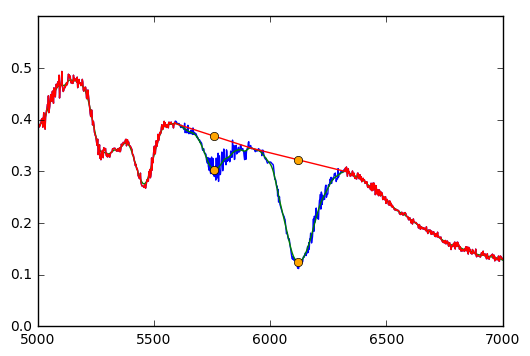

Could not find maximum in a specified range!


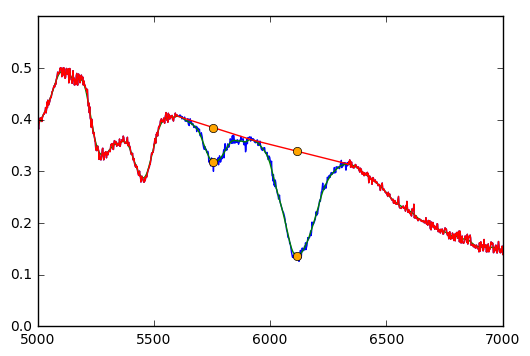

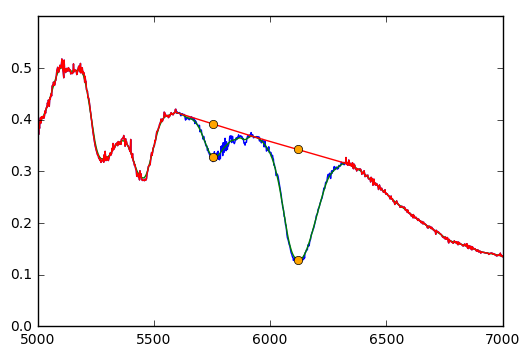

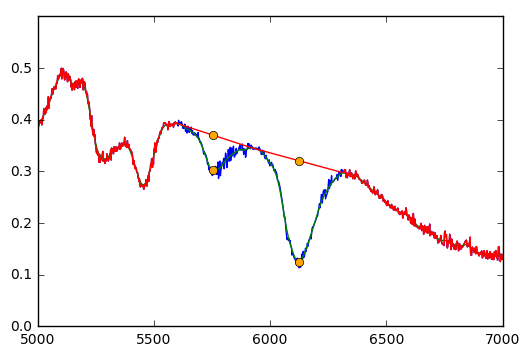

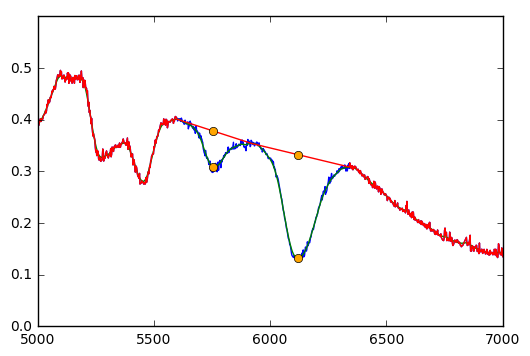

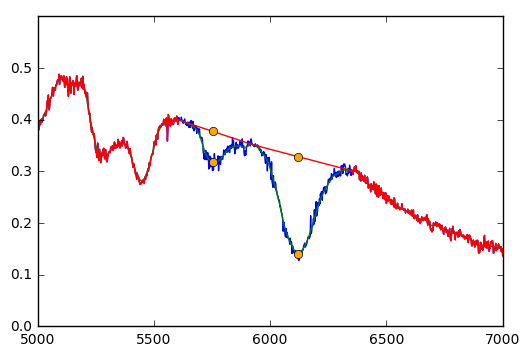

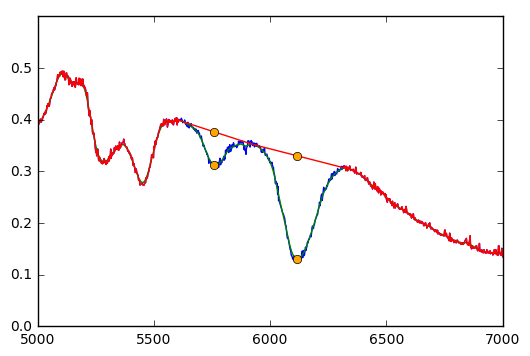

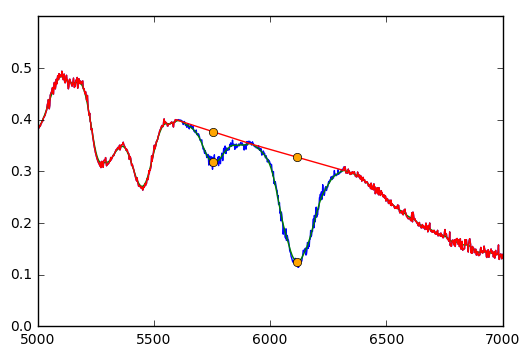

Could not find maximum in a specified range!


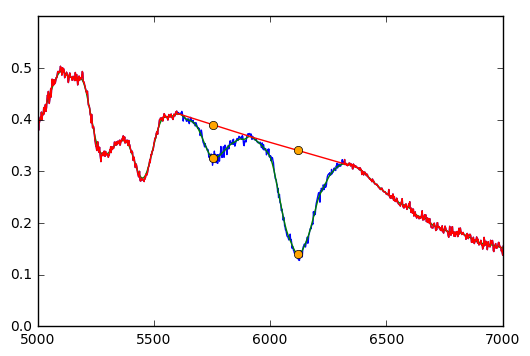

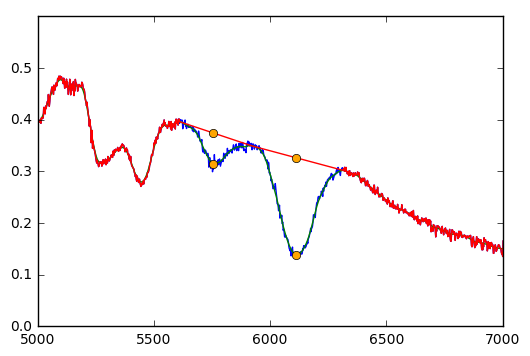

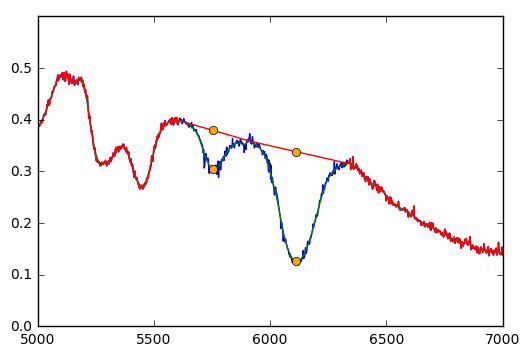

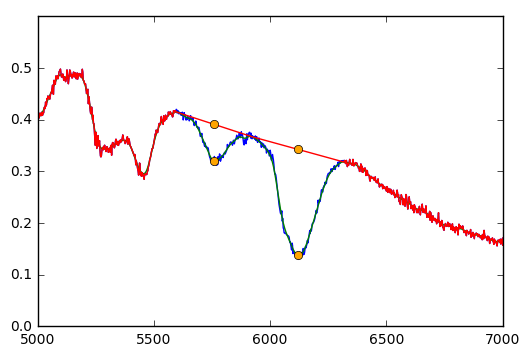

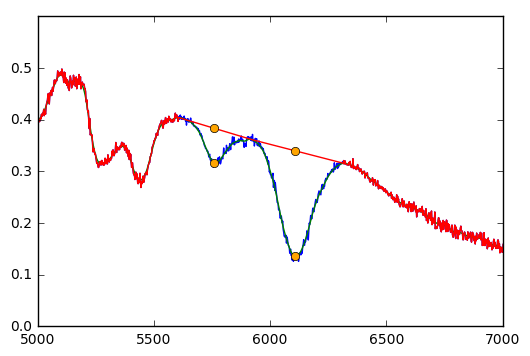

...

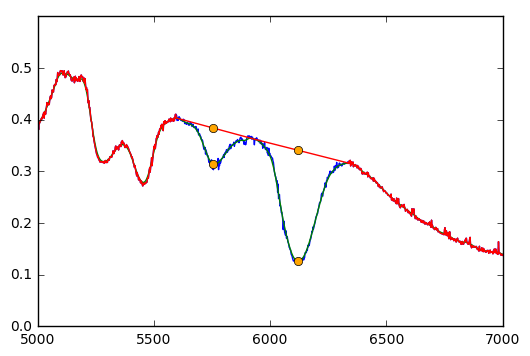

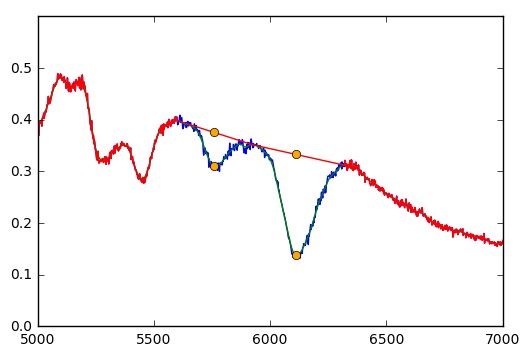

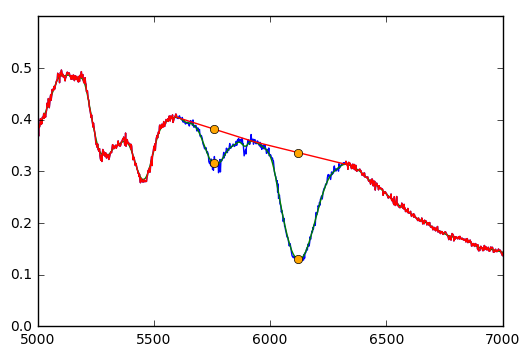

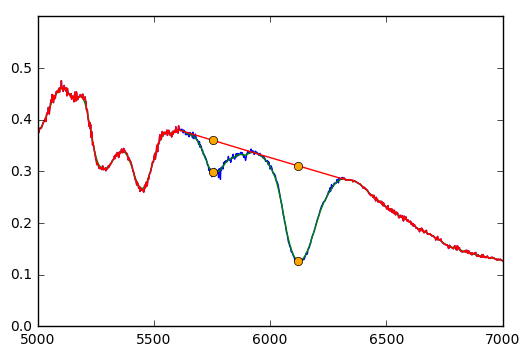

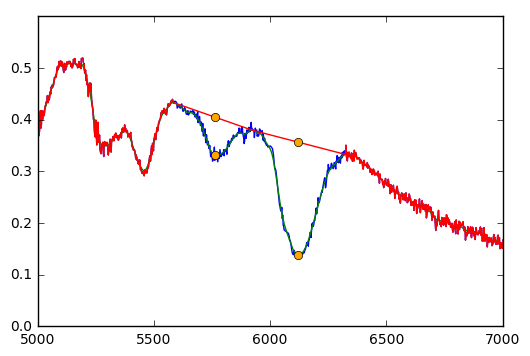

4


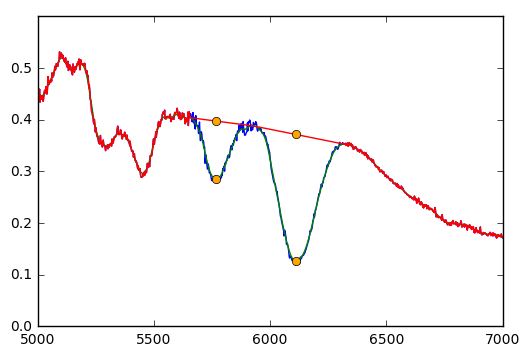

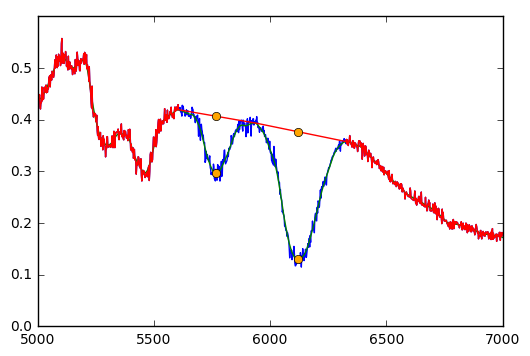

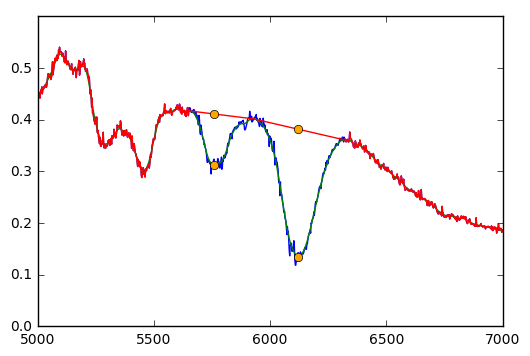

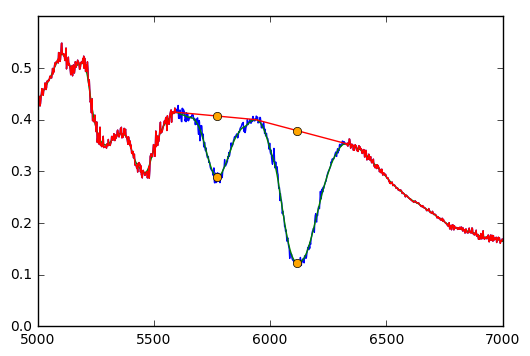

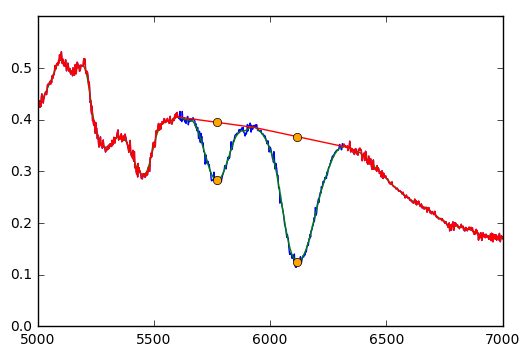

...

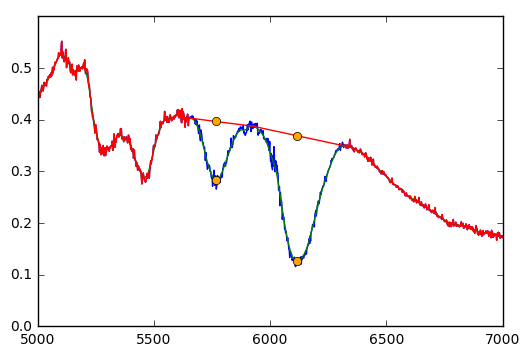

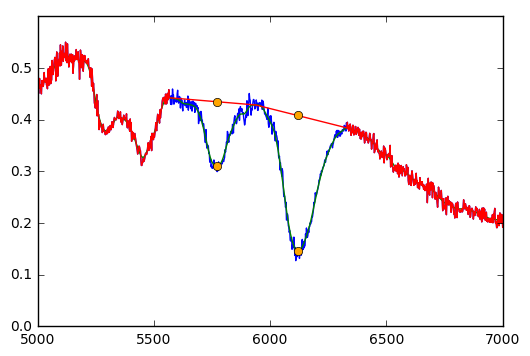

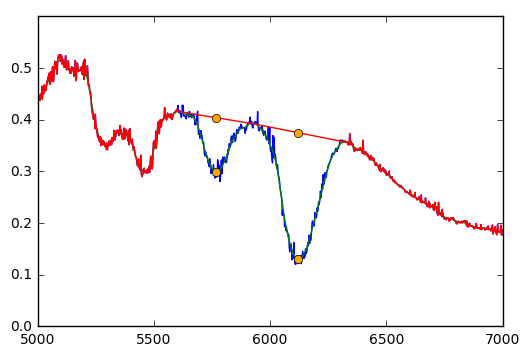

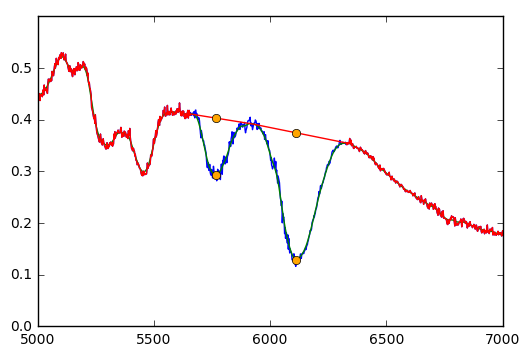

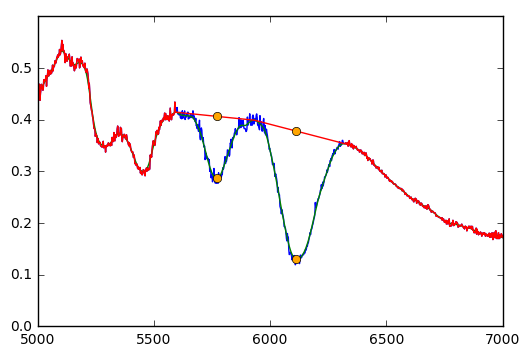

5


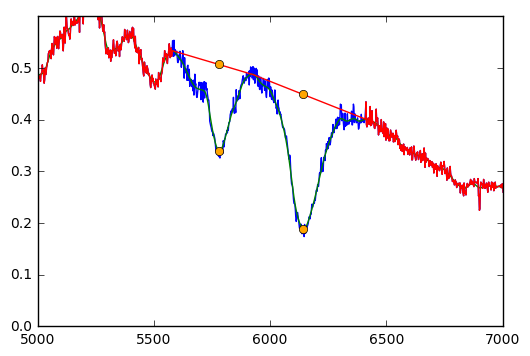

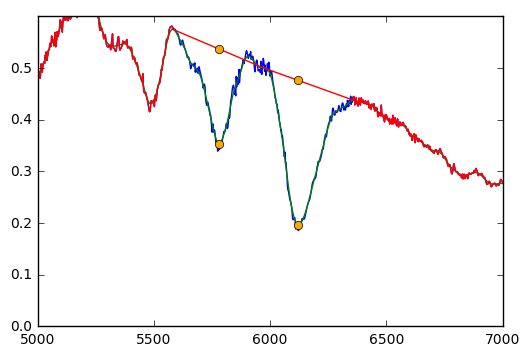

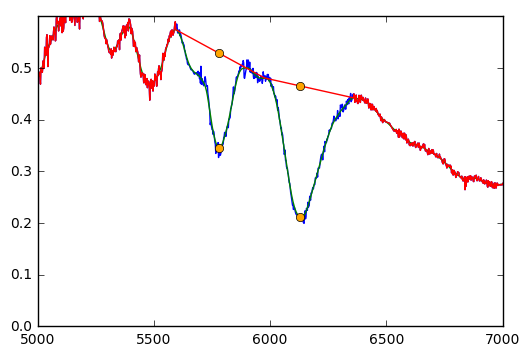

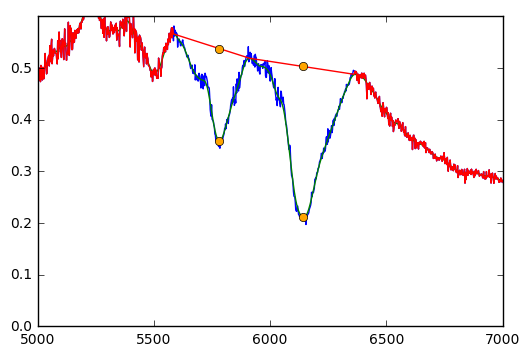

Could not find maximum in a specified range!


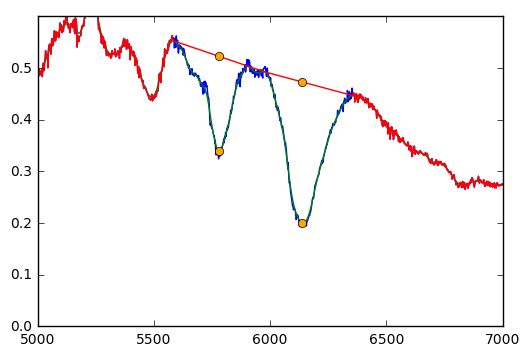

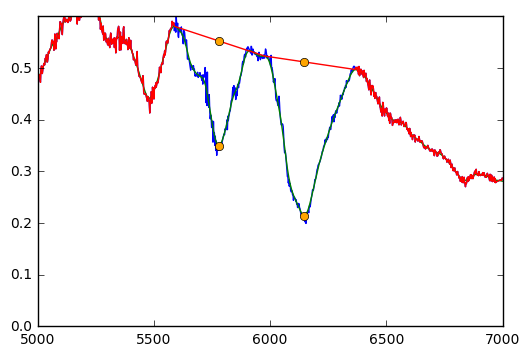

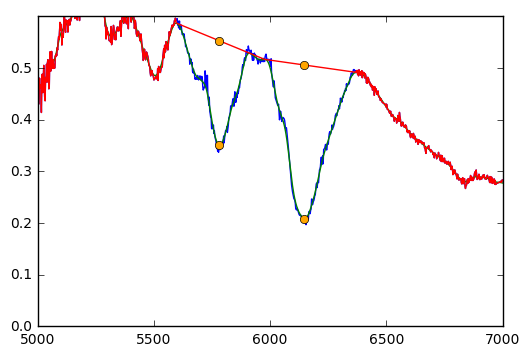

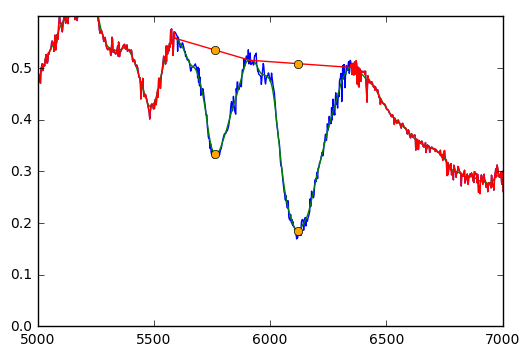

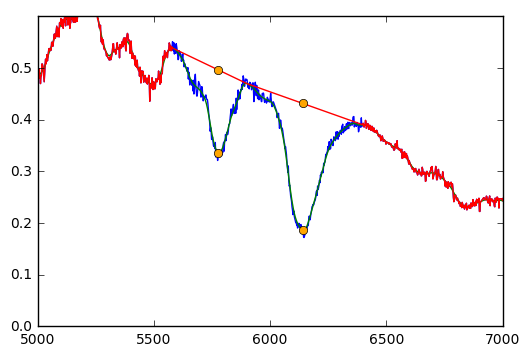

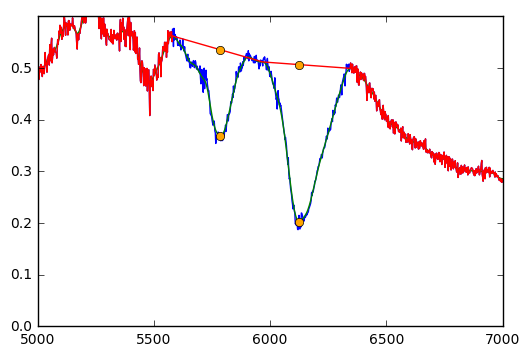

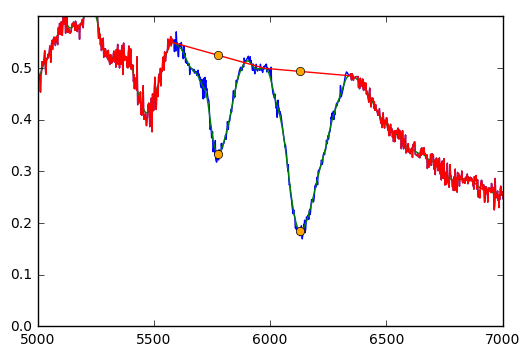

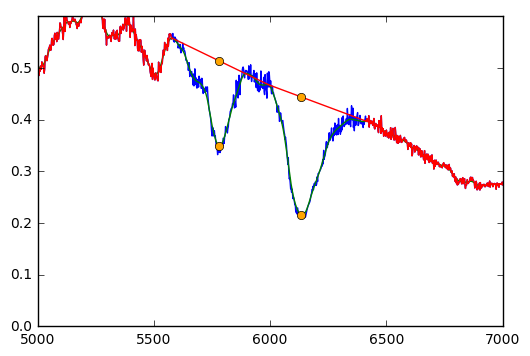

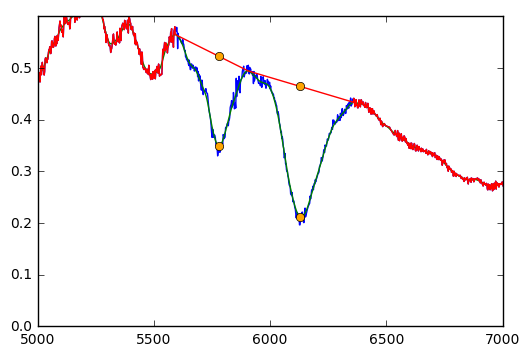

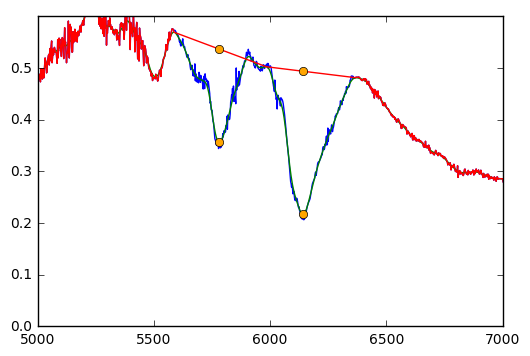

Could not find maximum in a specified range!


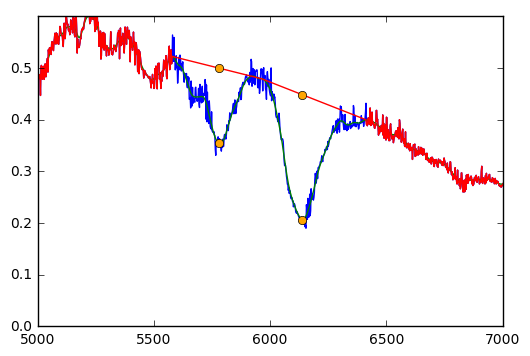

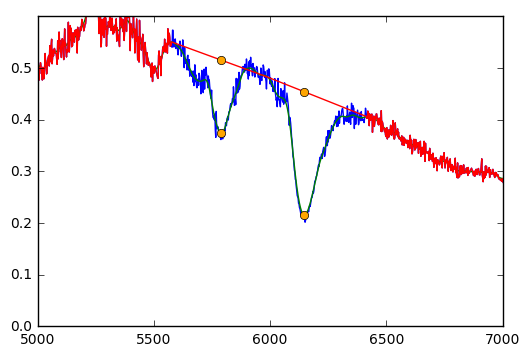

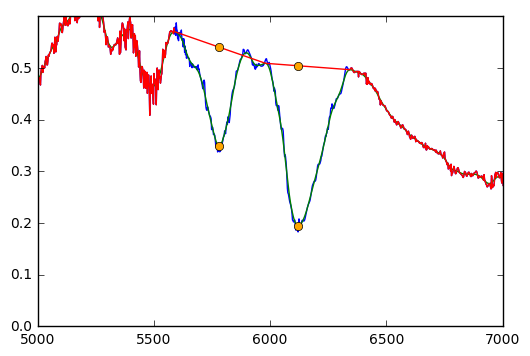

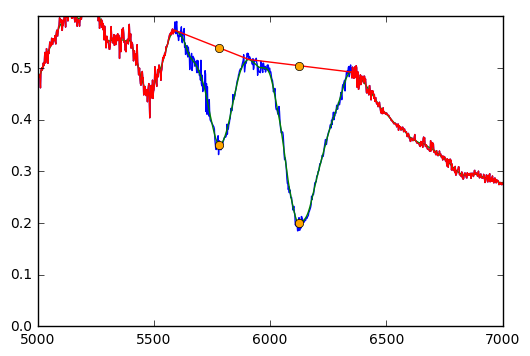

Could not find maximum in a specified range!
Could not find maximum in a specified range!


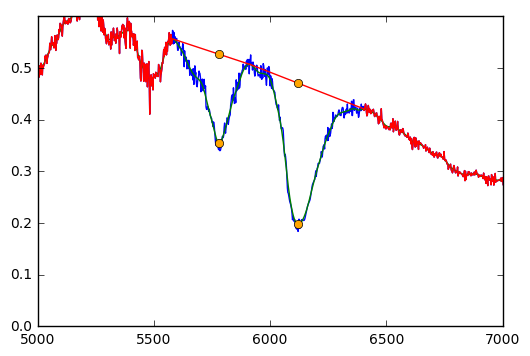

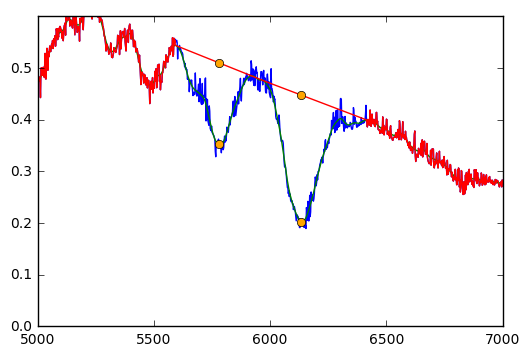

Could not find maximum in a specified range!


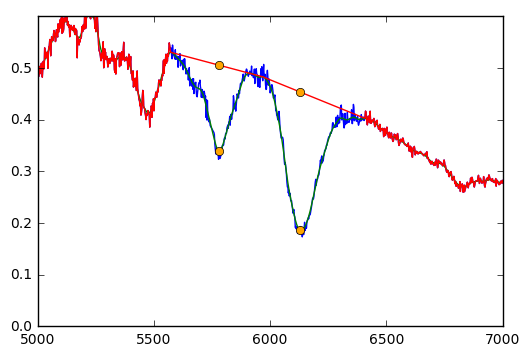

Could not find maximum in a specified range!


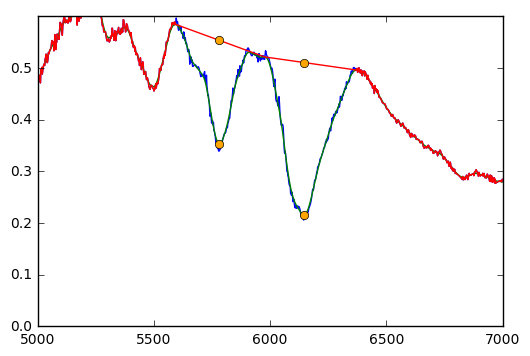

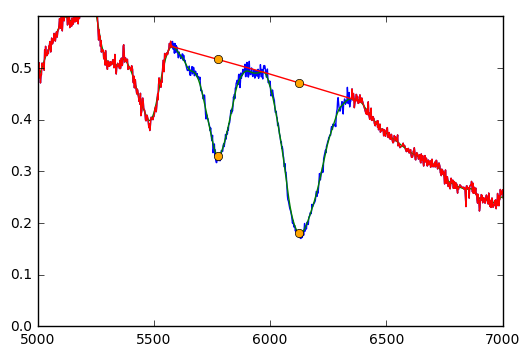

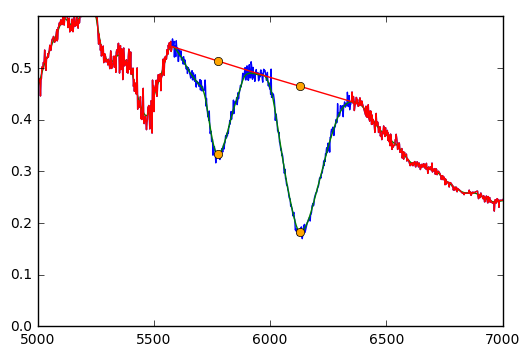

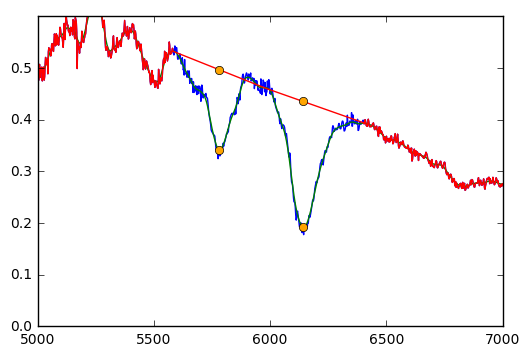

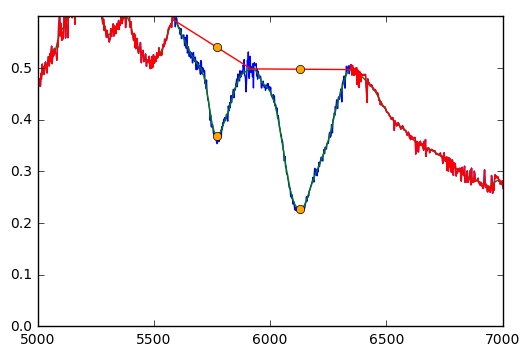

...

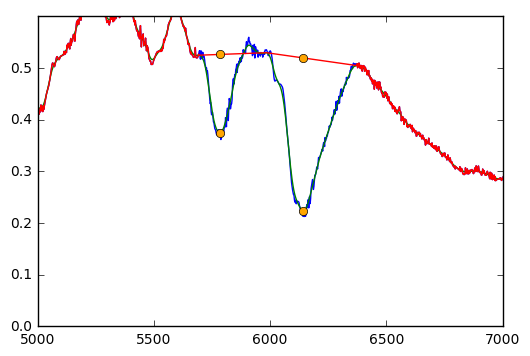

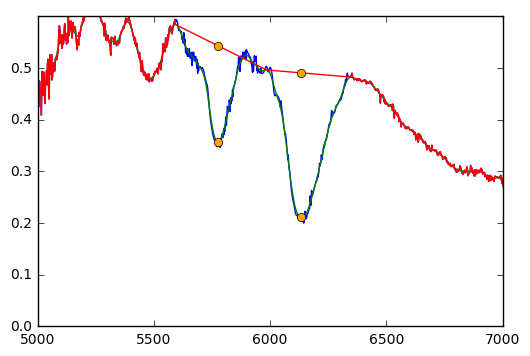

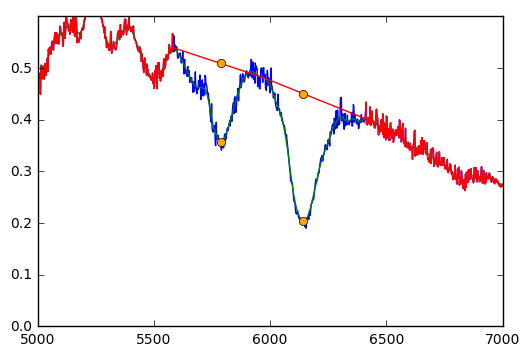

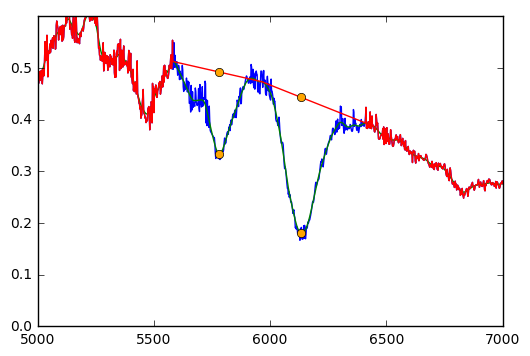

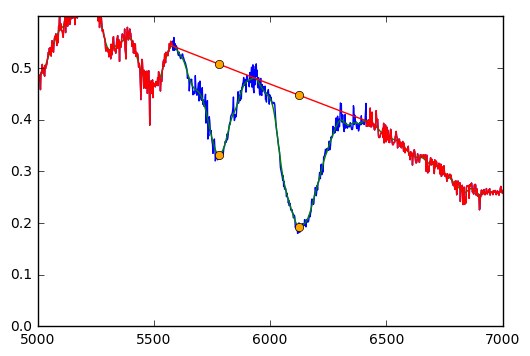

Could not find maximum in a specified range!


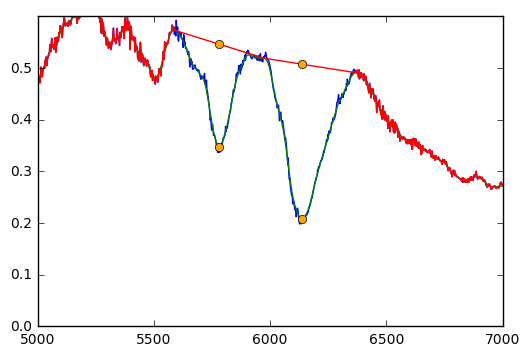

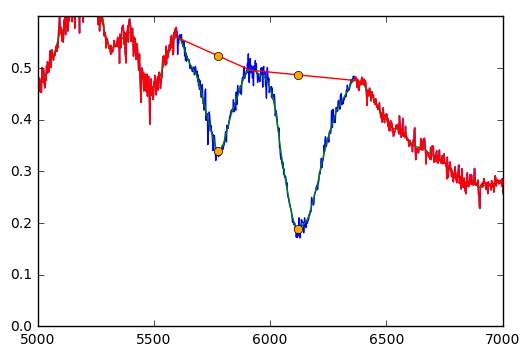

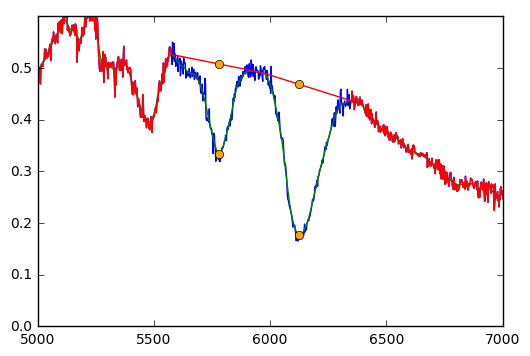

Could not find maximum in a specified range!


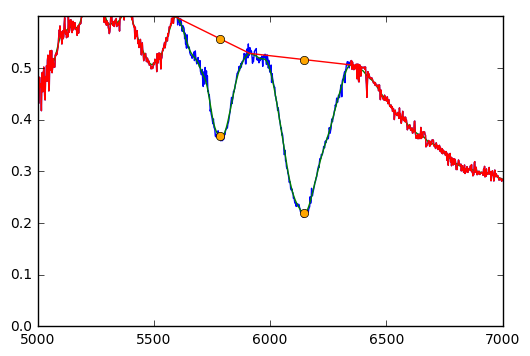

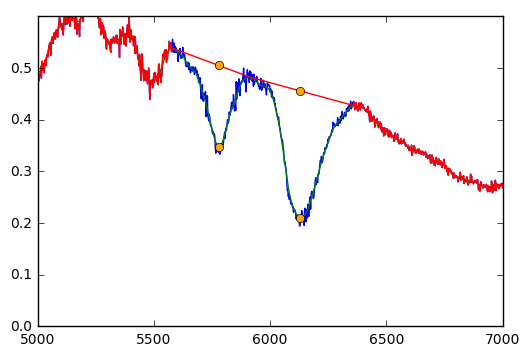

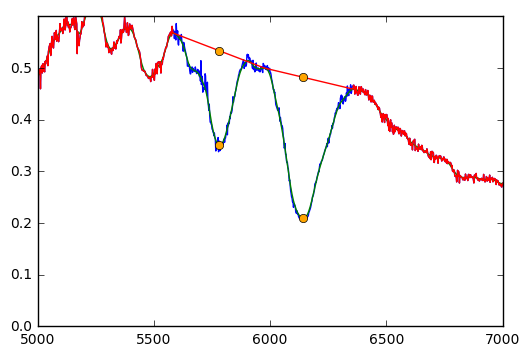

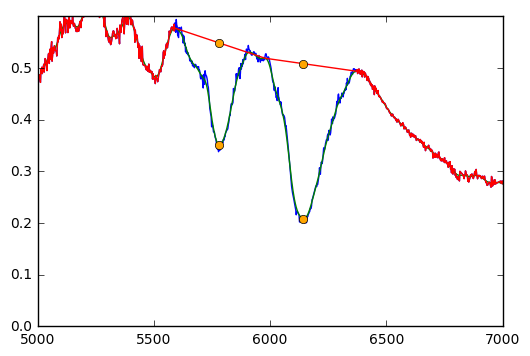

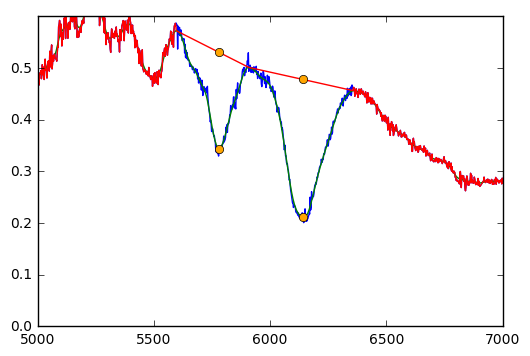

Could not find maximum in a specified range!


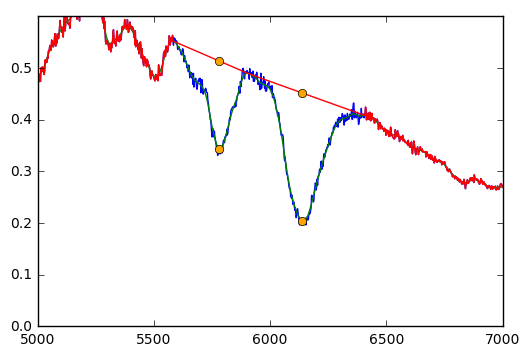

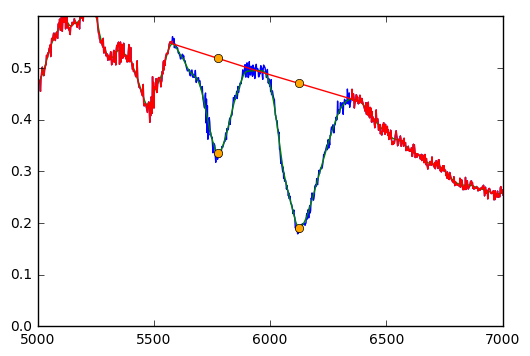

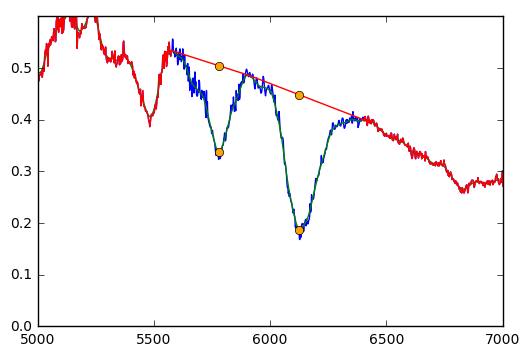

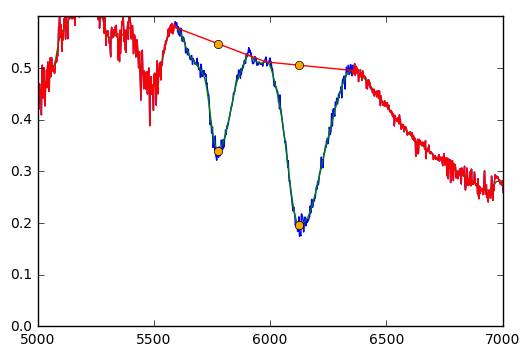

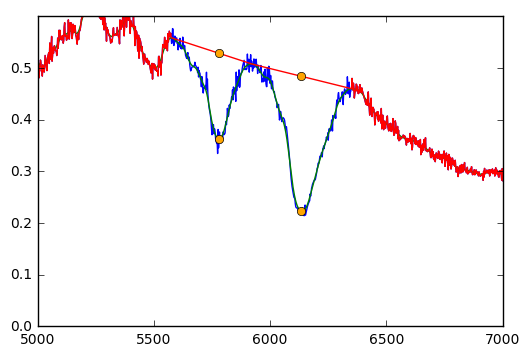

...

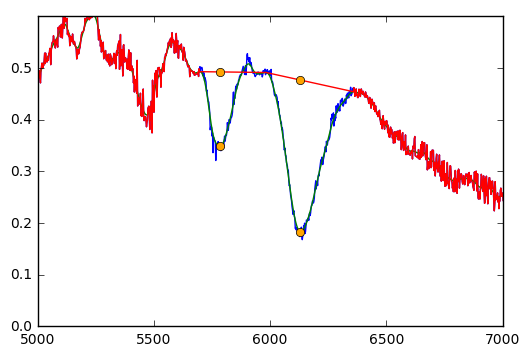

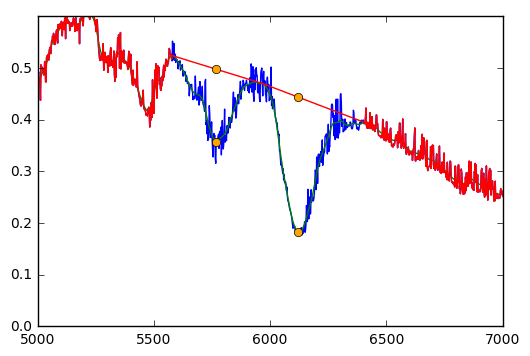

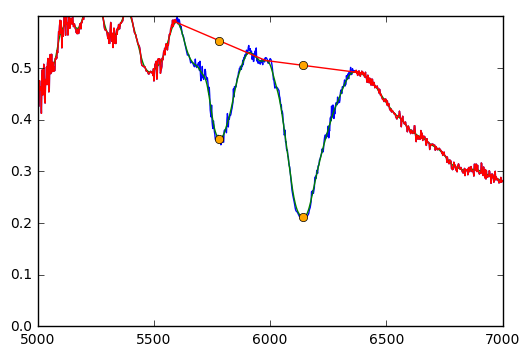

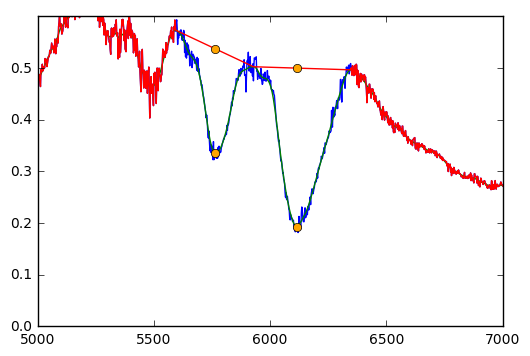

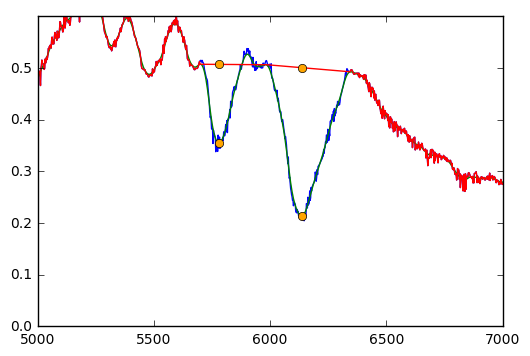

Could not find maximum in a specified range!


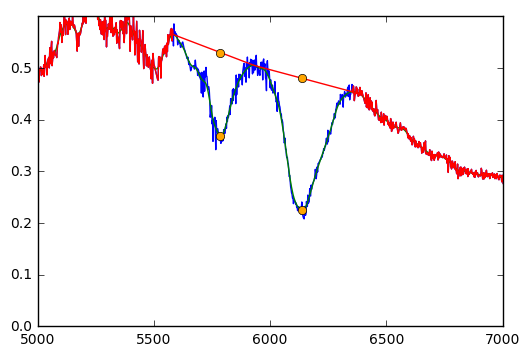

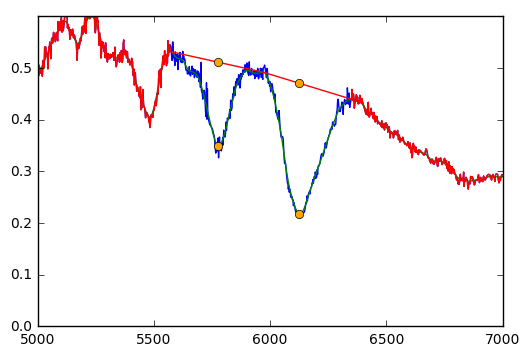

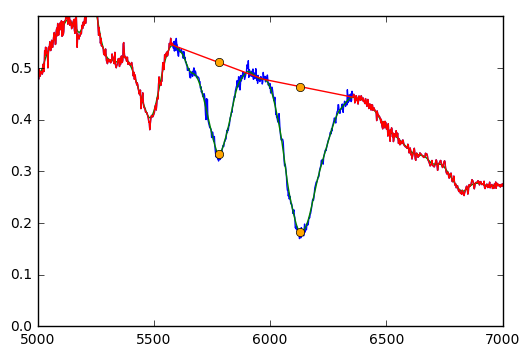

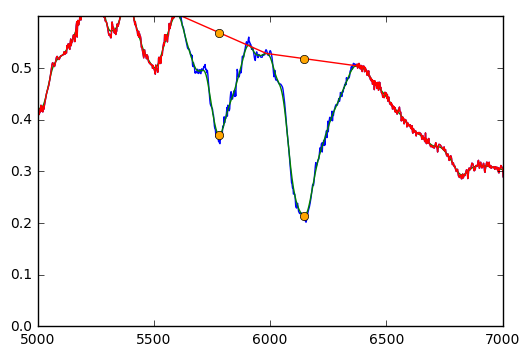

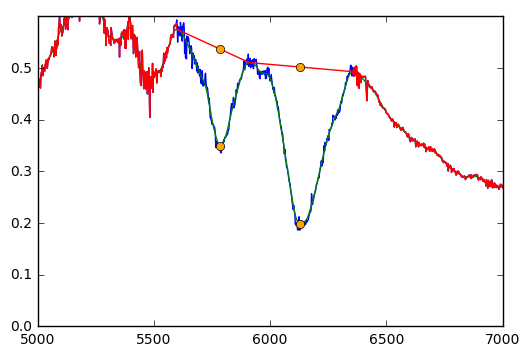

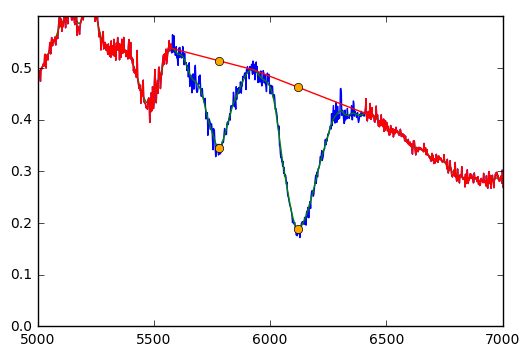

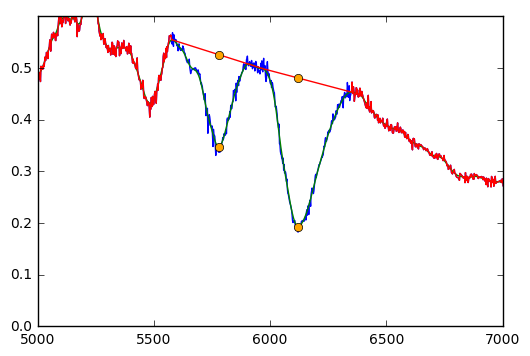

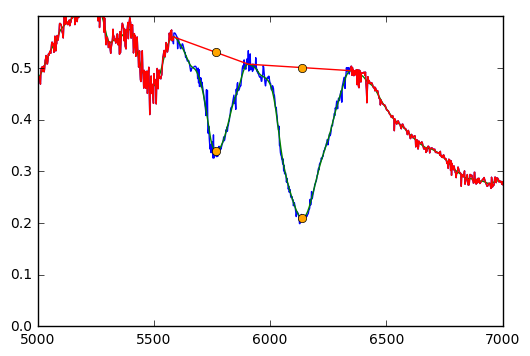

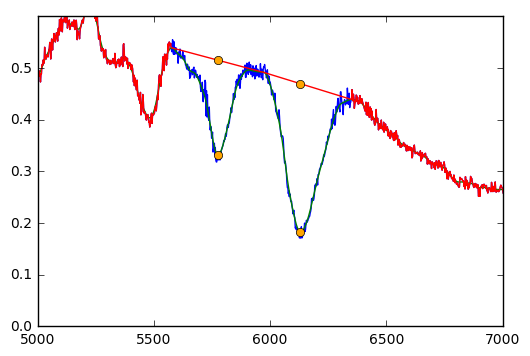

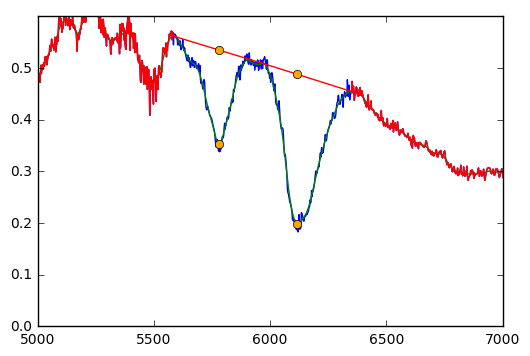

Could not find maximum in a specified range!


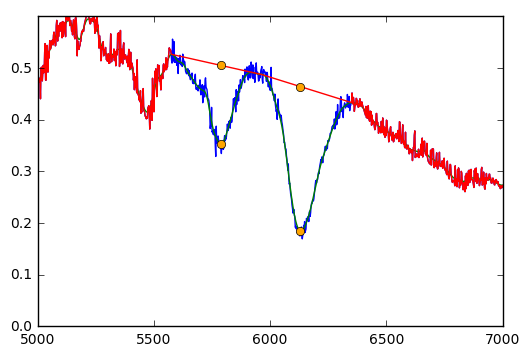

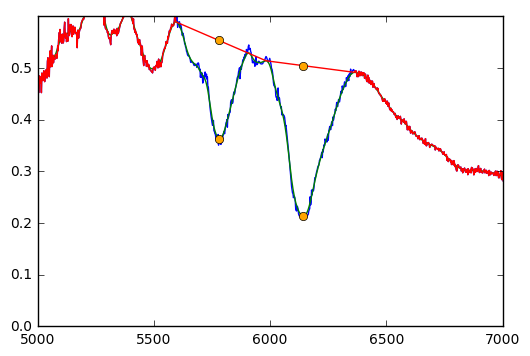

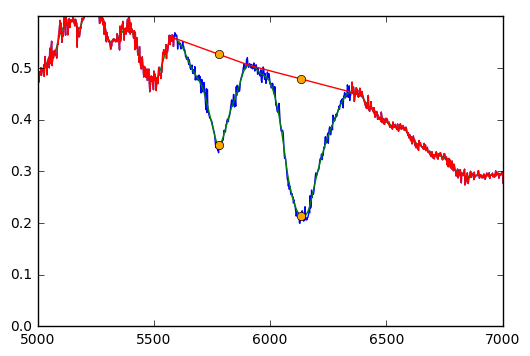

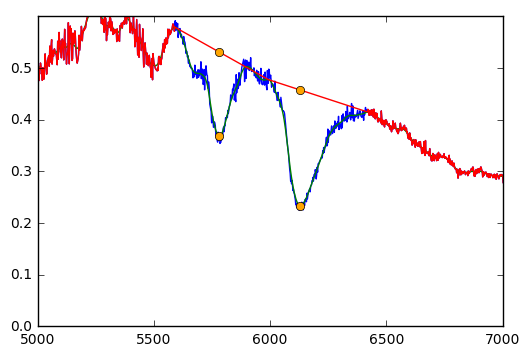

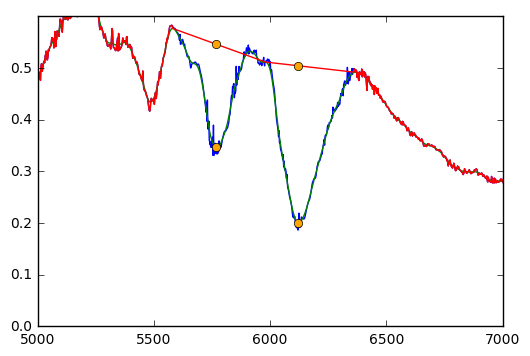

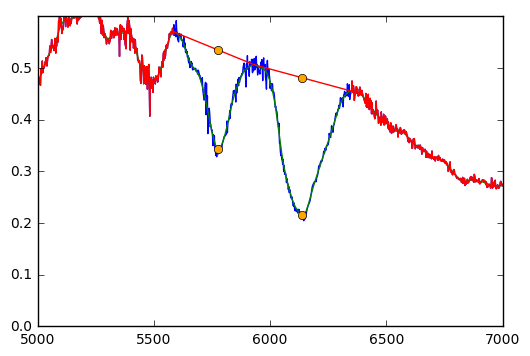

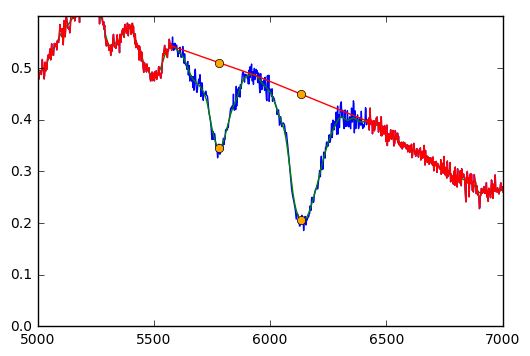

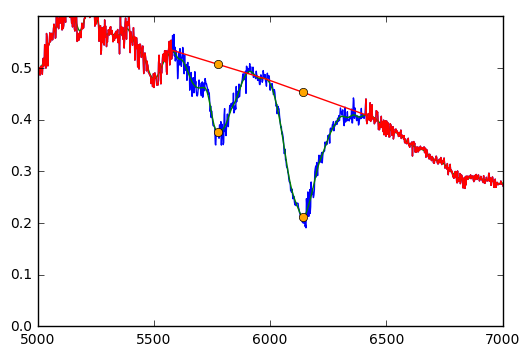

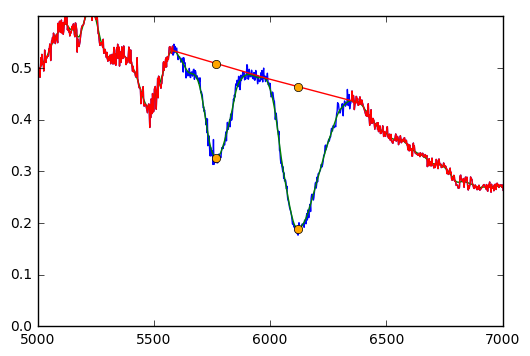

In [9]:
boot_ratios_med = []
errors_med  = []
percentile = erf(1/np.sqrt(2.))
low_pc = 0.5 - percentile*0.5
up_pc = 0.5 + percentile*0.5
# for k in range(len(boot_sn_arrays[0:27])):
for k in range(len(boot_sn_arrays_med)):
    rs = []
    print k
    for comp in boot_sn_arrays_med[k]:
        r = sa.measure_si_ratio(comp.wavelength[comp.x1:comp.x2], comp.flux[comp.x1:comp.x2], vexp=.002)
        rs.append(r)
    boot_ratios_med.append(rs)

0


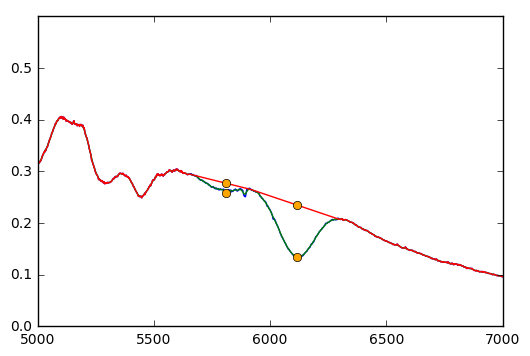

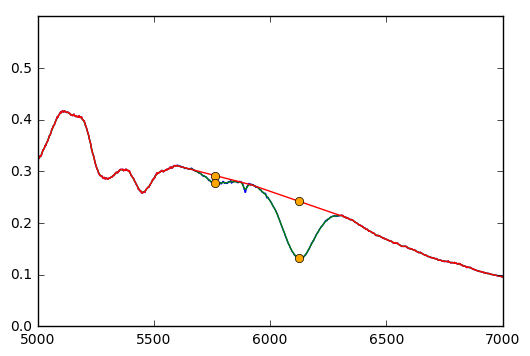

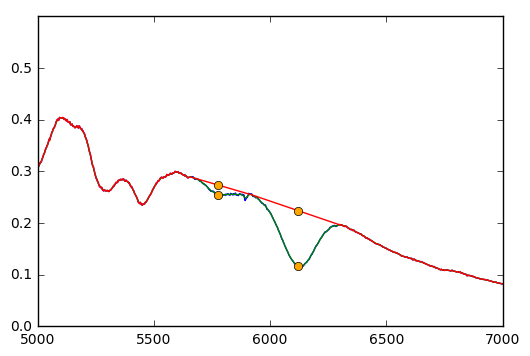

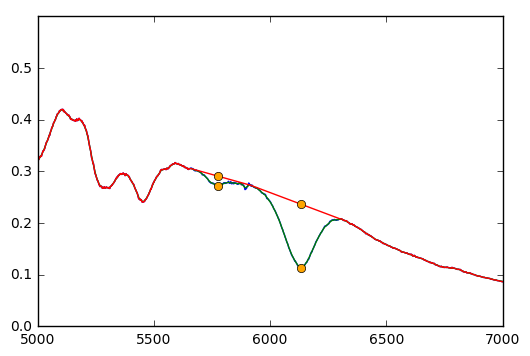

Could not find maximum in a specified range!


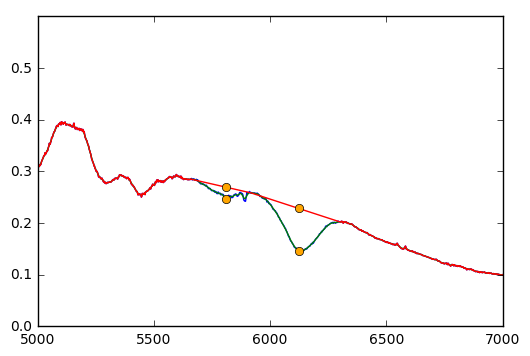

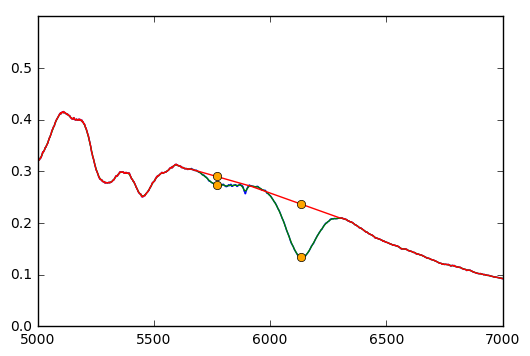

Could not find maximum in a specified range!


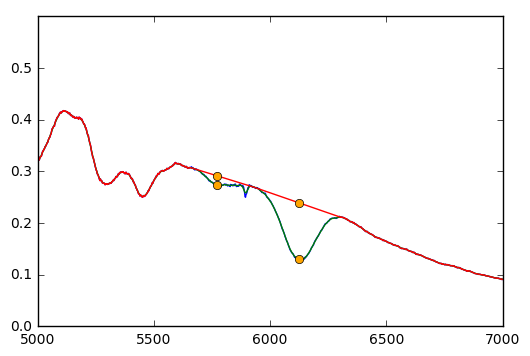

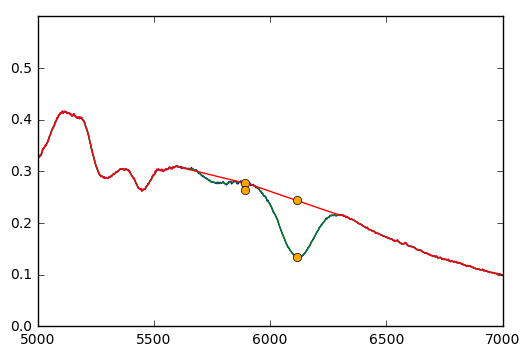

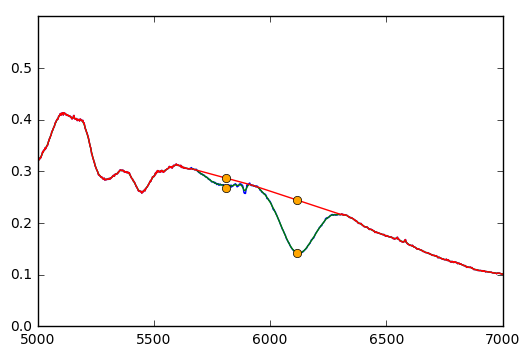

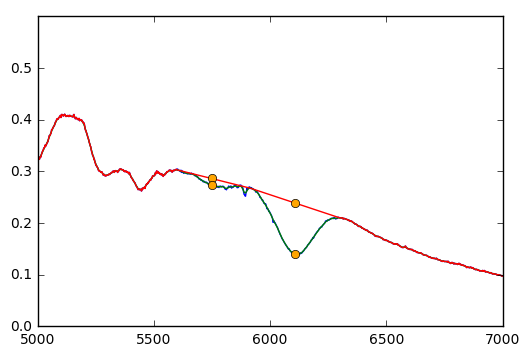

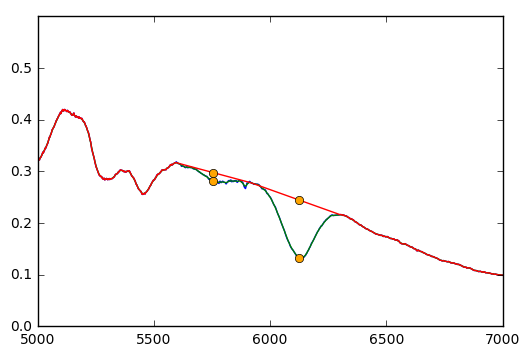

...

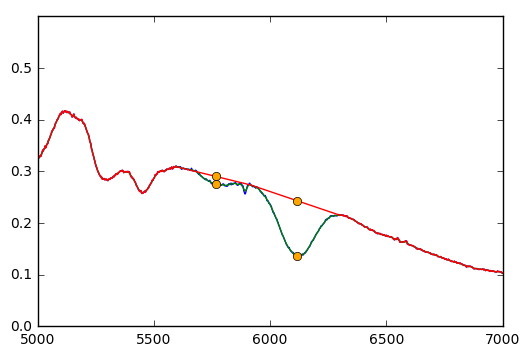

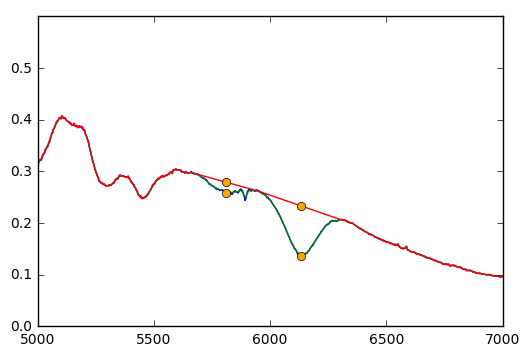

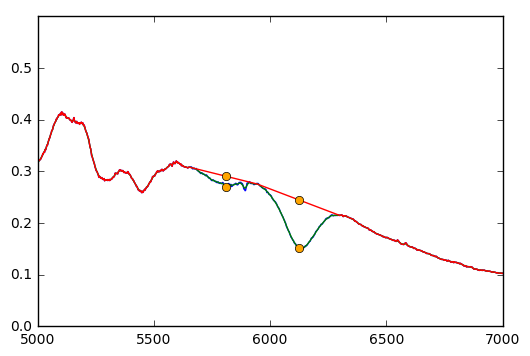

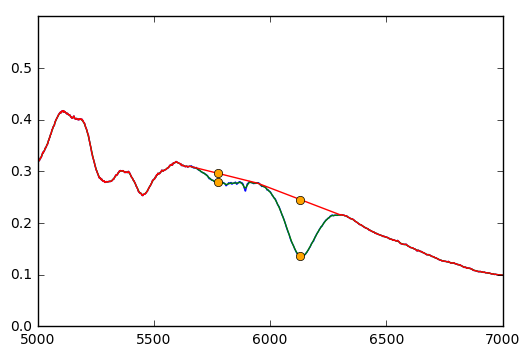

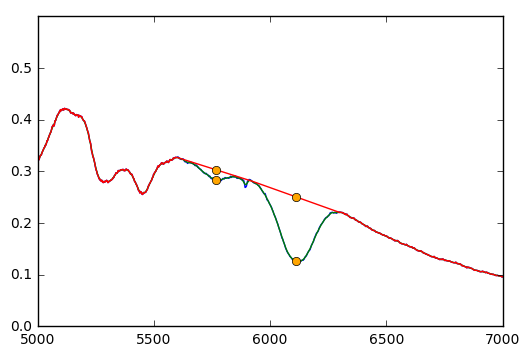

Could not find maximum in a specified range!


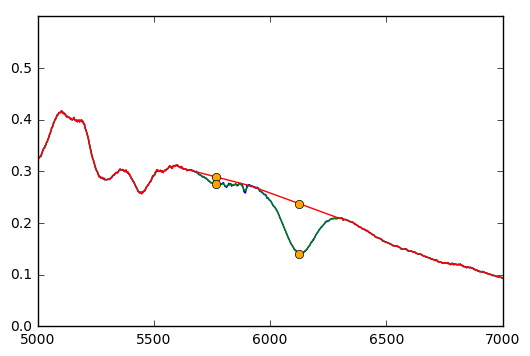

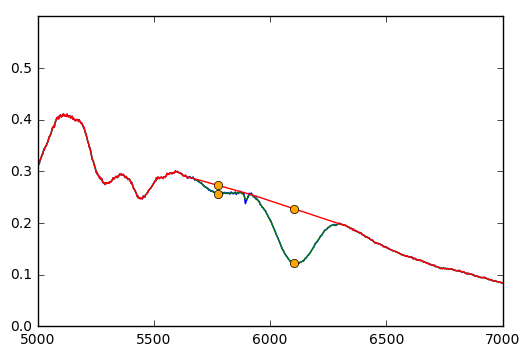

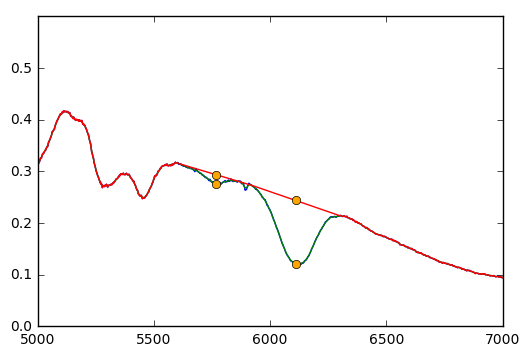

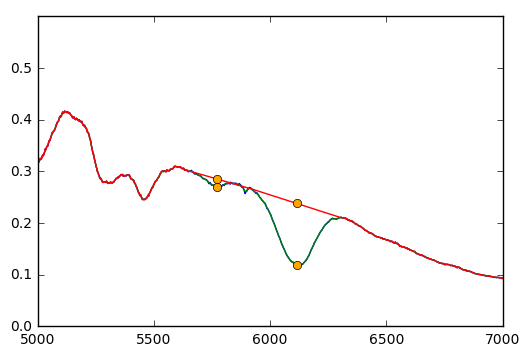

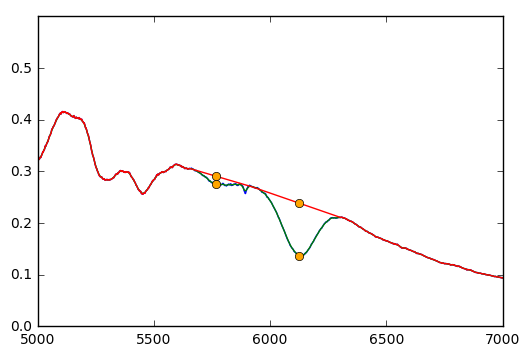

...

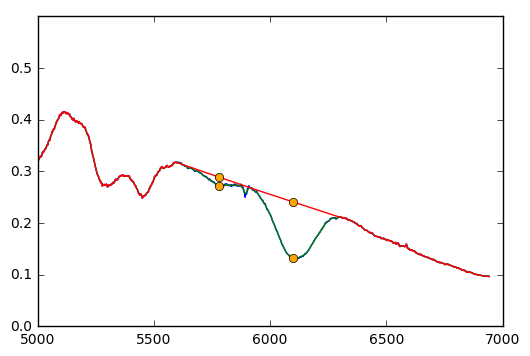

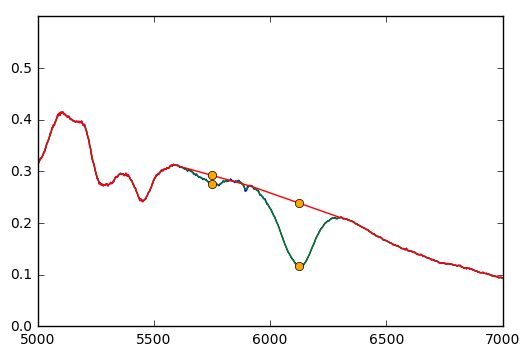

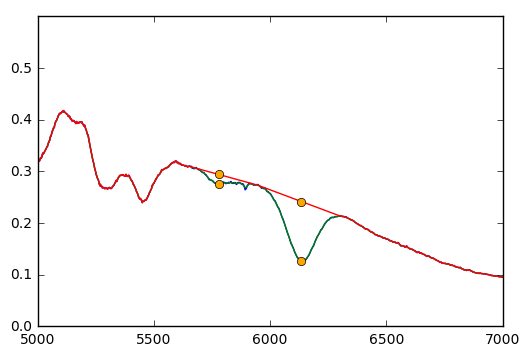

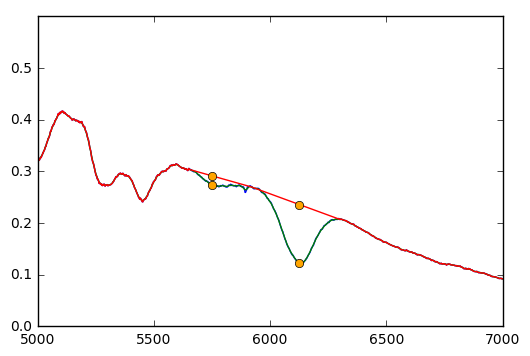

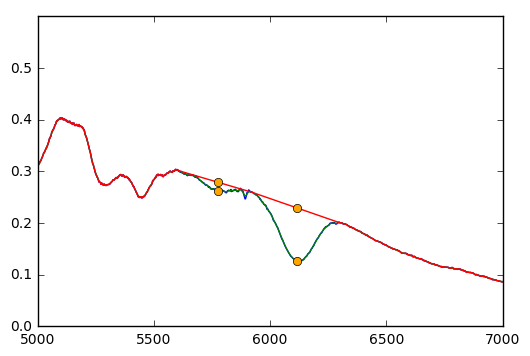

Could not find maximum in a specified range!


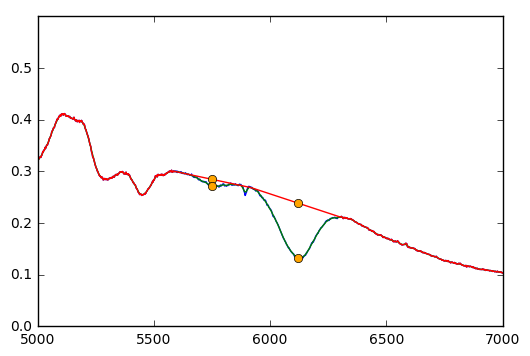

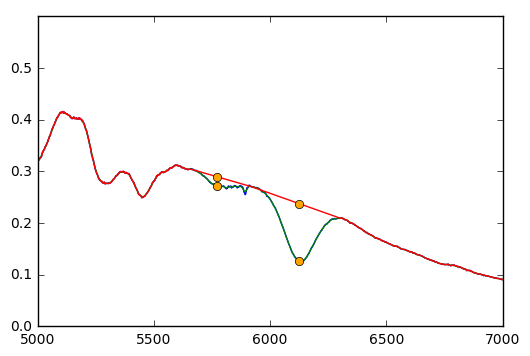

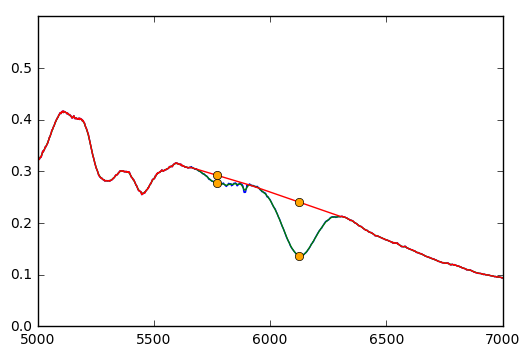

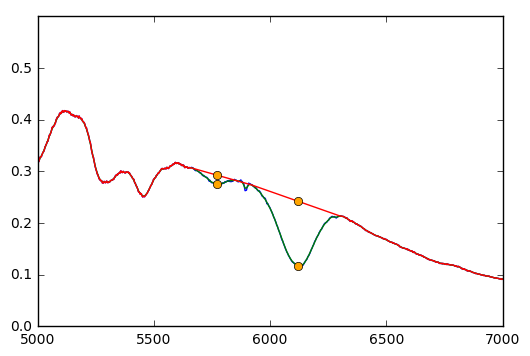

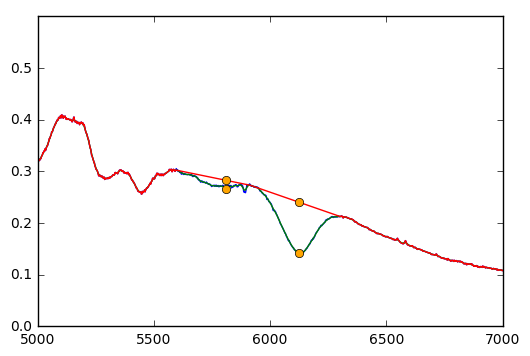

...

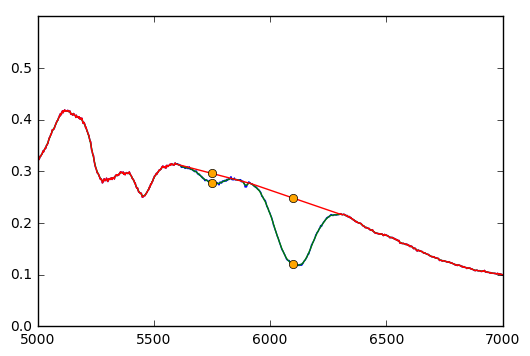

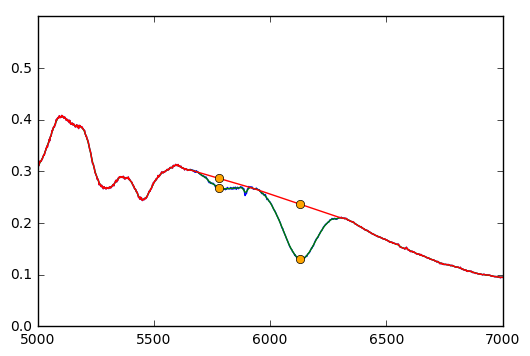

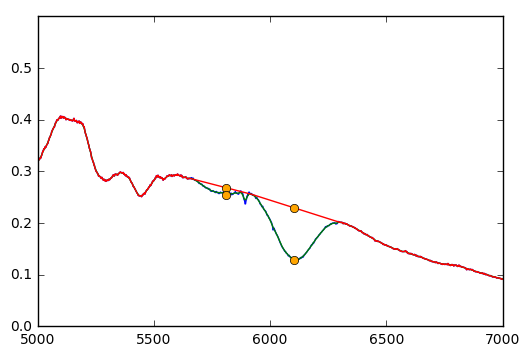

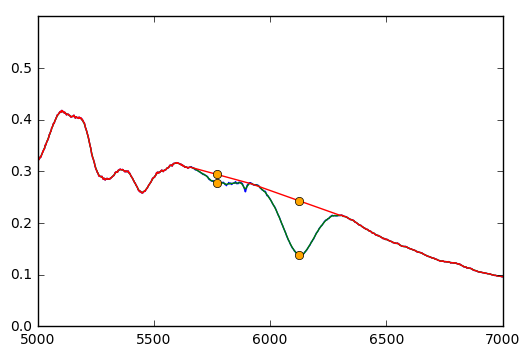

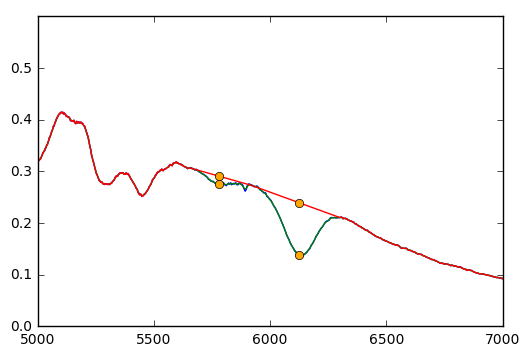

1
Could not find maximum in a specified range!


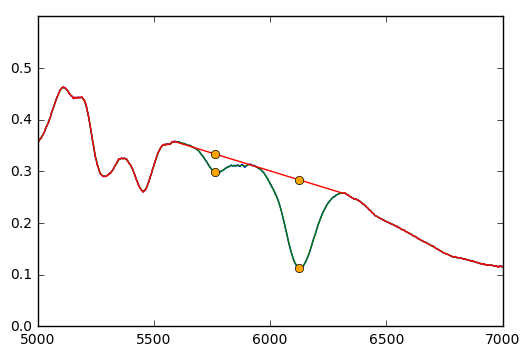

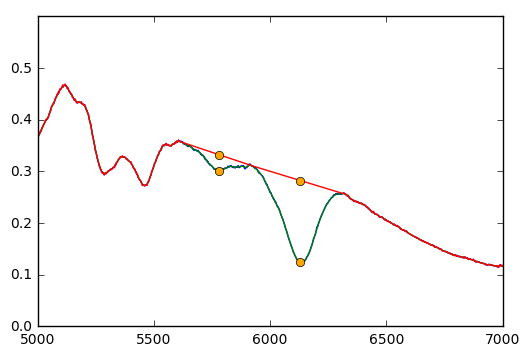

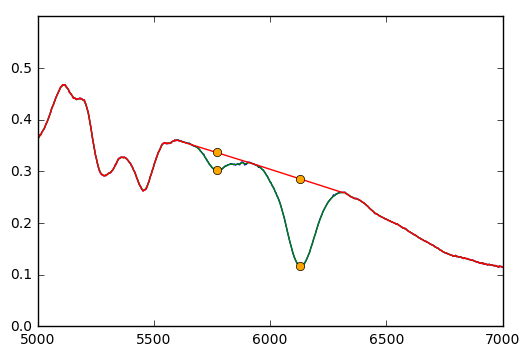

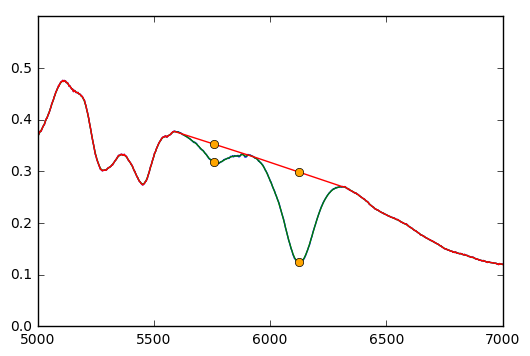

Could not find maximum in a specified range!


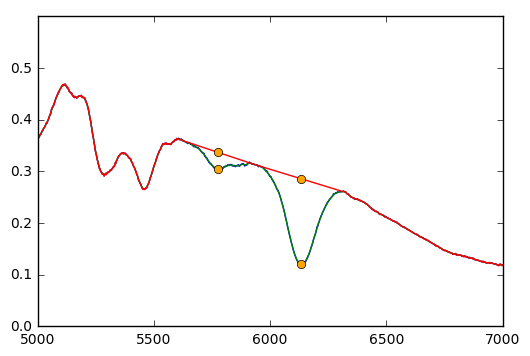

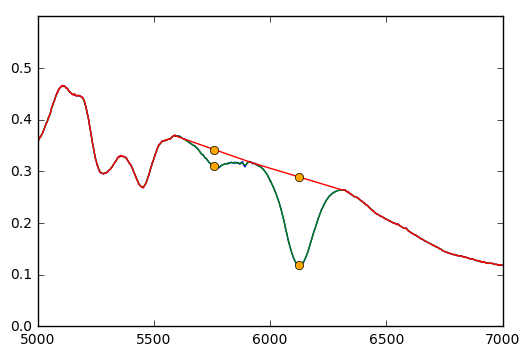

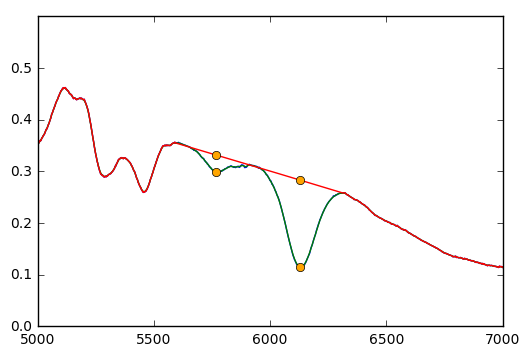

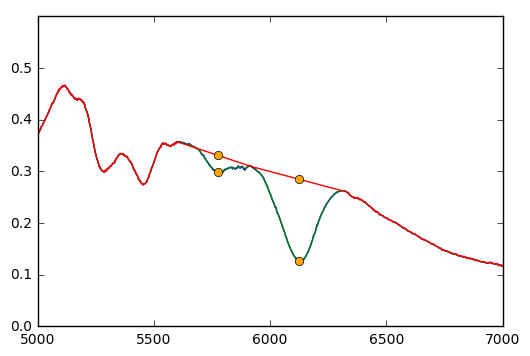

Could not find maximum in a specified range!


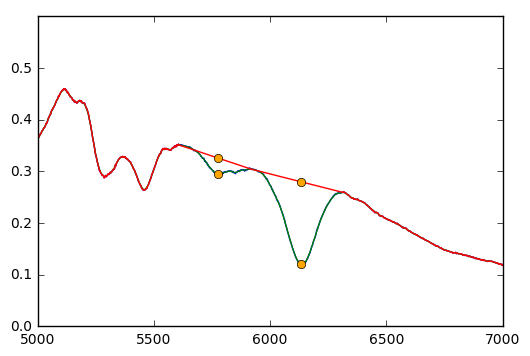

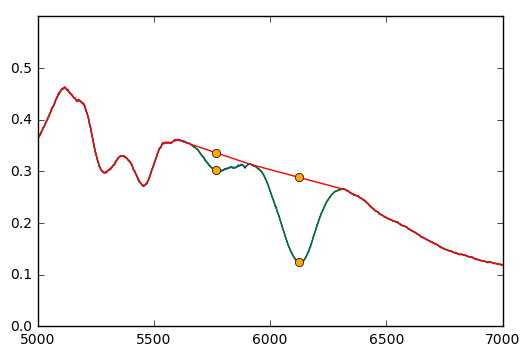

Could not find maximum in a specified range!


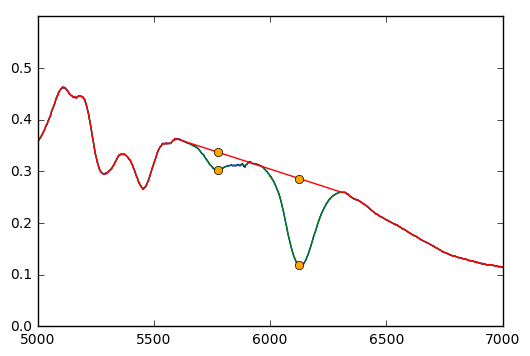

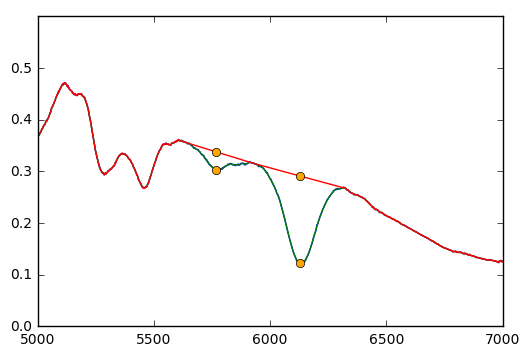

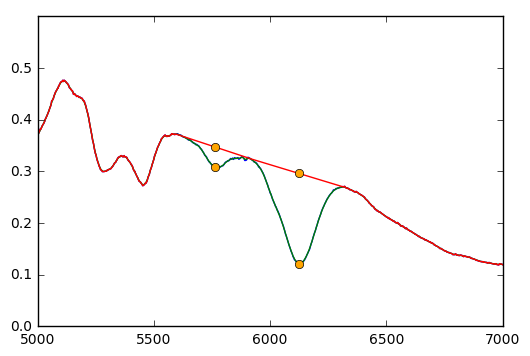

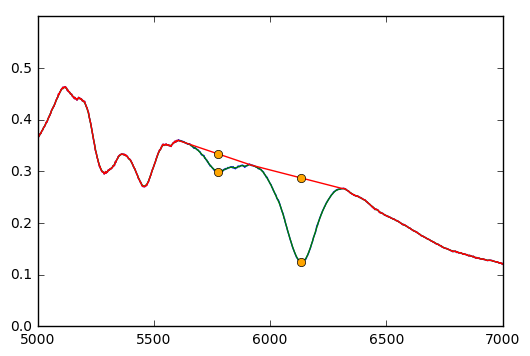

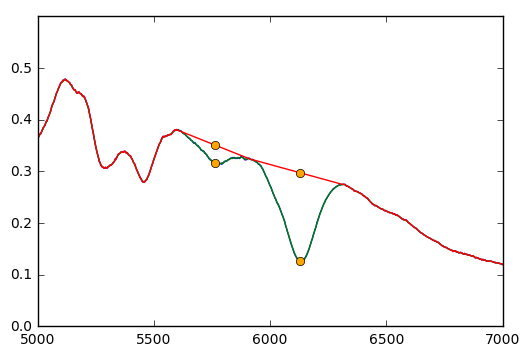

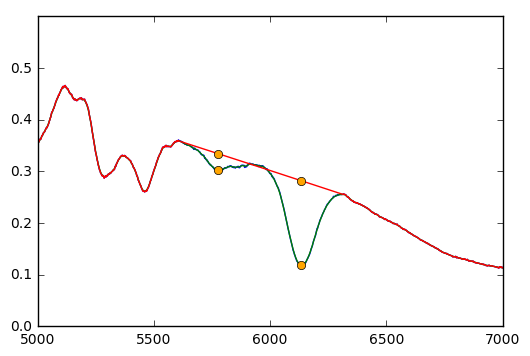

Could not find maximum in a specified range!


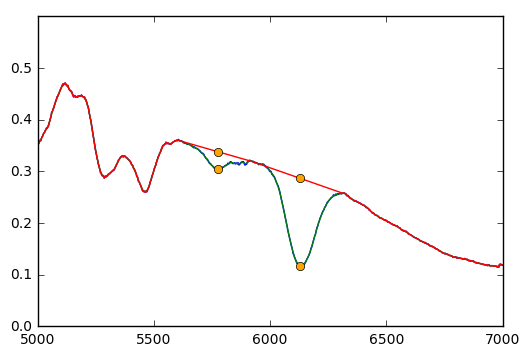

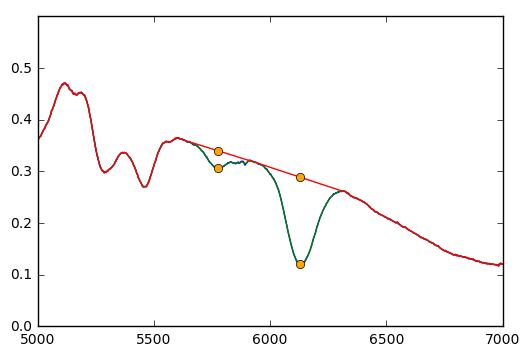

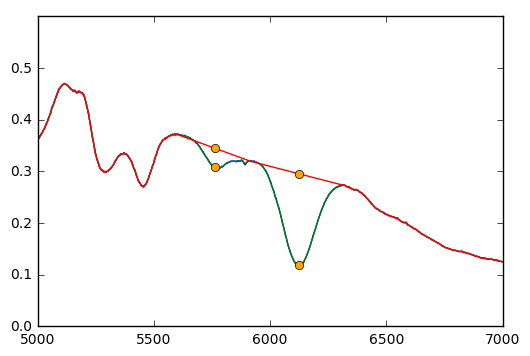

Could not find maximum in a specified range!


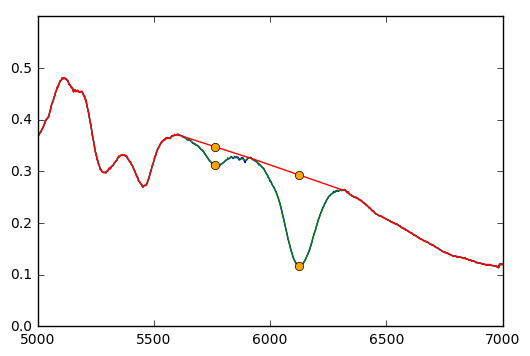

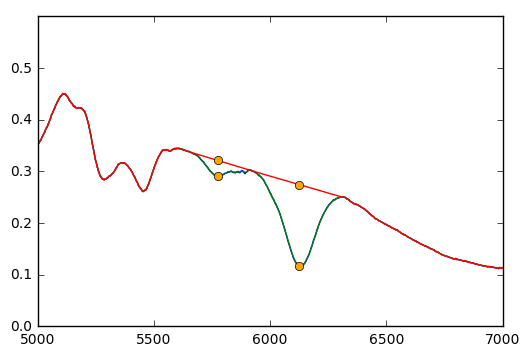

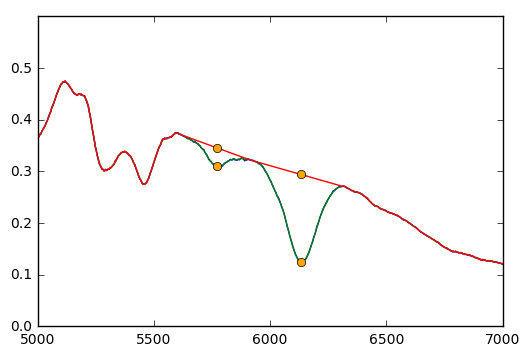

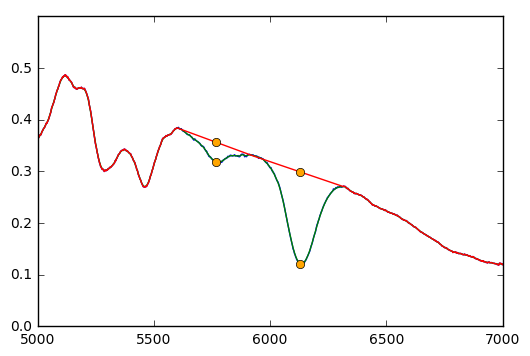

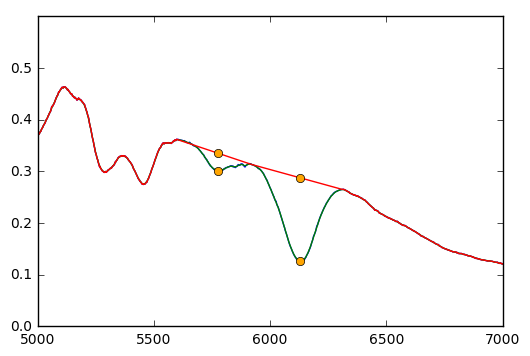

...

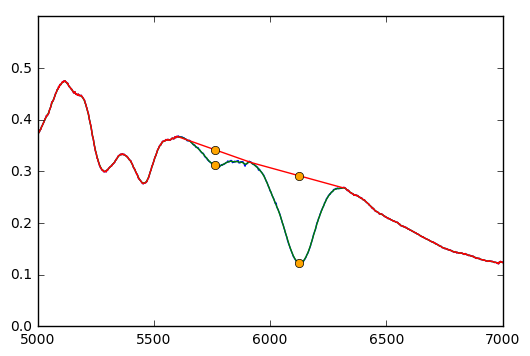

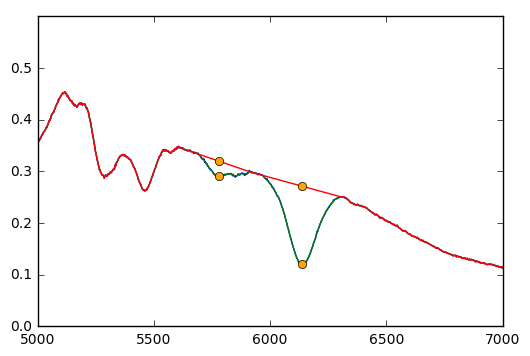

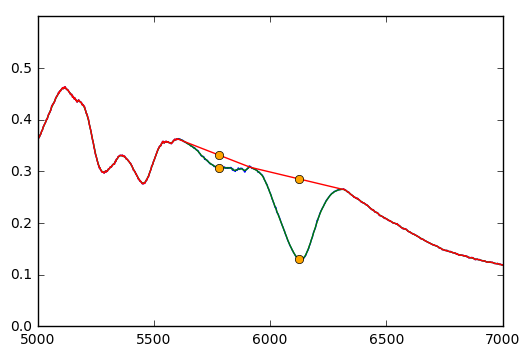

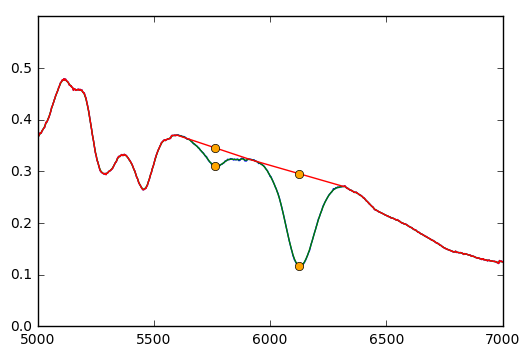

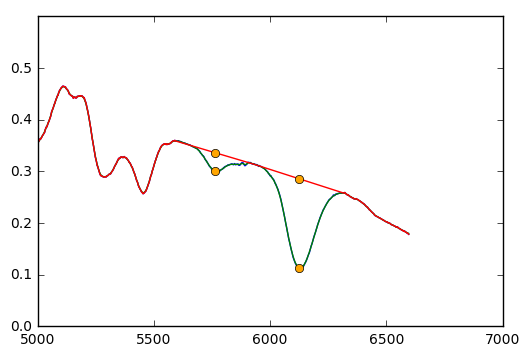

Could not find maximum in a specified range!


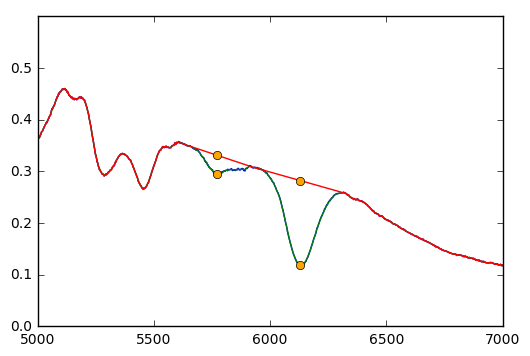

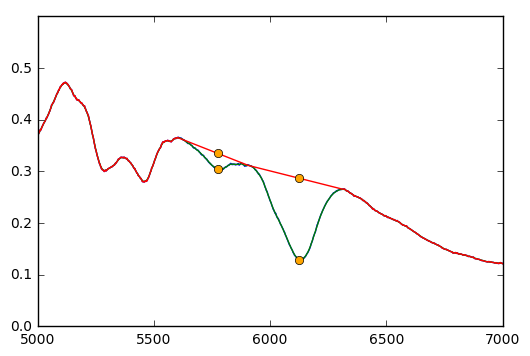

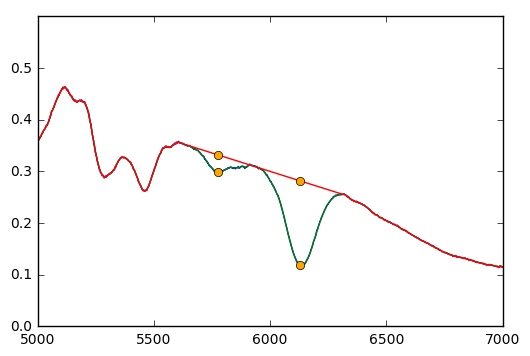

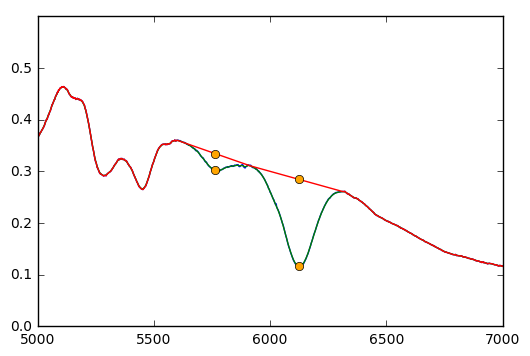

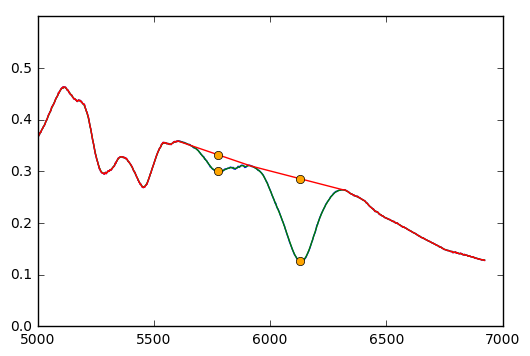

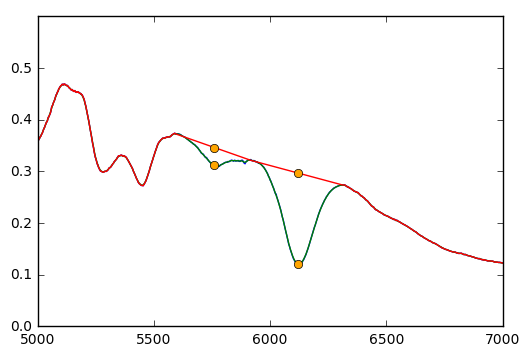

Could not find maximum in a specified range!


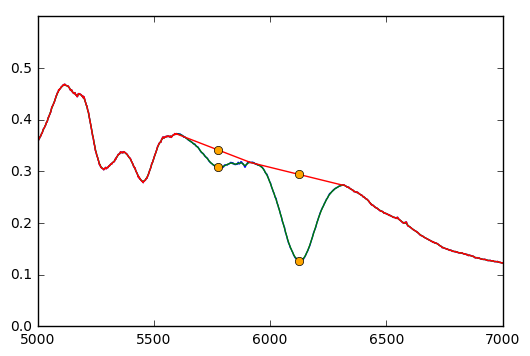

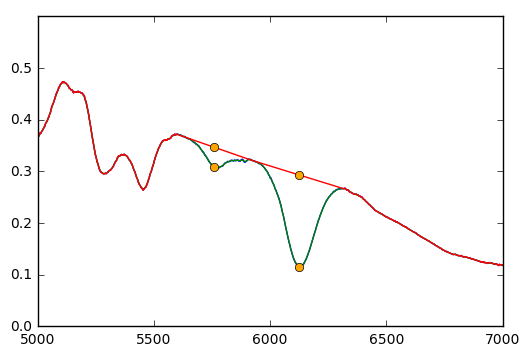

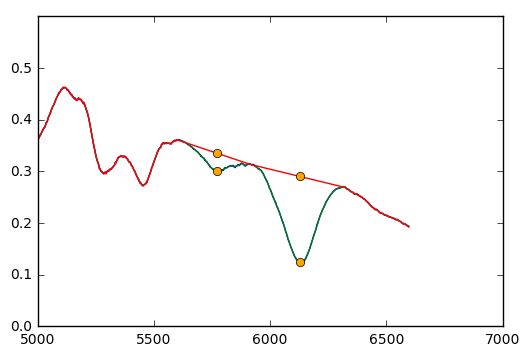

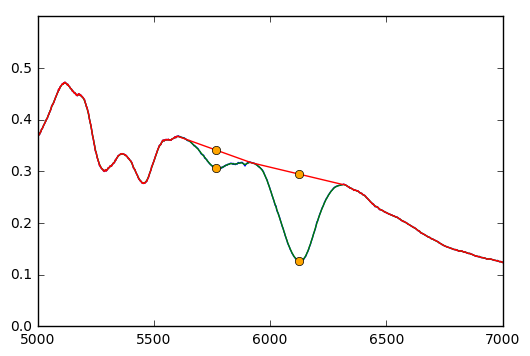

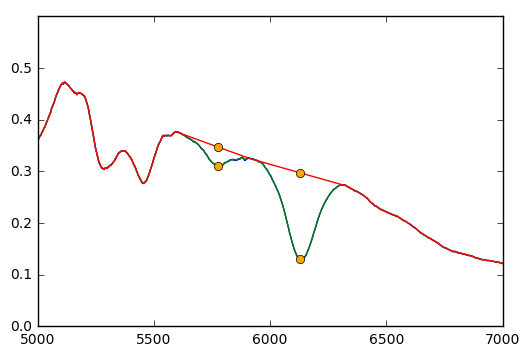

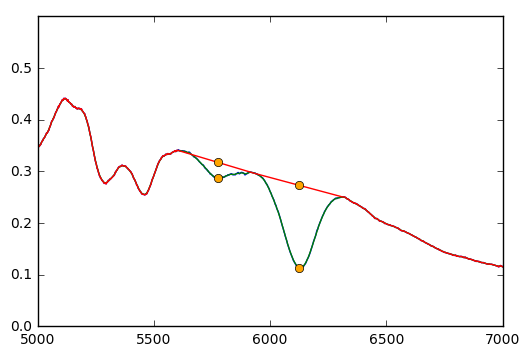

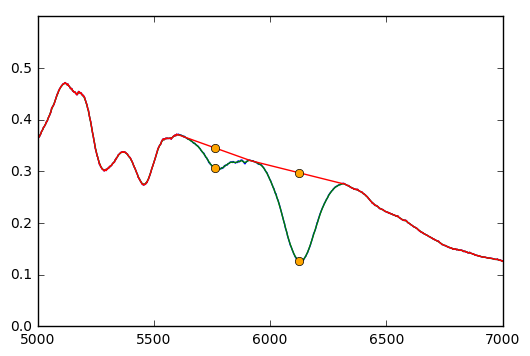

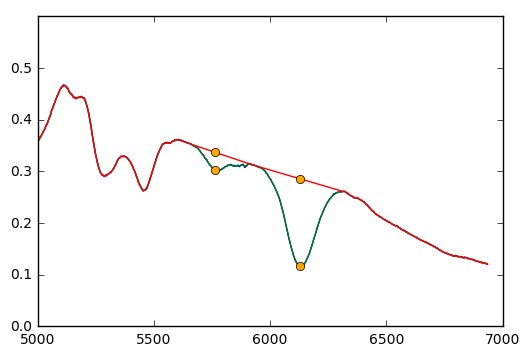

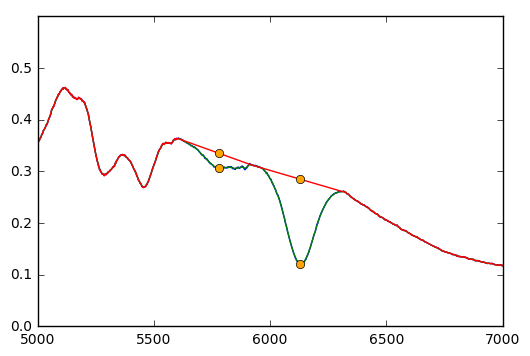

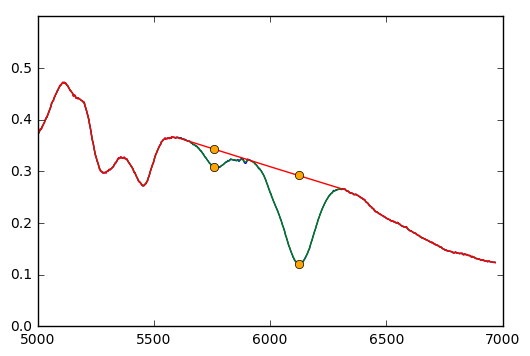

Could not find maximum in a specified range!


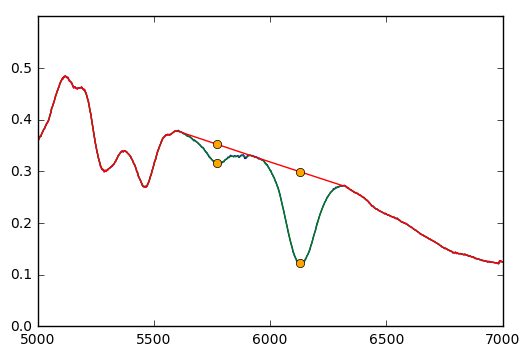

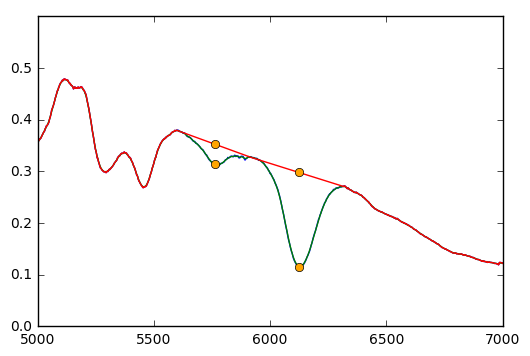

Could not find maximum in a specified range!


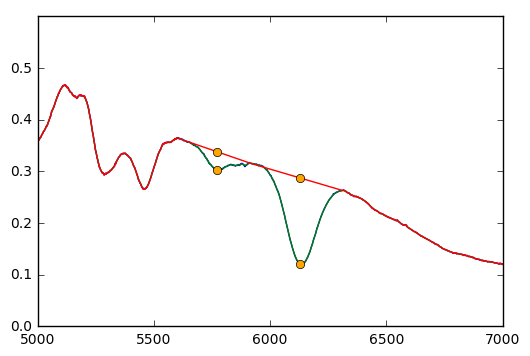

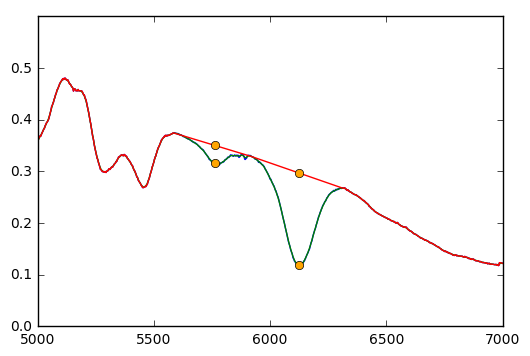

Could not find maximum in a specified range!
Could not find maximum in a specified range!


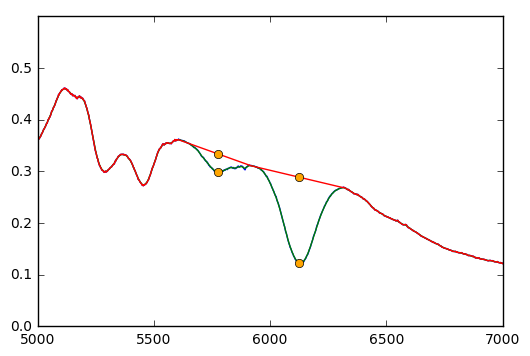

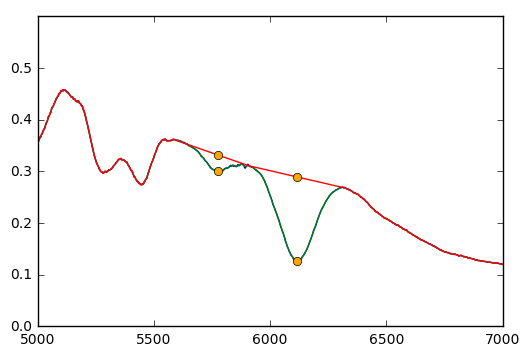

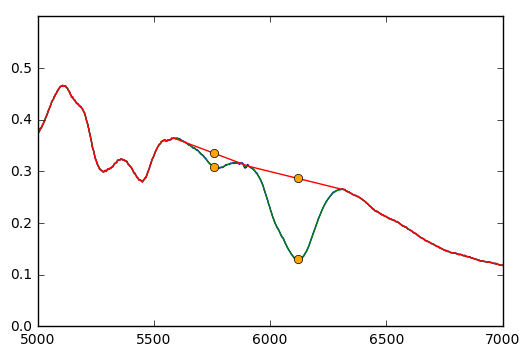

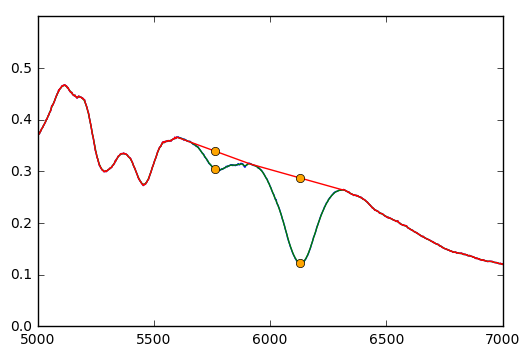

2


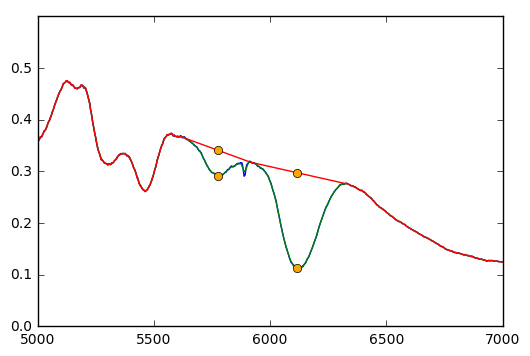

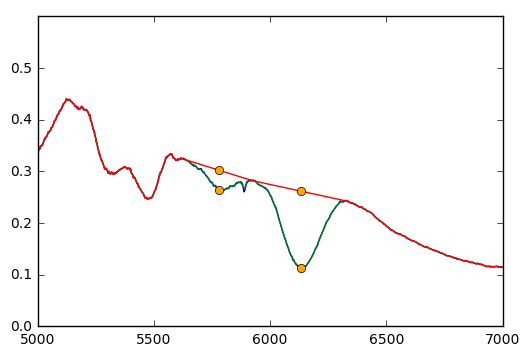

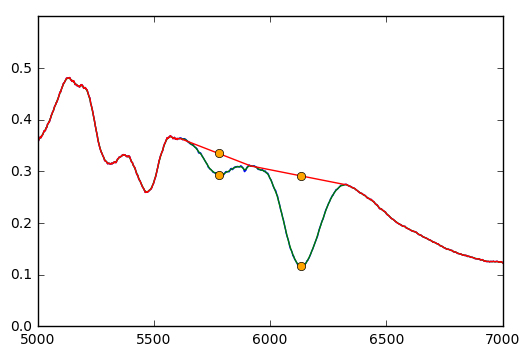

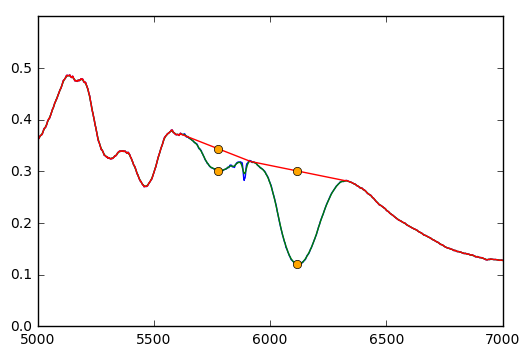

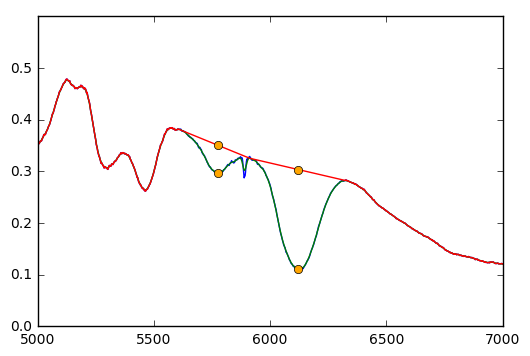

...

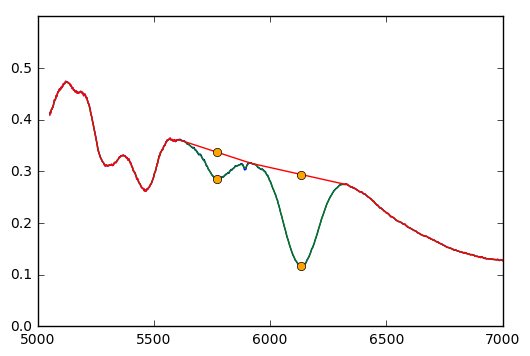

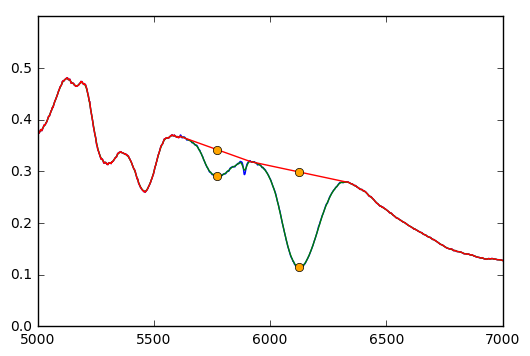

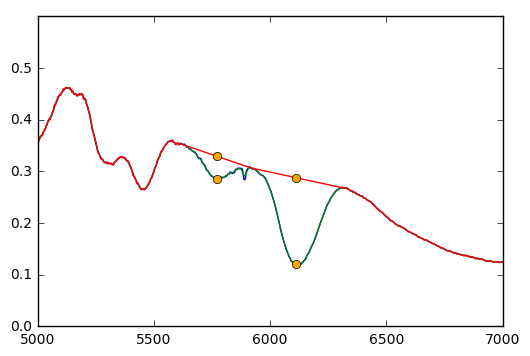

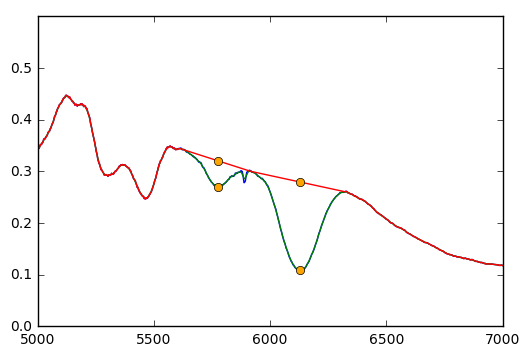

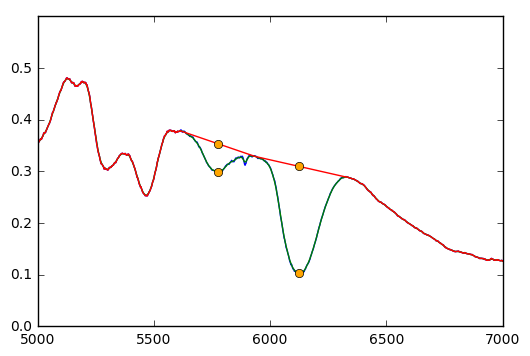

3


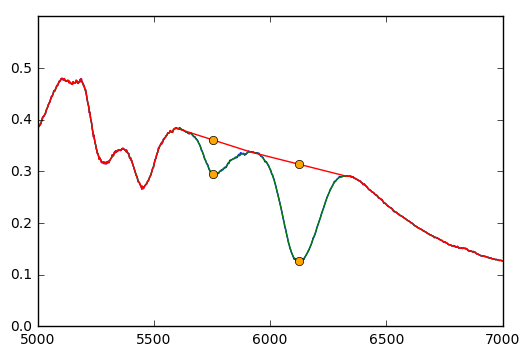

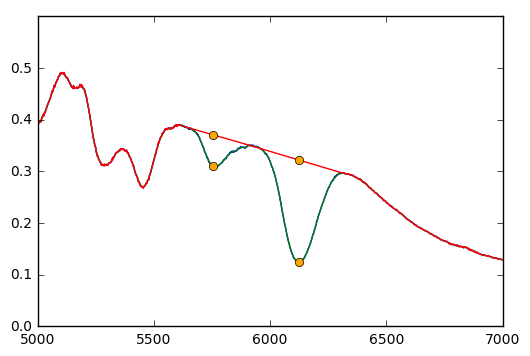

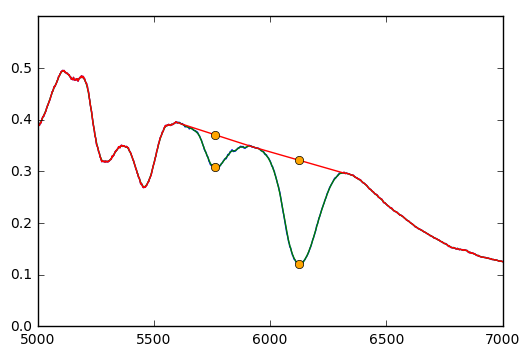

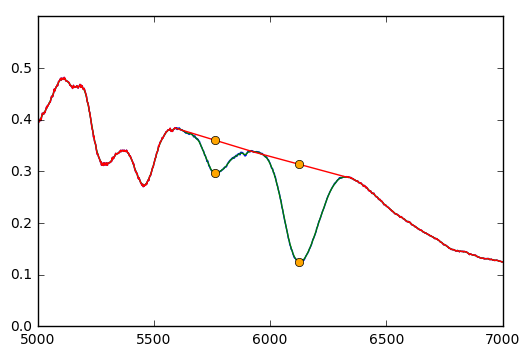

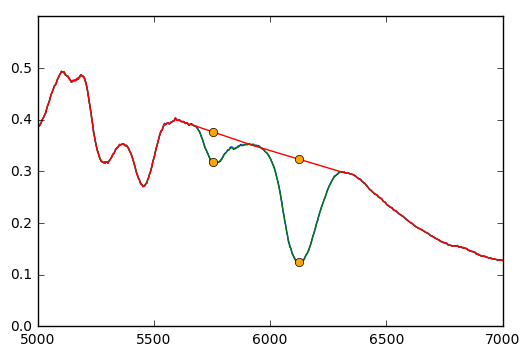

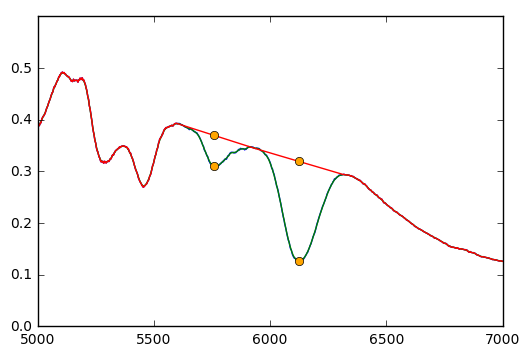

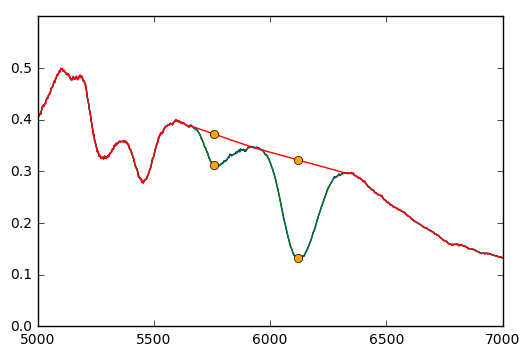

Could not find maximum in a specified range!


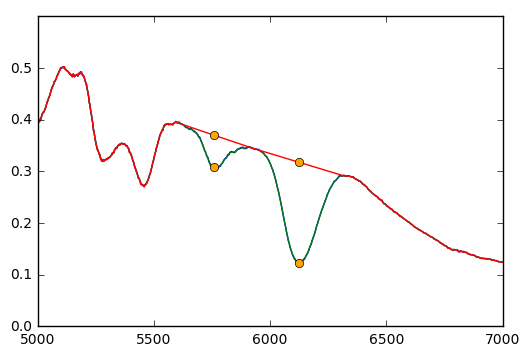

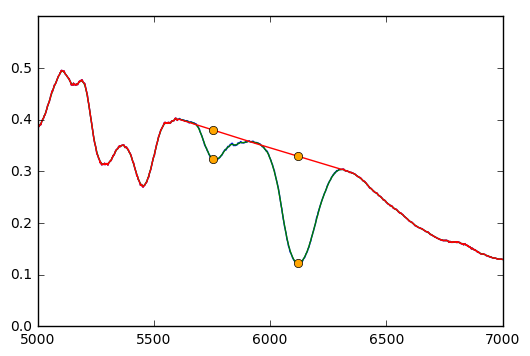

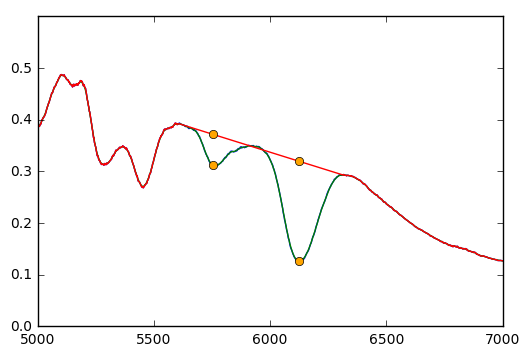

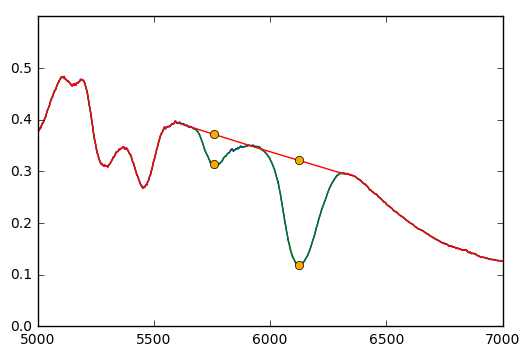

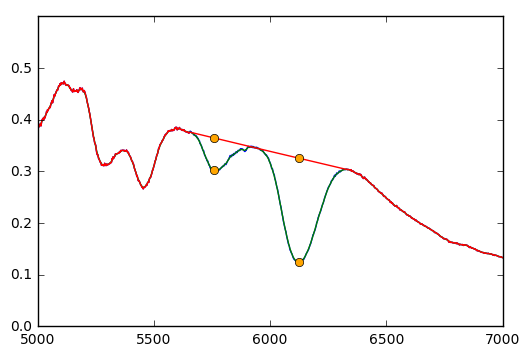

...

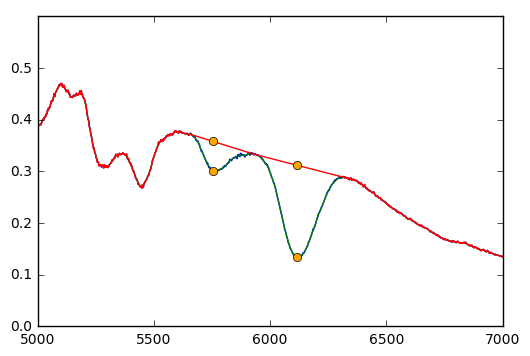

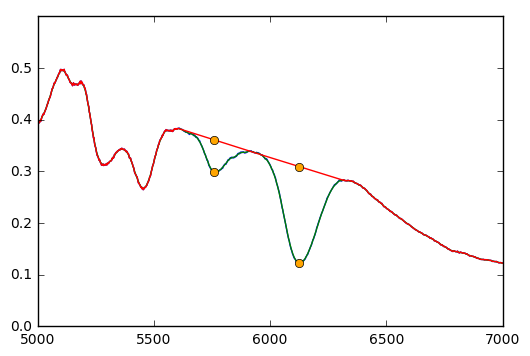

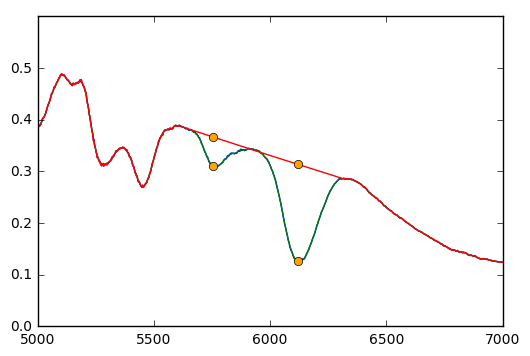

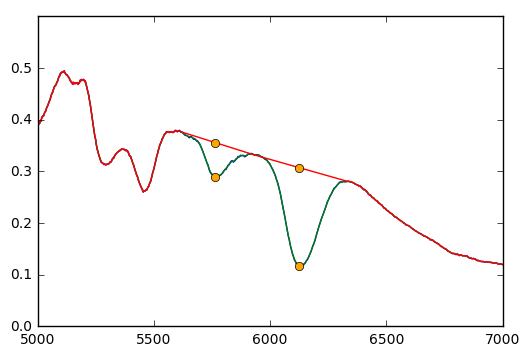

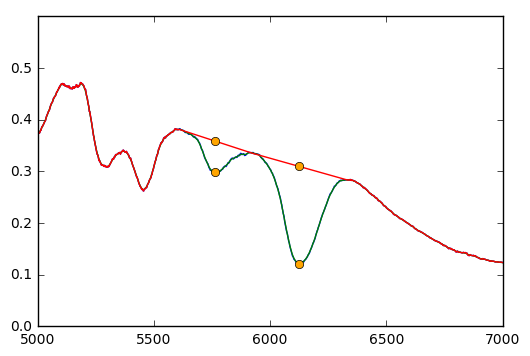

Could not find maximum in a specified range!


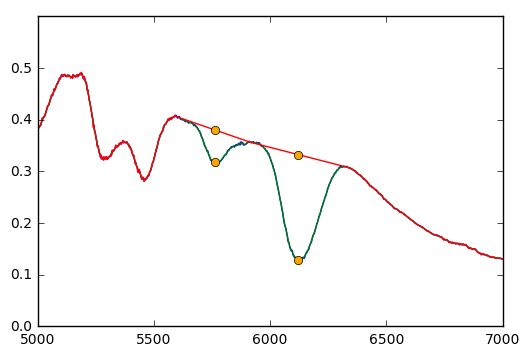

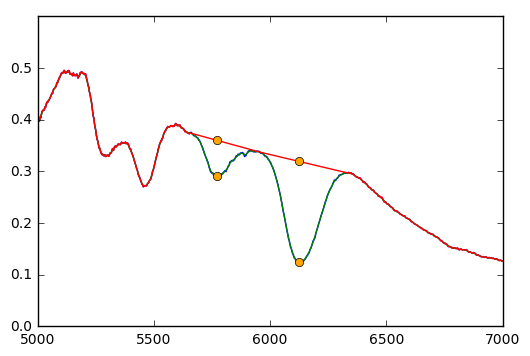

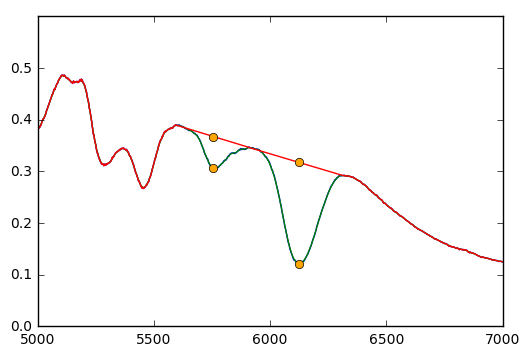

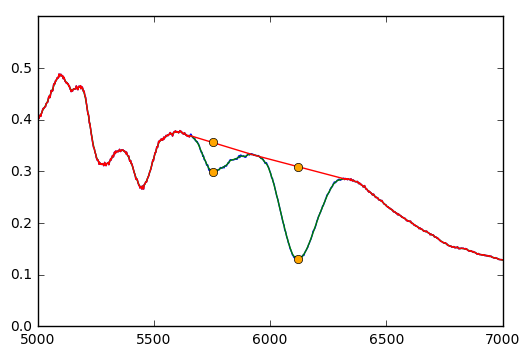

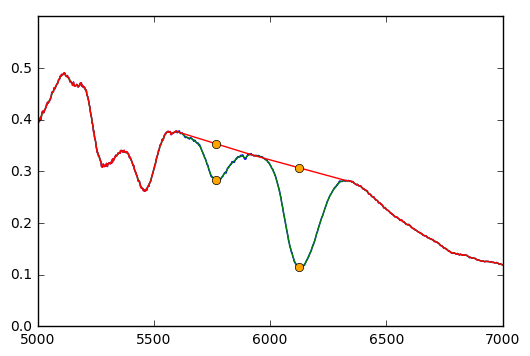

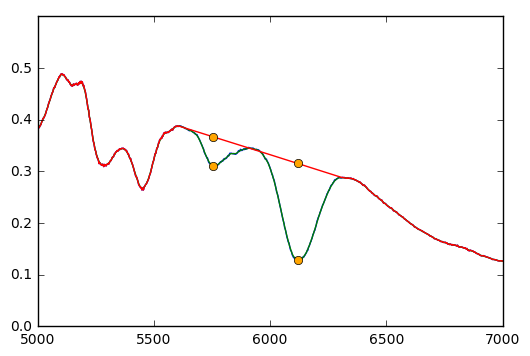

Could not find maximum in a specified range!


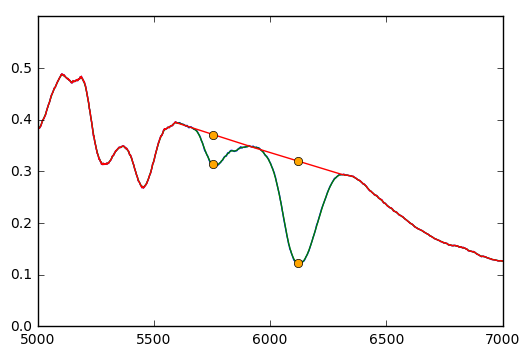

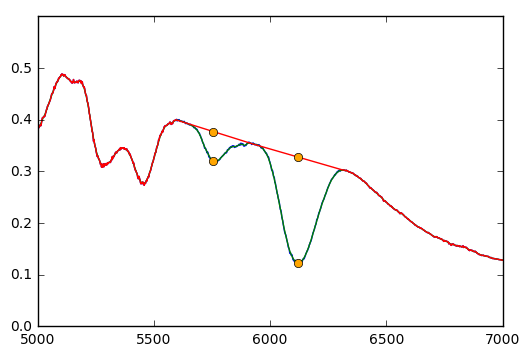

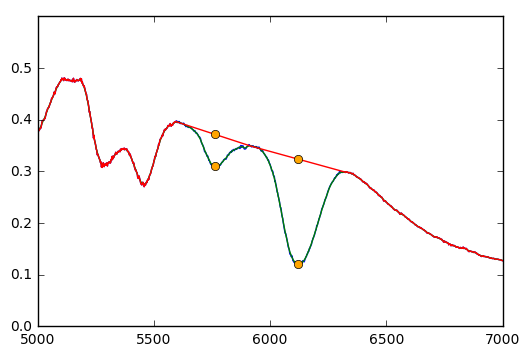

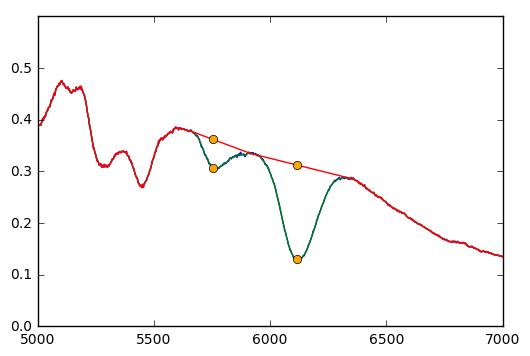

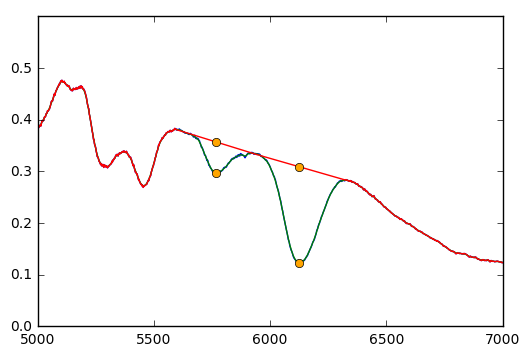

...

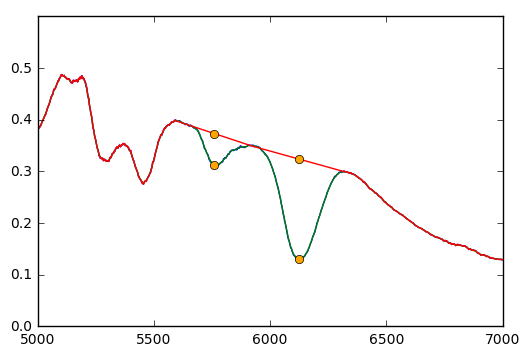

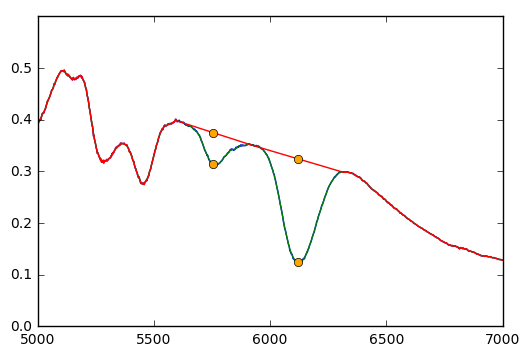

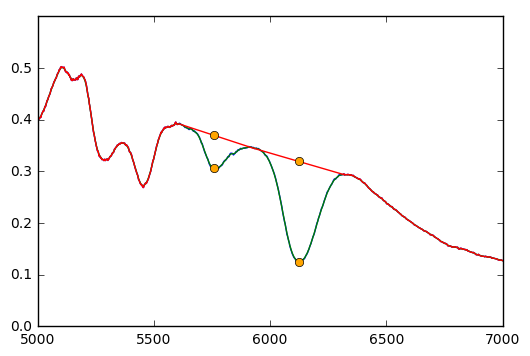

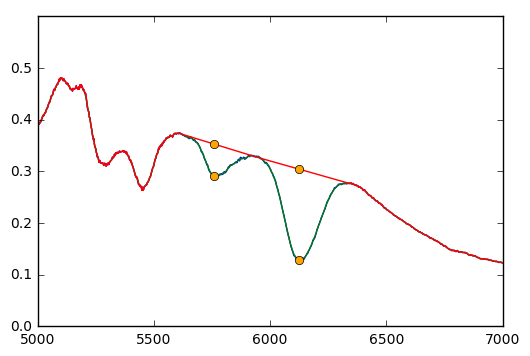

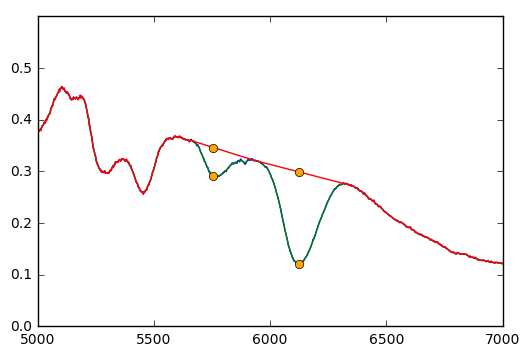

Could not find maximum in a specified range!


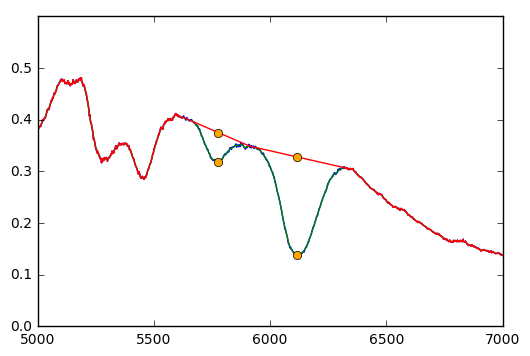

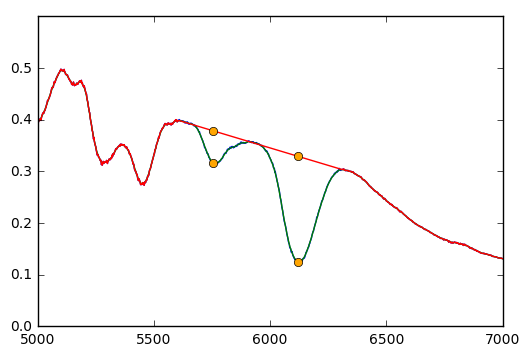

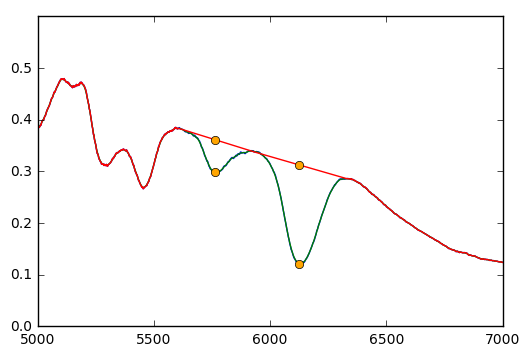

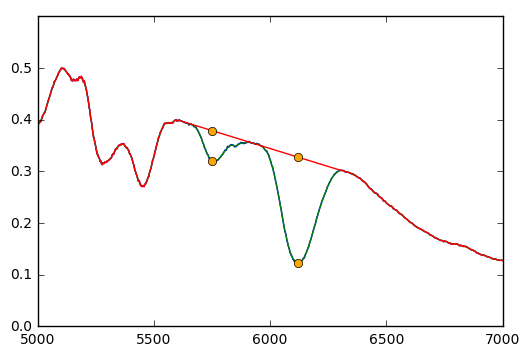

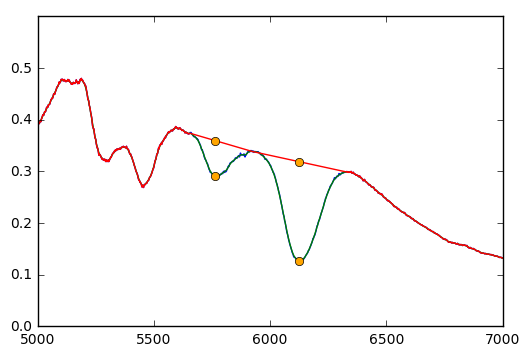

...

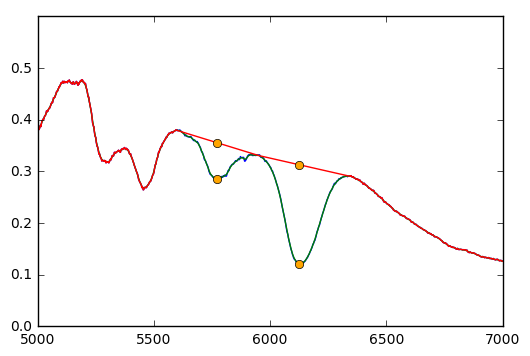

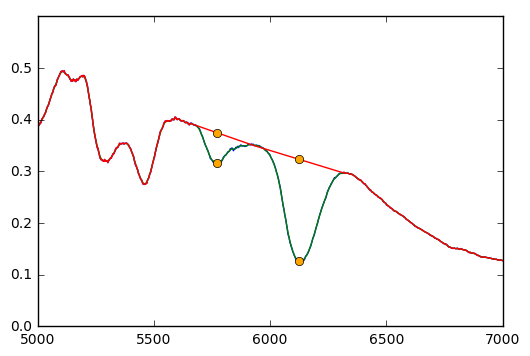

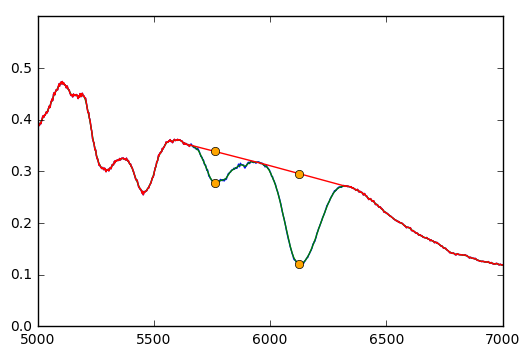

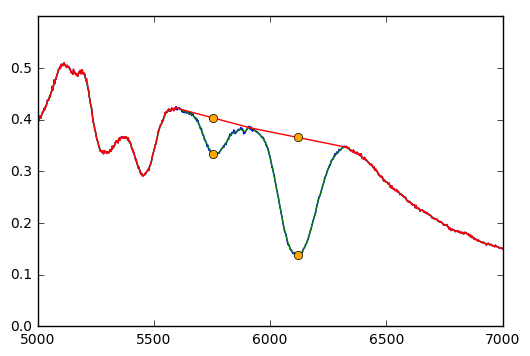

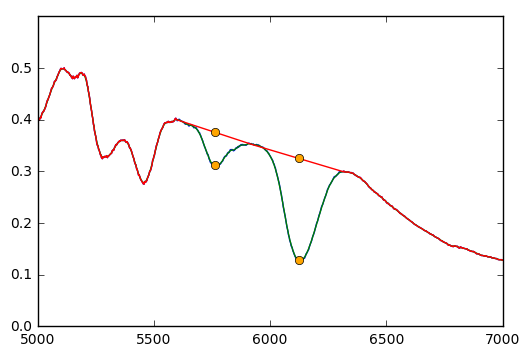

Could not find maximum in a specified range!


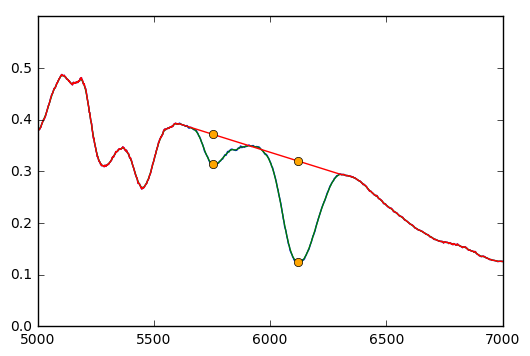

Could not find maximum in a specified range!


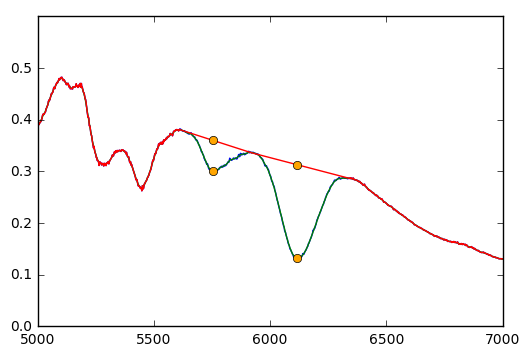

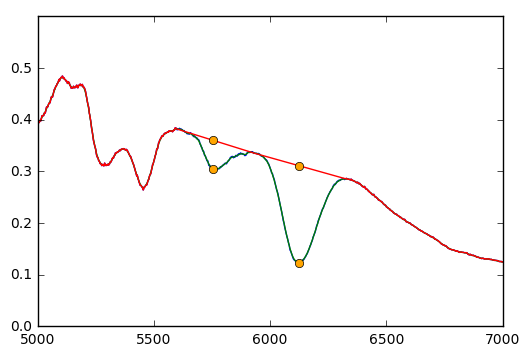

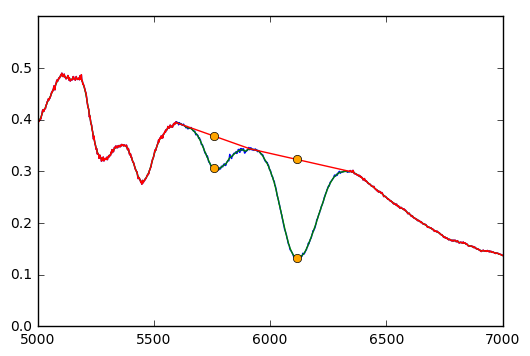

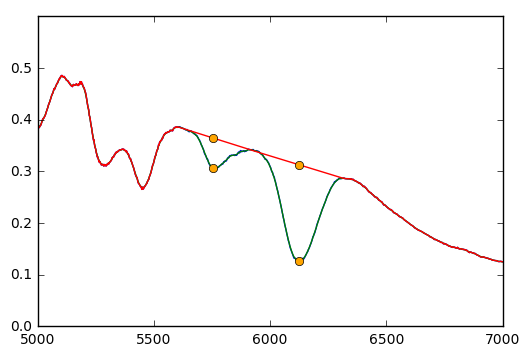

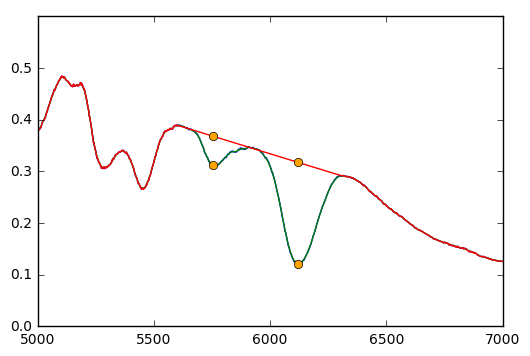

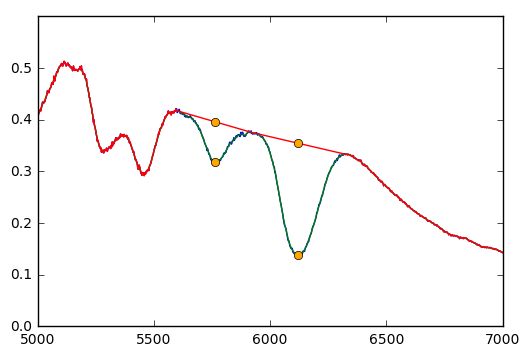

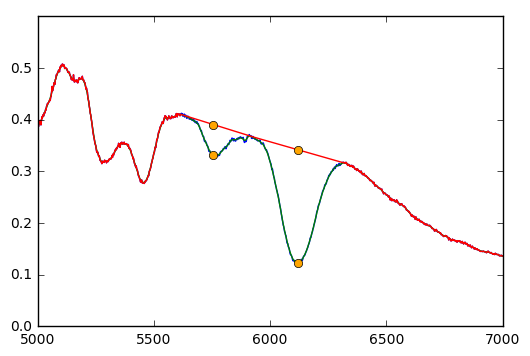

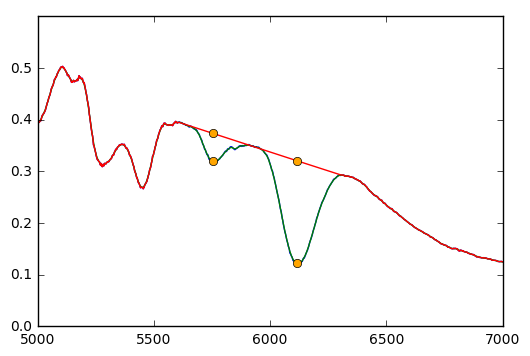

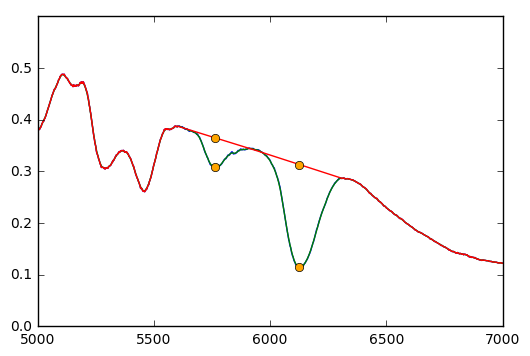

4


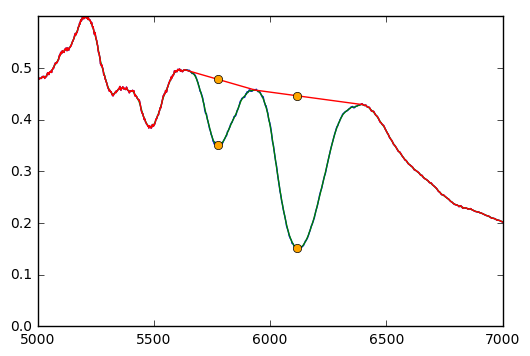

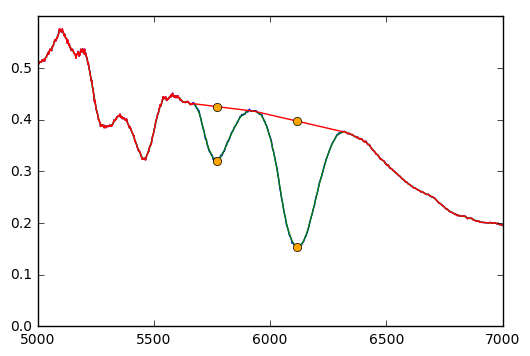

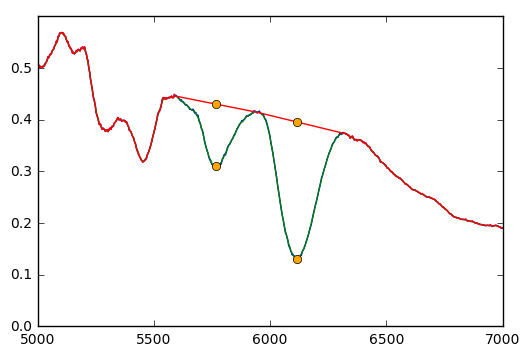

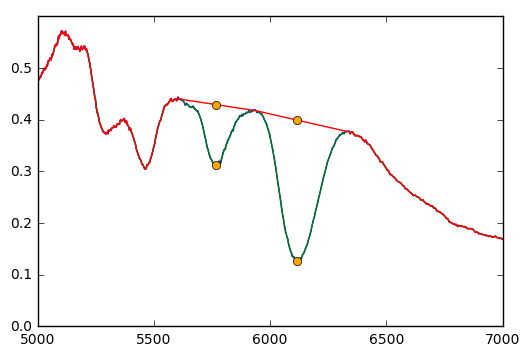

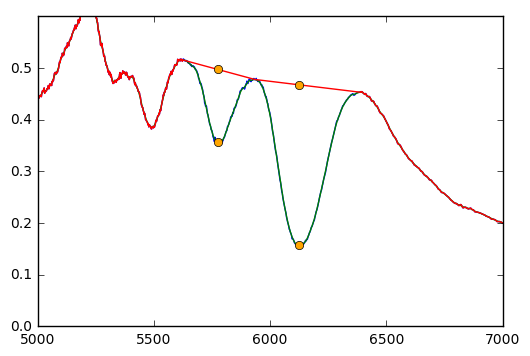

...

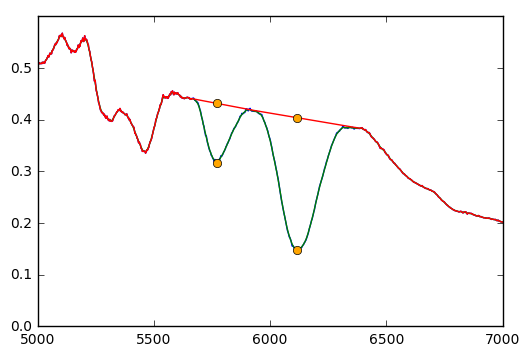

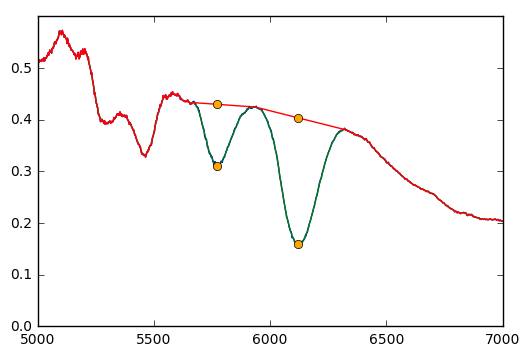

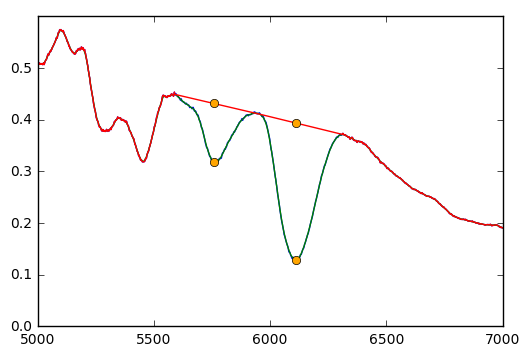

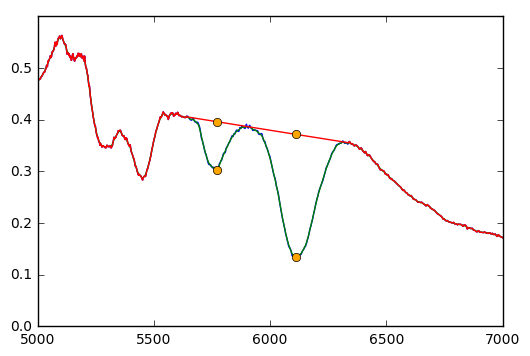

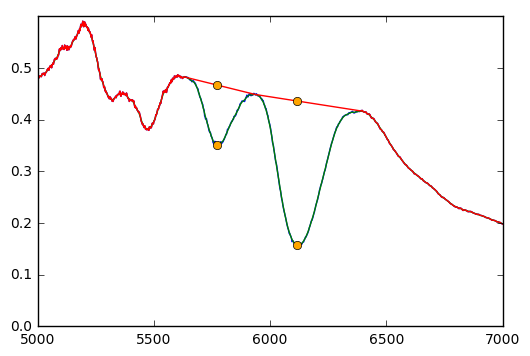

5


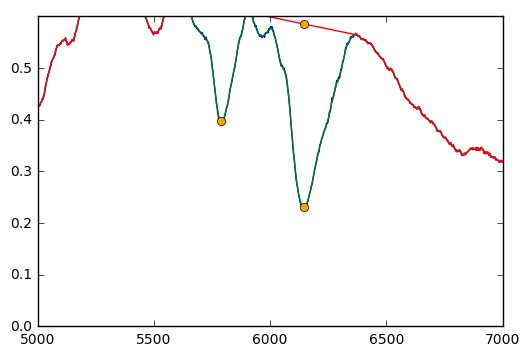

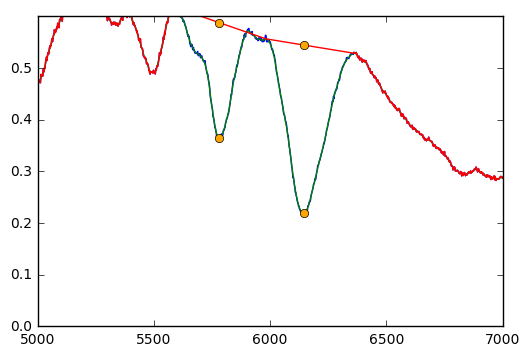

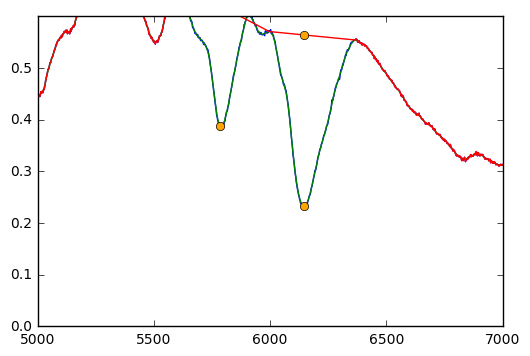

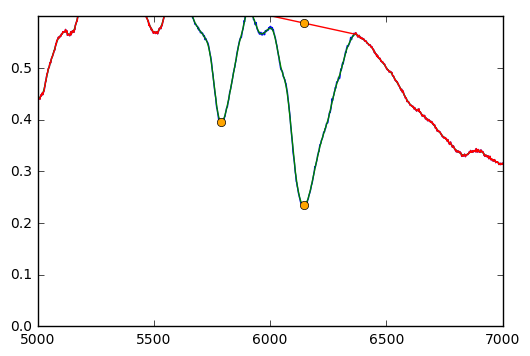

Could not find maximum in a specified range!
Could not find maximum in a specified range!


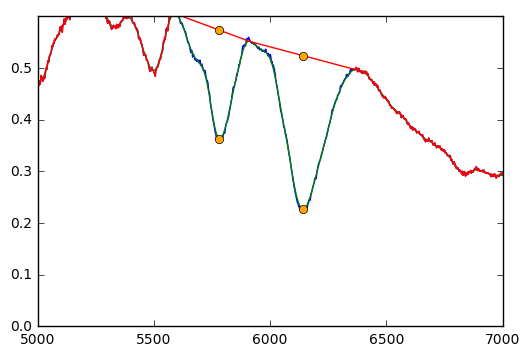

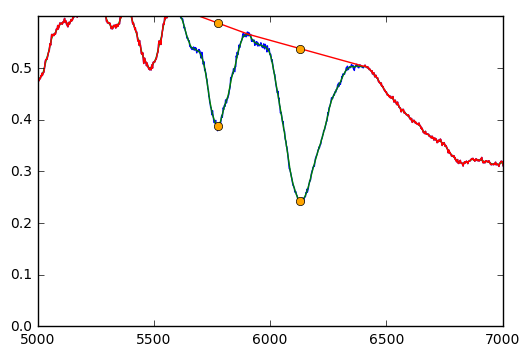

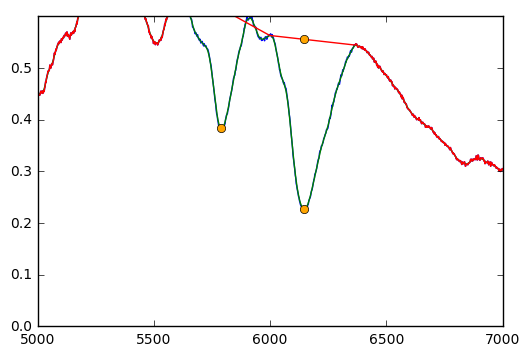

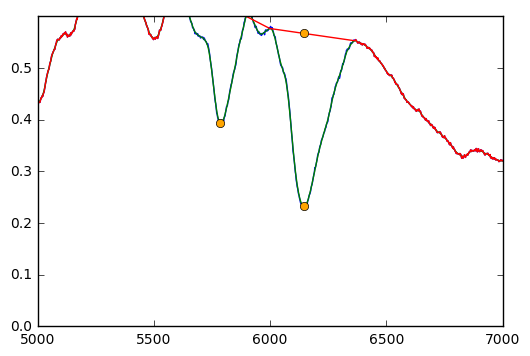

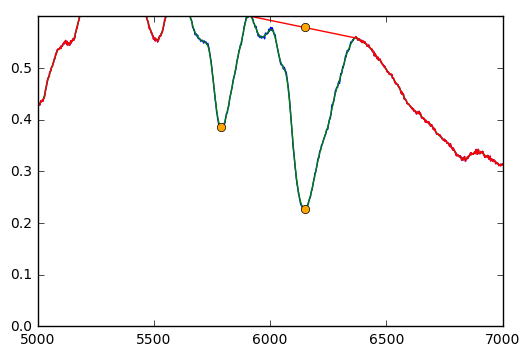

...

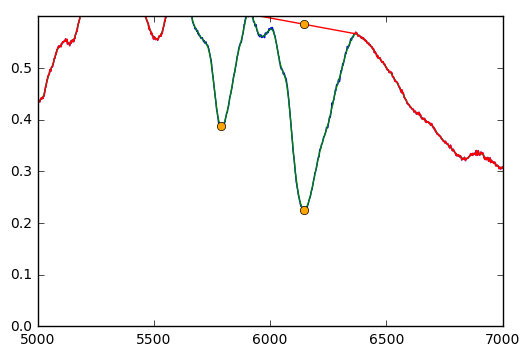

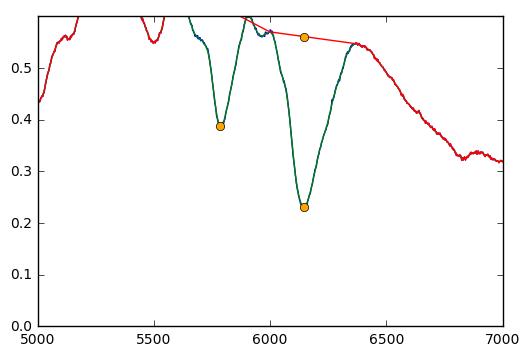

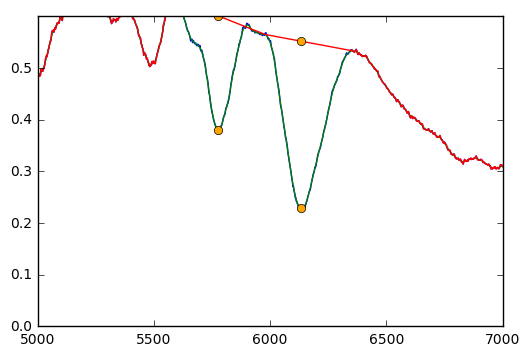

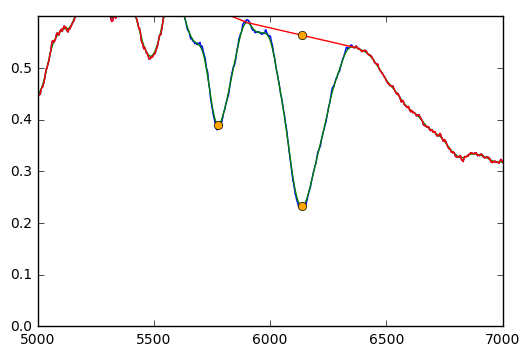

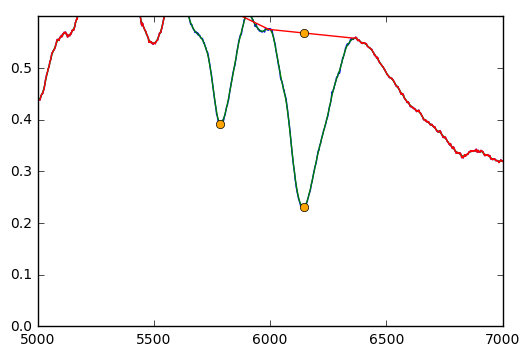

Could not find maximum in a specified range!


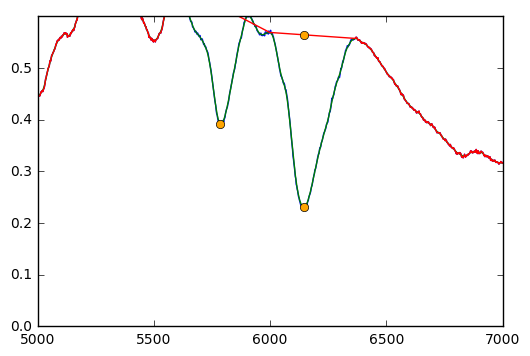

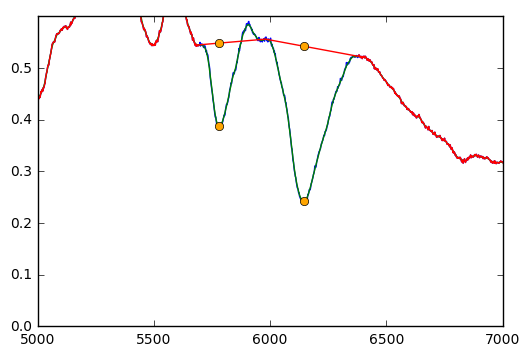

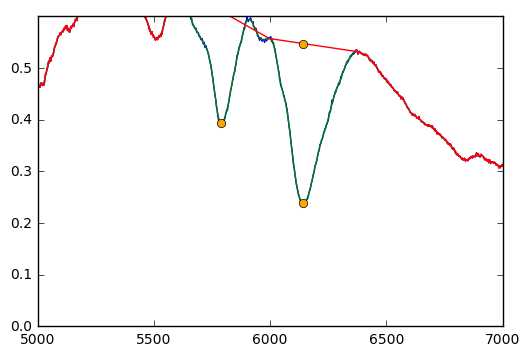

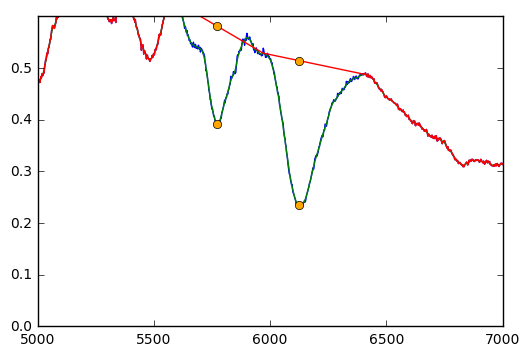

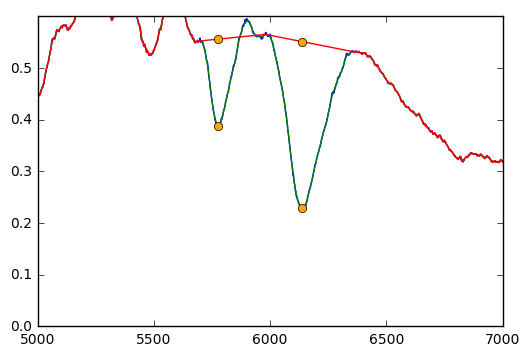

...

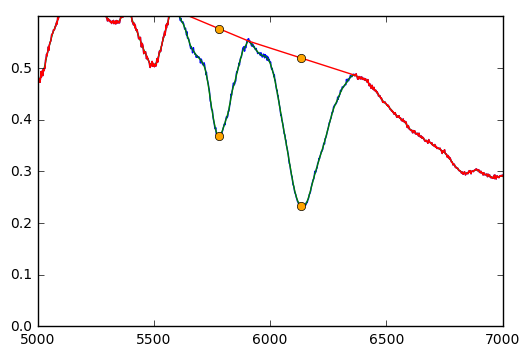

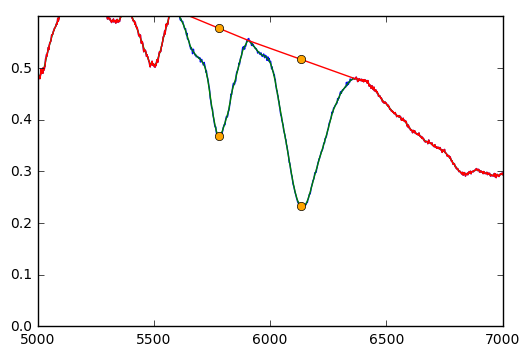

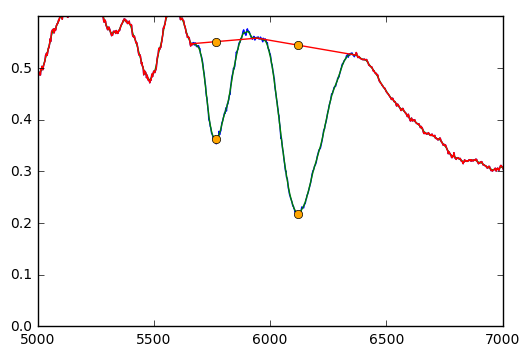

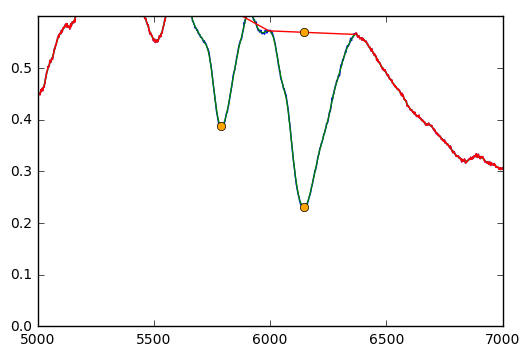

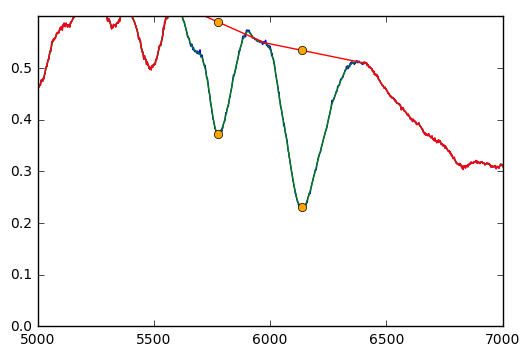

Could not find maximum in a specified range!


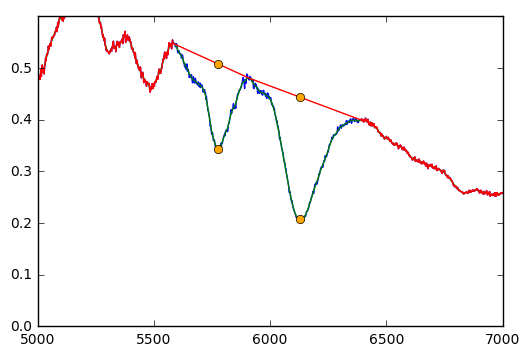

Could not find maximum in a specified range!


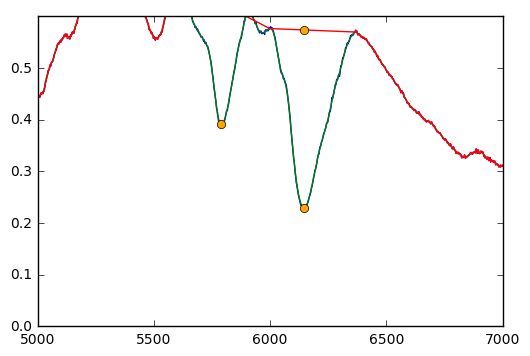

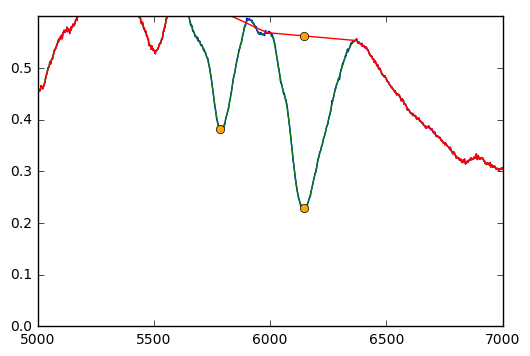

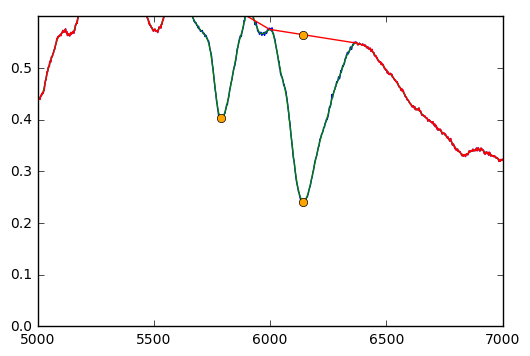

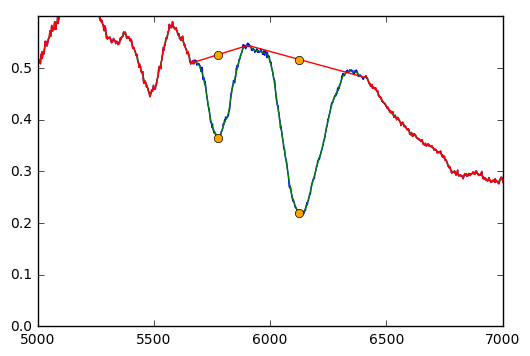

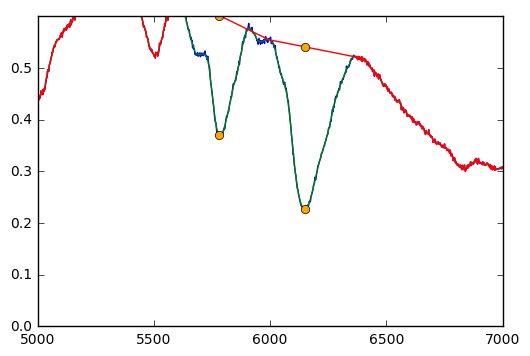

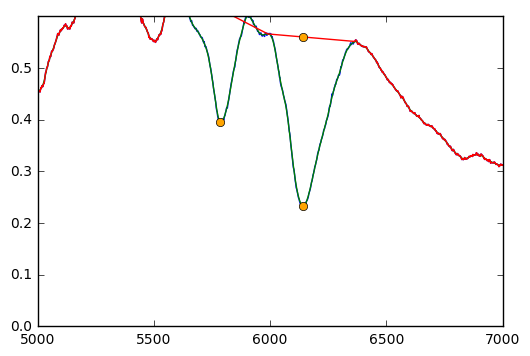

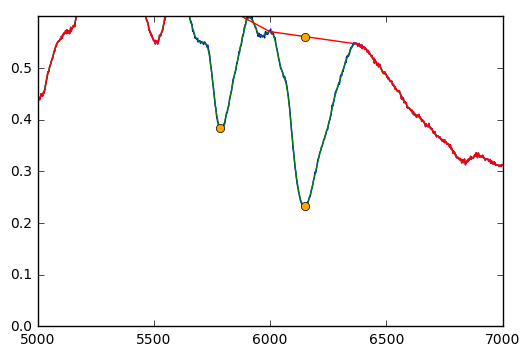

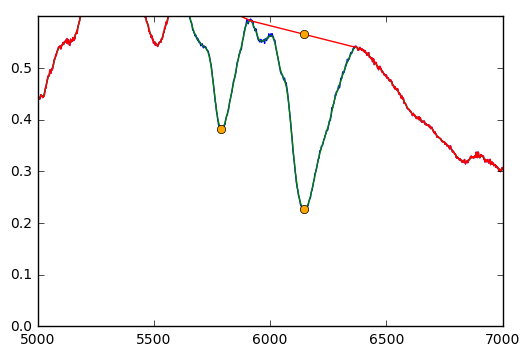

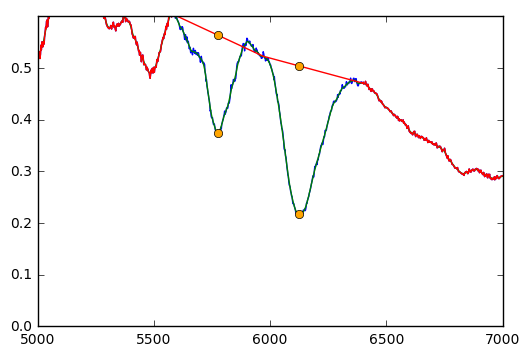

Could not find maximum in a specified range!


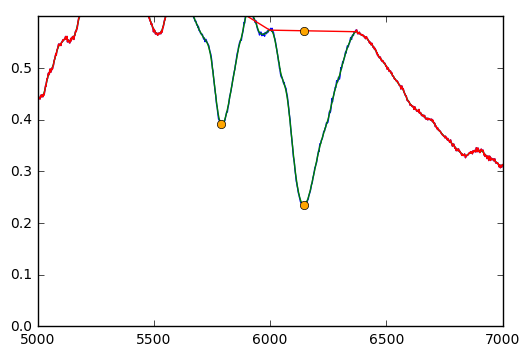

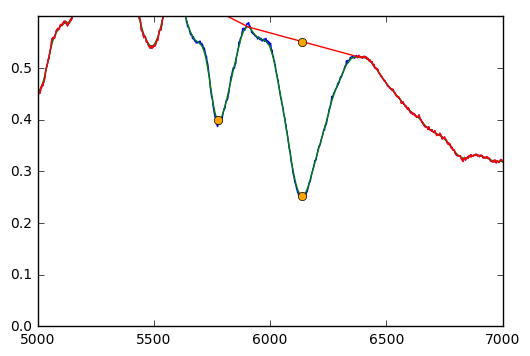

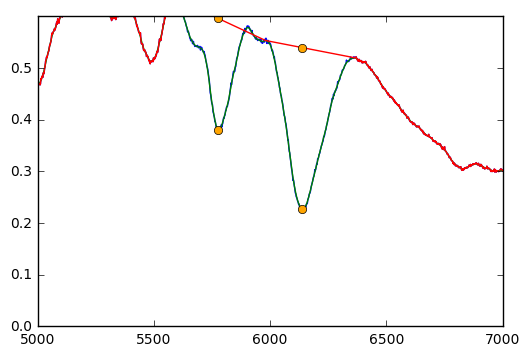

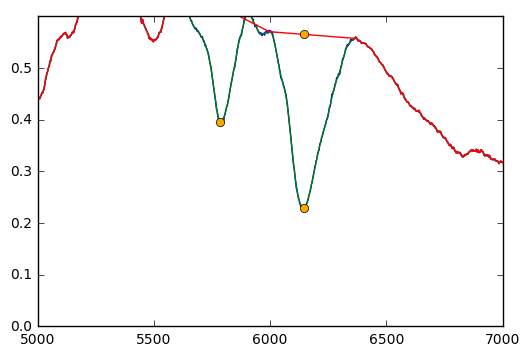

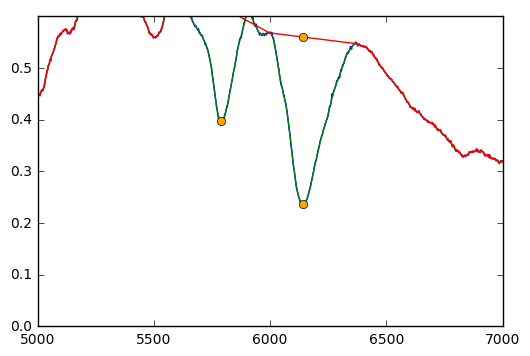

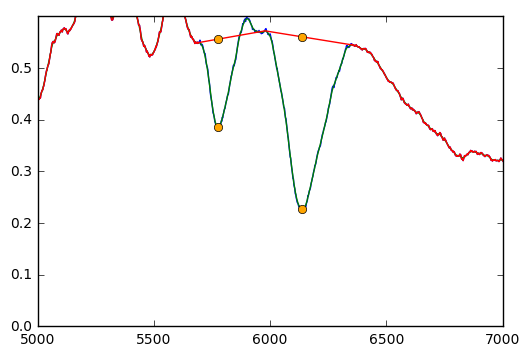

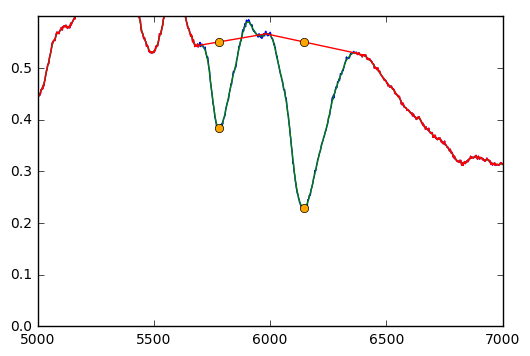

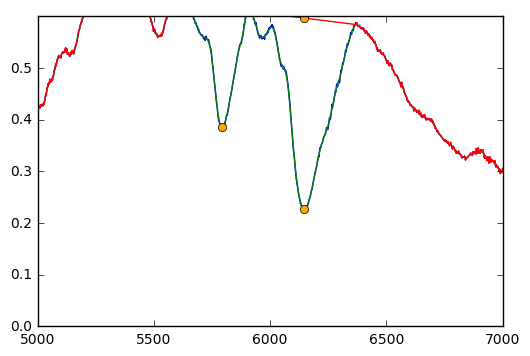

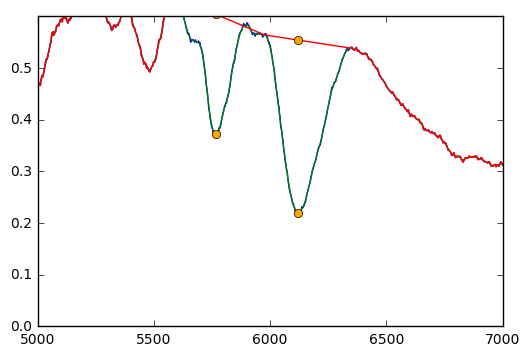

In [10]:
boot_ratios_mean = []
errors_mean  = []
percentile = erf(1/np.sqrt(2.))
low_pc = 0.5 - percentile*0.5
up_pc = 0.5 + percentile*0.5
# for k in range(len(boot_sn_arrays[0:27])):
for k in range(len(boot_sn_arrays_mean)):
    rs = []
    print k
    for comp in boot_sn_arrays_mean[k]:
        r = sa.measure_si_ratio(comp.wavelength[comp.x1:comp.x2], comp.flux[comp.x1:comp.x2], vexp=.001)
        rs.append(r)
    boot_ratios_mean.append(rs)

In [11]:
low_errors = []
up_errors = []
boot_resids = []
boot_ratios_med = np.asarray(boot_ratios_med)
for j in range(len(boot_ratios_med)):
    r_resids = []
    r_resids.append(boot_ratios_med[j] - si_ratios_med[j])
    resid_sort = np.sort(r_resids)[0]
    boot_resids.append(resid_sort)
    low_ind = np.round((len(resid_sort)-1) * low_pc).astype(int)
    up_ind = np.round((len(resid_sort)-1) * up_pc).astype(int)
    low_errors.append(np.absolute(resid_sort[low_ind]))
    up_errors.append(resid_sort[up_ind])
#     errors.append(np.nanstd(rs))
errors_med = [low_errors, up_errors]

In [12]:
low_errors = []
up_errors = []
boot_resids = []
boot_ratios_mean = np.asarray(boot_ratios_mean)
for j in range(len(boot_ratios_mean)):
    r_resids = []
    r_resids.append(boot_ratios_mean[j] - si_ratios_mean[j])
    resid_sort = np.sort(r_resids)[0]
    boot_resids.append(resid_sort)
    low_ind = np.round((len(resid_sort)-1) * low_pc).astype(int)
    up_ind = np.round((len(resid_sort)-1) * up_pc).astype(int)
    low_errors.append(np.absolute(resid_sort[low_ind]))
    up_errors.append(resid_sort[up_ind])
#     errors.append(np.nanstd(rs))
errors_mean = [low_errors, up_errors]

0
0.108735254629 49906.3078189


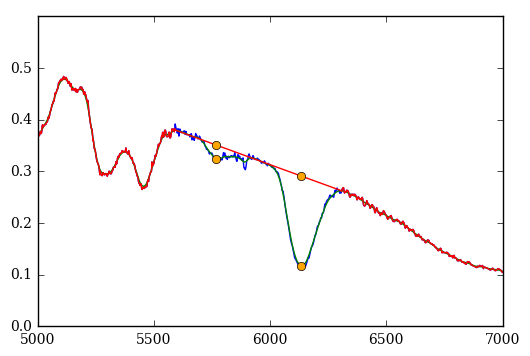

sn1994s-19940616-uoi.flm 0.94 0.150563600161 Check:  0.002 44.108454218 34.8971198257
0.15039162148 15914.1853919


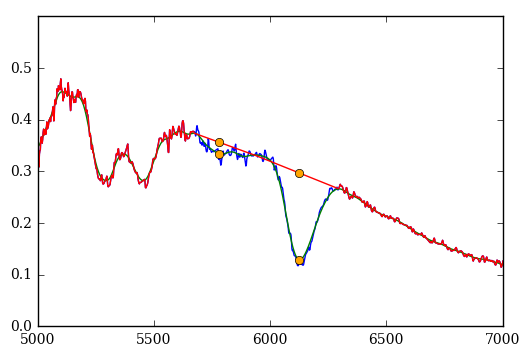

sn2001cp-20010629-ui.flm 0.88 0.141073306323 Check:  0.003 26.9489929139 24.0178237234
0.166296157413 37928.0070049


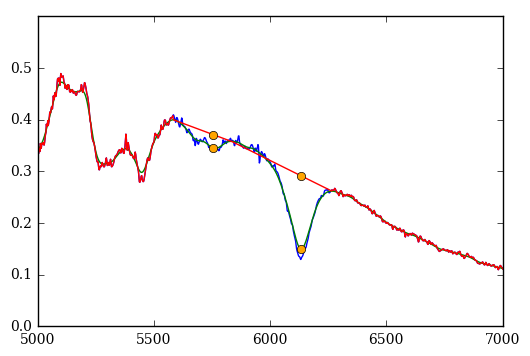

sn2001eh-20010920-ui.flm 0.92 0.183596952007 Check:  0.003 39.2962066953 36.9819602524
0.123404213228 50950.5979188


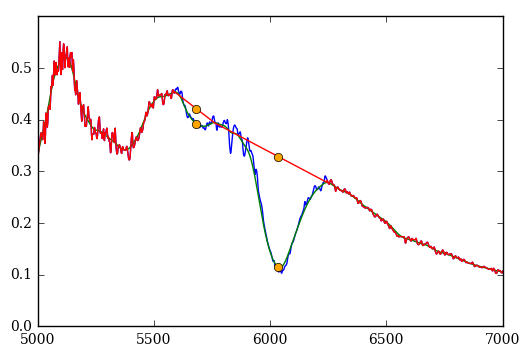

sn2002cd-20020420-ui-corrected.flm 0.84 0.134645232713 Check:  0.003 26.7352331325 23.7964870723
0.144118547989 38111.5119087


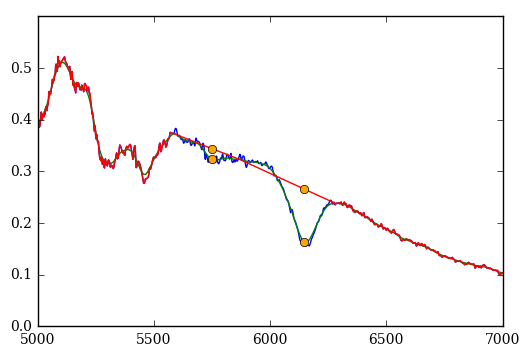

sn2005eq-20051011.376-ui-corrected.flm 0.88 0.196885386064 Check:  0.003 38.7252292231 37.8569772533
0.151817843188 4045.42933808


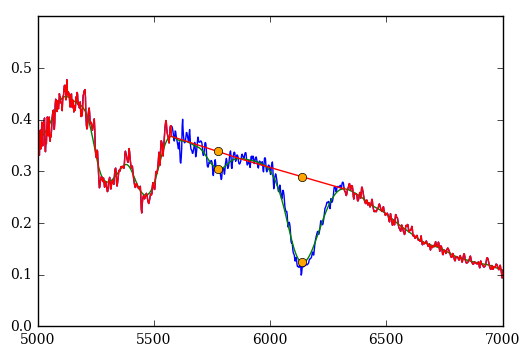

sn2006cq-20060605.307-ui.flm 0.912911227475 0.199788741151 Check:  0.004 14.353644905 11.4517795753
0.269478705881 27919.6370958


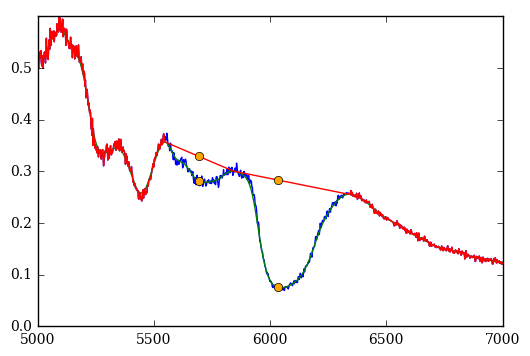

sn2006ot-20061123.362-br.flm 0.84 0.229708862548 Check:  0.003 35.3139458216 35.3768439715
0.15125224976 8121.19252146


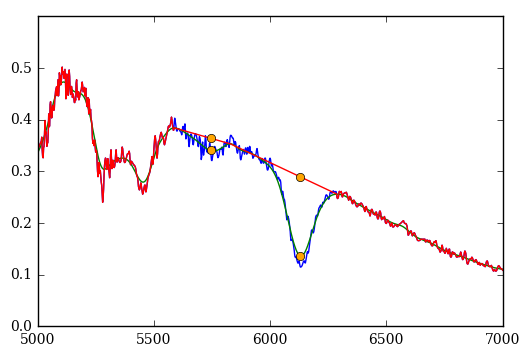

sn2006s-20060206.517-ui.flm 0.93 0.155179081759 Check:  0.004 17.9416369811 14.4997537352
0.340682653992 8403.38640746


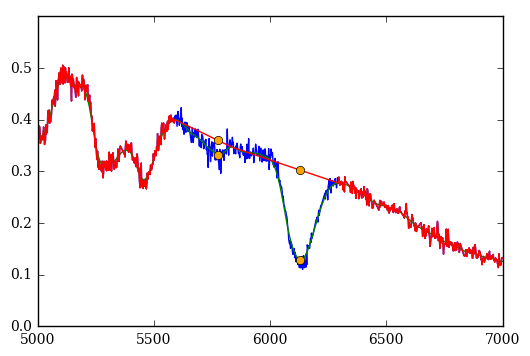

sn1996C-19960217.48-fast.flm 0.93 0.162643740987 Check:  0.003 26.6613154023 27.3132541144
0.346622758261 15373.3243817


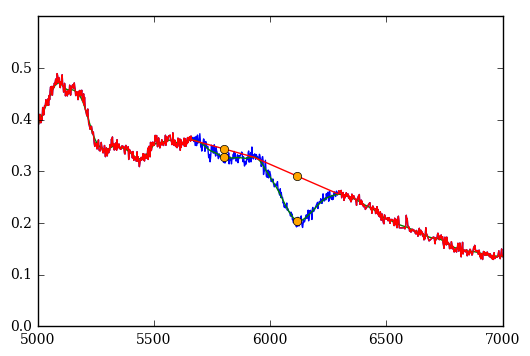

sn1999gp-20000105.10-fast.flm 0.87 0.188734024676 Check:  0.003 38.1051314067 33.6958139173
0.307843234845 79795.9795854


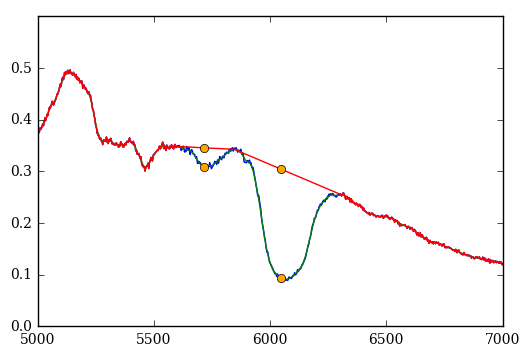

sn2001ay-20010426.41-mmt.flm 0.68 0.177906510663 Check:  0.0015 68.7142368323 70.6392952709
0.343255283642 13436.2439252


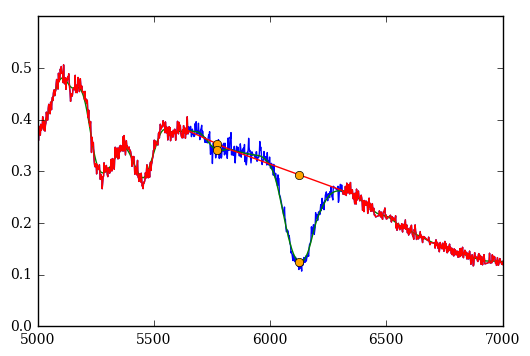

sn2002jy-20021226.12-fast.flm 0.88 0.0741311444358 Check:  0.003 34.2228922881 31.1301164169
0.329521916104 6330.69309892


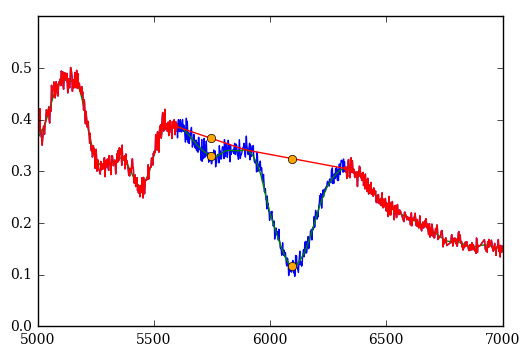

sn2004as-20040319.28-fast.flm 0.92 0.166821815939 Check:  0.003 25.5573856655 25.3622106076
0.342349229308 11758.6951432


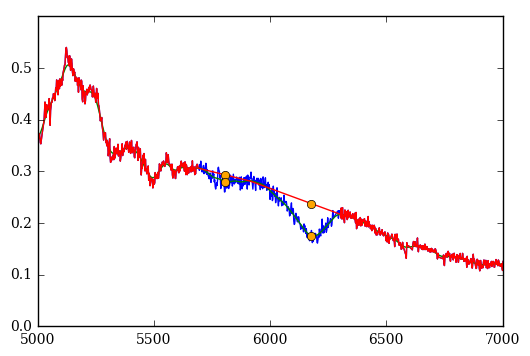

sn2005M-20050202.34-fast.flm 0.87 0.217692133069 Check:  0.003 33.4405206956 31.6824353629
0.391134216719 949.303707677


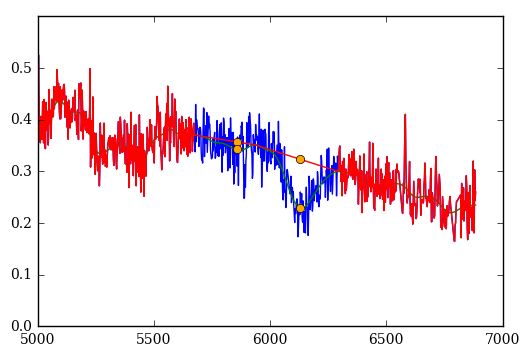

sn2006cj-20060522.29-fast.flm 0.81 0.156918245272 Check:  0.004 10.8020549342 11.127962287
0.342426999227 2750.80633496
Could not find maximum in a specified range!
sn2006gr-20061002.26-fast.flm 0.81 nan Check:  0.004 16.958007168 13.8261860644
0.374827012457 1575.84604808


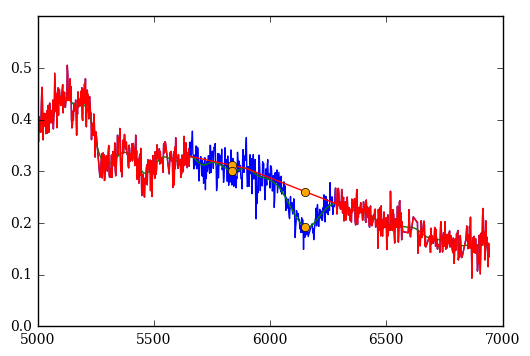

sn2006oa-20061125.08-fast.flm 0.89 0.166327342122 Check:  0.004 13.6833468975 12.6130547741
0.190676965224 8794.36616413


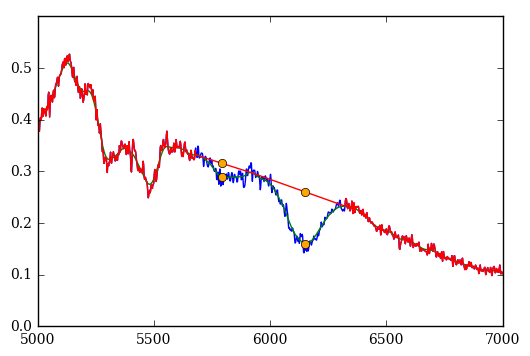

SN07ai_070314_b01_DUP_BC.dat 0.909922433992 0.269525525947 Check:  0.003 20.2532134442 19.4959683076
0.172985484225 42085.3042507


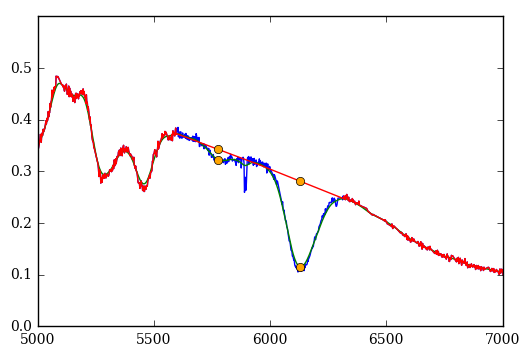

SN07ca_070508_b01_BAA_IM.dat 0.89 0.121392915814 Check:  0.003 34.4860504796 31.5813058497
0.0879314191662 678.710522245
Could not find maximum in a specified range!
sn1990n-19900709.730-iue.flm 0.88901820492 nan Check:  0.004 6.06533470112 2.76657365879
0.129832093295 1454.26399275
Could not find maximum in a specified range!
sn1991t-19910427.424-iue.flm 0.831468991816 nan Check:  0.004 10.7644824332 5.82981887025
1
0.147285415594 206775.424463


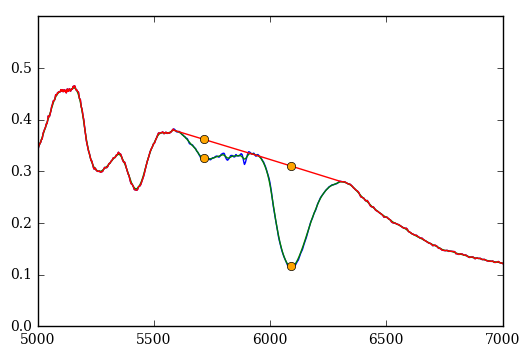

sn1998dk-19980831-ui.flm 1.05 0.188599507145 Check:  0.0015 84.9128723603 70.6132013702
0.136029004287 35559.9363727


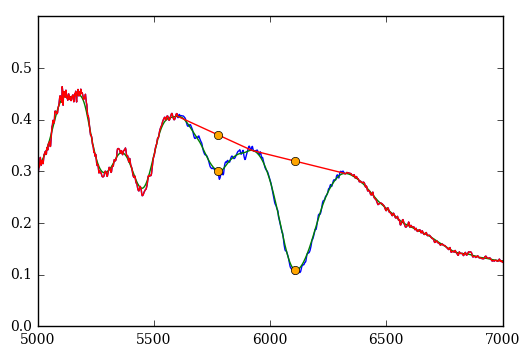

sn2001da-20010716-ui-corrected.flm 1.12 0.331981658166 Check:  0.003 36.596435247 30.0099081637
0.143148670948 150510.637785


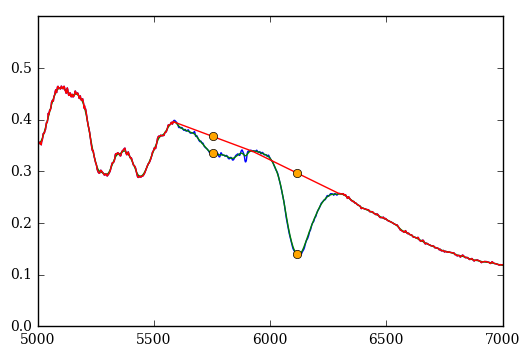

sn2001fe-20011115-ui.flm 1.0 0.210080582977 Check:  0.0015 71.2092899877 63.0968901259
0.125321984192 62052.7593228


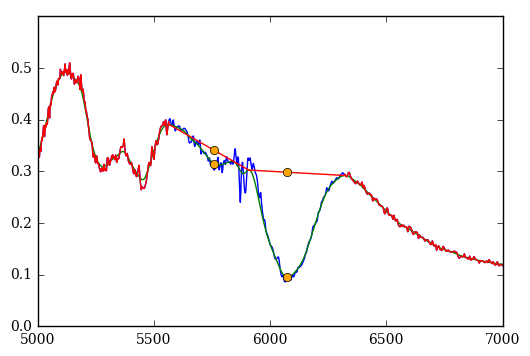

sn2002bo-20020322-ui-corrected.flm 1.08 0.129535009201 Check:  0.003 31.380745317 27.2745675657
0.145279182559 2246.4127888


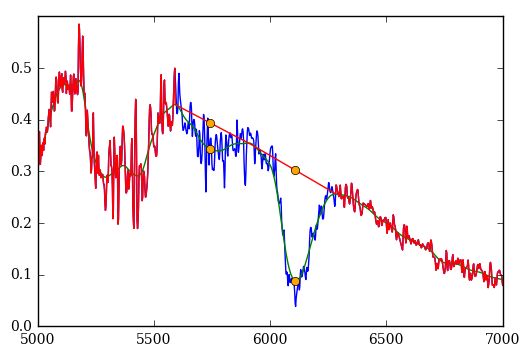

sn2002de-20020608.374-ui-corrected.flm 0.96 0.239454640812 Check:  0.004 10.5824122859 7.9496540894
0.130217751749 114766.945543


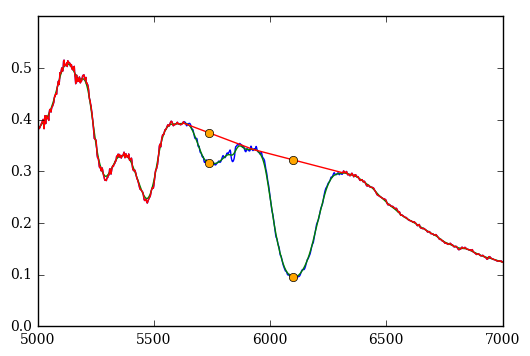

sn2004fu-20041119-ui.flm 1.08 0.258354807932 Check:  0.002 51.7778217197 45.3537215501
0.260137046431 1170.6335616


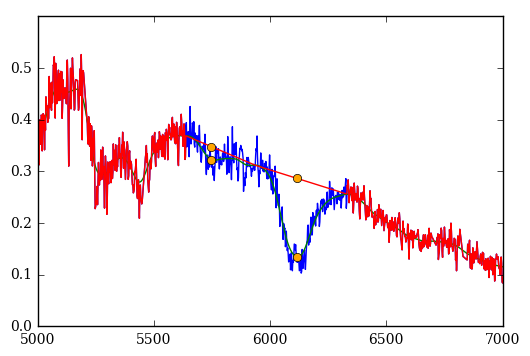

sn2005ag-20050212.596-br.flm 1.01576626674 0.165812347888 Check:  0.004 9.81647815021 10.1685695344
0.177651919982 34381.7816956


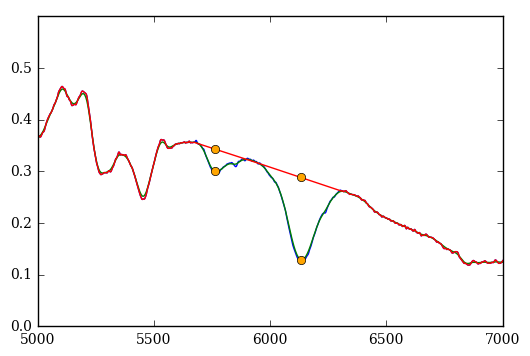

sn2005cf-20050610.7-uvot.flm 1.1 0.268627001342 Check:  0.002 58.0080515331 25.8392814942
0.146663221716 6045.42401547


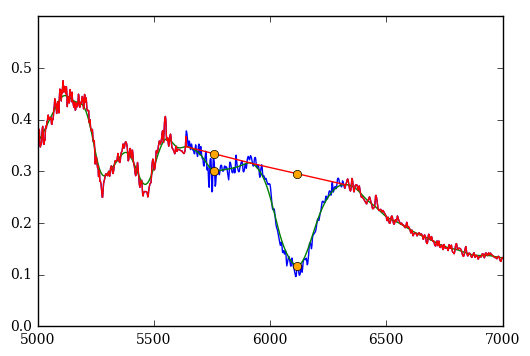

sn2005ms-20060106.400-ui.flm 0.977959604108 0.183359454525 Check:  0.004 18.0026236712 16.6601127349
0.136087300168 12493.4880147


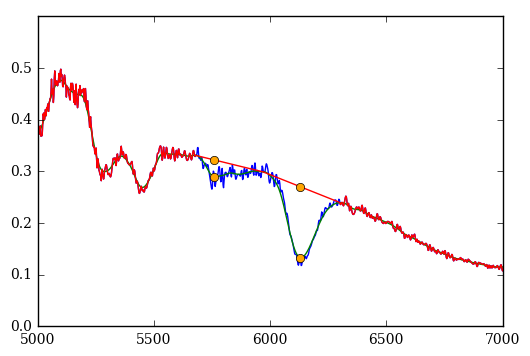

sn2005na-20060105.335-ui.flm 1.09 0.240614149568 Check:  0.003 24.9128017218 23.8296042949
0.160268811979 75508.6713102


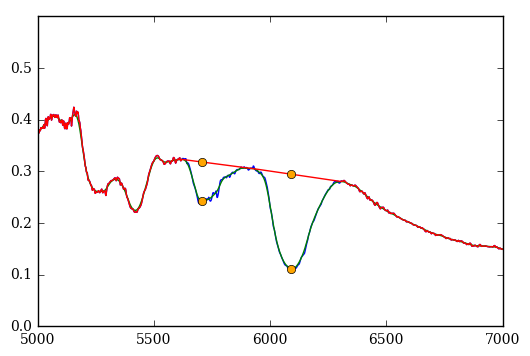

sn2006ej-20060824.430-ui.flm 1.10653932926 0.41443268191 Check:  0.002 55.6145389318 49.431223132
0.153866784575 17103.2821012
Could not find maximum in a specified range!
sn2006or-20061201.530-ui.flm 1.0351558298 nan Check:  0.003 23.1081230957 19.7406001455
0.250045089954 105872.043216


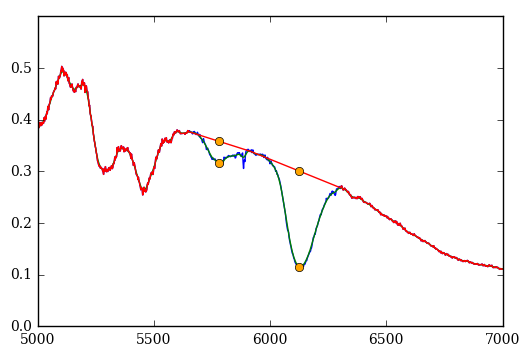

sn2007a-20070113.208-br.flm 0.95 0.228140011932 Check:  0.0015 70.2622804558 66.6691522711
0.133222726348 134406.434584


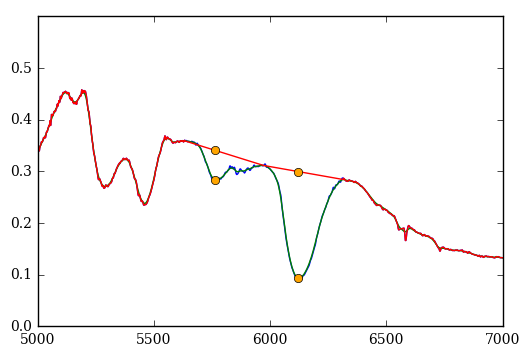

sn2007af-20070313.545-ui-corrected.flm 1.04 0.274592881813 Check:  0.0015 70.1572927361 62.682927791
0.14828755242 18823.5532608


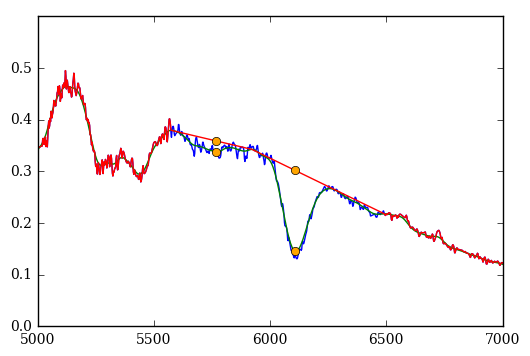

sn2007bz-20070426.419-ui.flm 1.05 0.137765584962 Check:  0.003 24.1770570331 23.2078944384
0.140428153326 89049.2394019


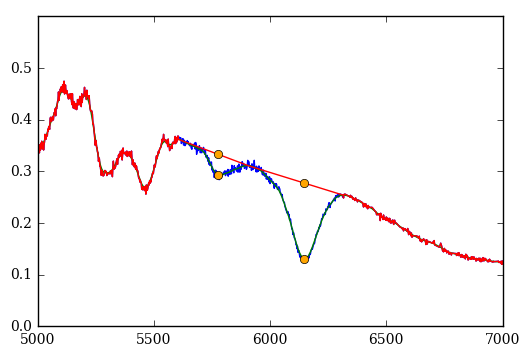

sn2007o-20070122.663-deimos.flm 1.08812276376 0.271433843449 Check:  0.002 42.5465874738 42.7383273579
0.360357554333 238207.266267


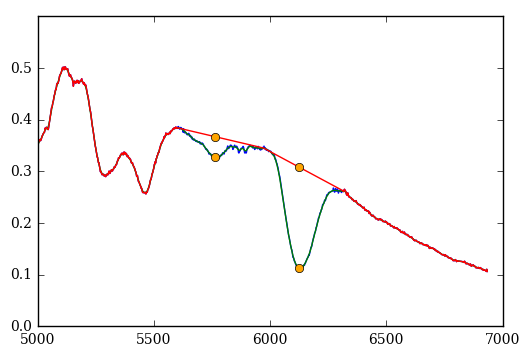

sn1994ae-19941201.50-fast.flm 0.96 0.205950910147 Check:  0.001 152.85048008 150.102991241
0.423004111891 188.883039684


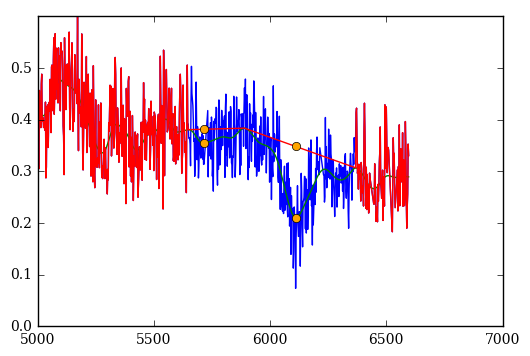

sn1996ab-19960522.37-fast.flm 1.01 0.198666179269 Check:  0.004 5.46165849377 5.13550481345
0.324455848155 4427.08231702


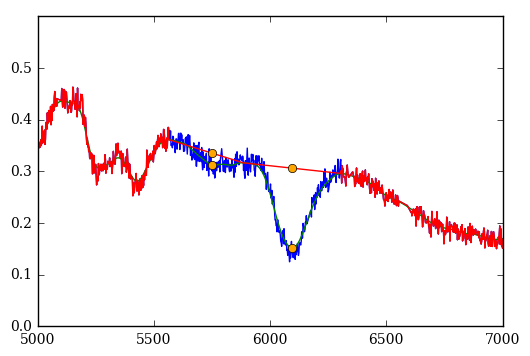

sn1996bl-19961018.18-fast.flm 1.07 0.144532058572 Check:  0.004 18.8698812552 20.0727335243
0.317560557736 56892.3941647


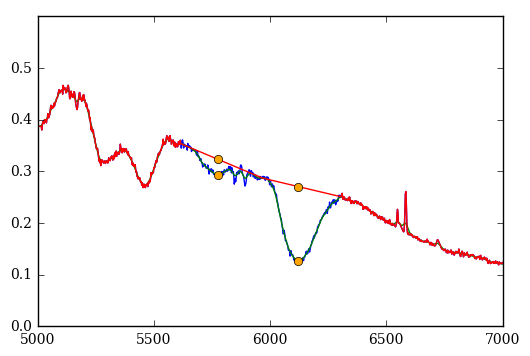

sn1997dt-19971204.11-fast.flm 1.04 0.21622165496 Check:  0.0015 65.3782786646 56.9668367955
0.321987364481 304130.794585


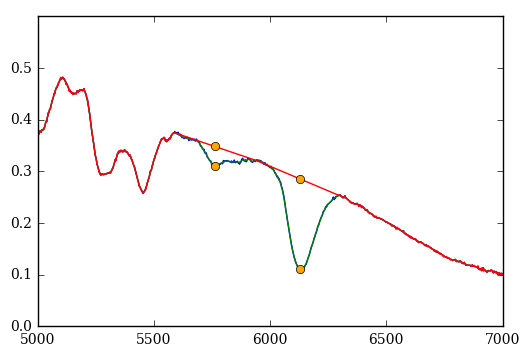

sn1998aq-19980429.26-fast.flm 1.11 0.212330018136 Check:  0.001 157.015316945 161.199075666
0.314024865406 270359.269218


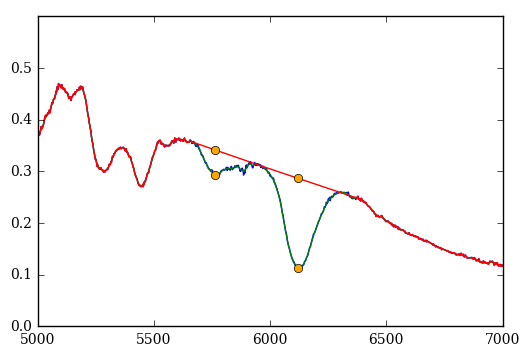

sn1998bu-19980517.15-fast.flm 1.03 0.278206806262 Check:  0.001 143.770177556 137.136179272
0.326983103157 11912.3791085


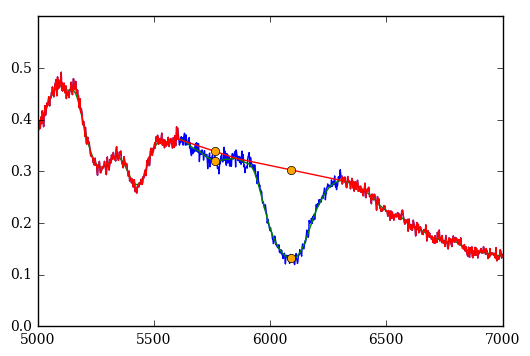

sn1998ec-19980930.50-fast.flm 1.08 0.104896362044 Check:  0.003 30.8806134778 25.4049698217
0.328289728601 21471.3762782


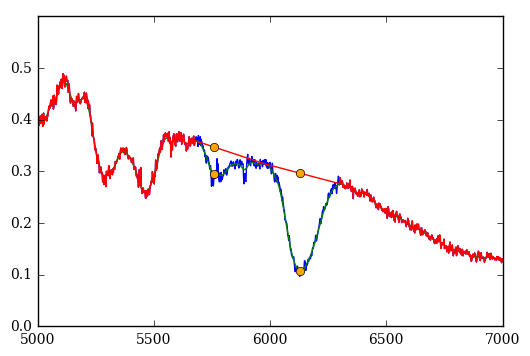

sn1998eg-19981024.15-fast.flm 1.14 0.280634138417 Check:  0.002 44.4481300998 32.3460405034
0.334544982198 32434.0422713


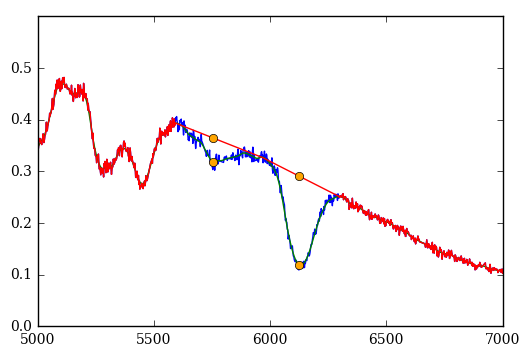

sn1998V-19980319.51-fast.flm 0.99 0.273034876894 Check:  0.002 52.4083872177 30.4713646656
0.329190411342 5568.97851737


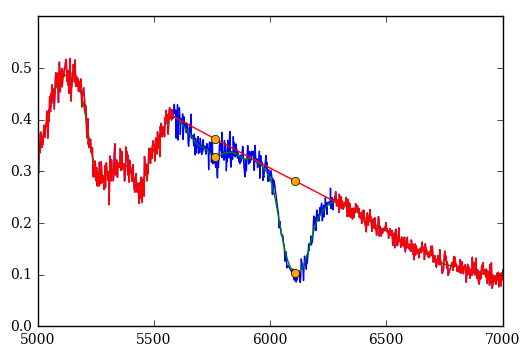

sn2000fa-20001215.36-fast.flm 1.0 0.201894816908 Check:  0.003 20.4377679367 17.7816354784
0.360061231368 2982.60110816


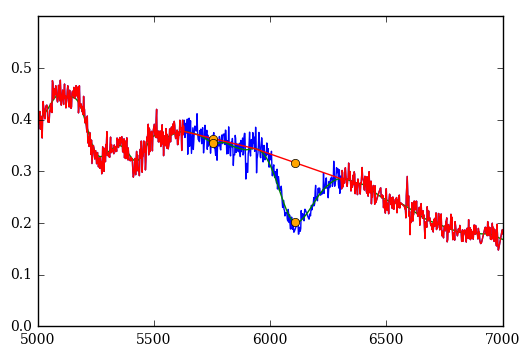

sn2001az-20010430.40-fast.flm 1.09 0.0710124154586 Check:  0.004 18.487355749 18.7353829132
0.337493042361 32998.9190979


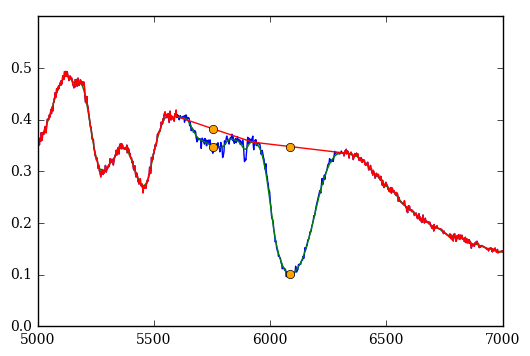

sn2001en-20011011.39-fast.flm 1.12 0.139403420337 Check:  0.002 53.7271899192 48.5003119433
0.339721219704 3626.15167117


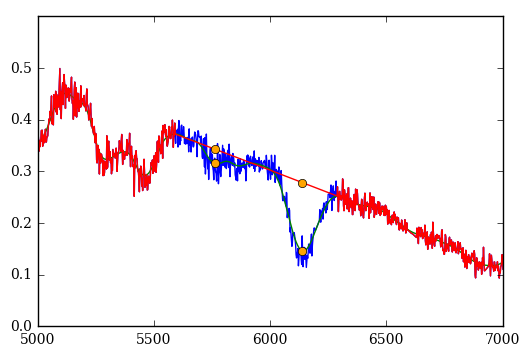

sn2002ck-20020502.46-fast.flm 1.08 0.210884191695 Check:  0.004 17.638269652 14.1023856776
0.31382035436 460620.430871


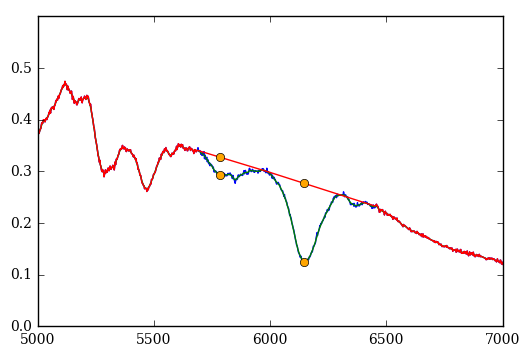

sn2002fk-20020929.44-fast.flm 1.13 0.232191504606 Check:  0.001 189.725434276 178.698803338
0.333672004852 2090.66081068


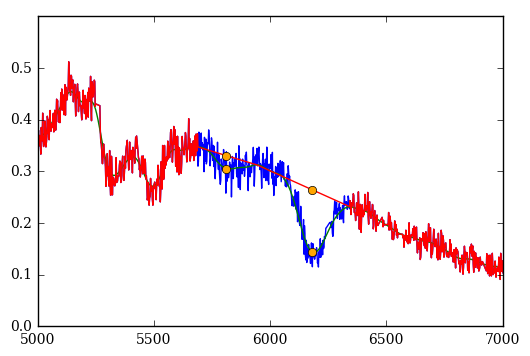

sn2002hu-20021113.25-fast.flm 1.05 0.209955501847 Check:  0.004 13.4532077265 12.5387071627
0.173077026033 176329.639398


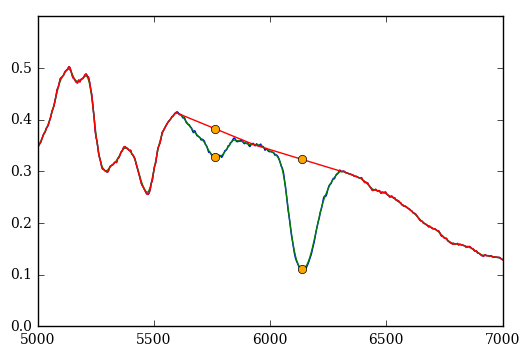

2003du_20030510_3203_10000_00.dat 1.07 0.254352637915 Check:  0.0015 89.1182039706 75.812414459
0.327141349231 18164.9502983


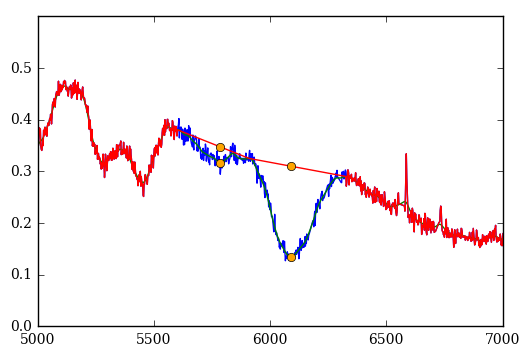

sn2003kc-20031203.49-fast.flm 1.1265951925 0.176369243977 Check:  0.002 41.3478357829 40.1915612511
0.327217722112 5992.50194869


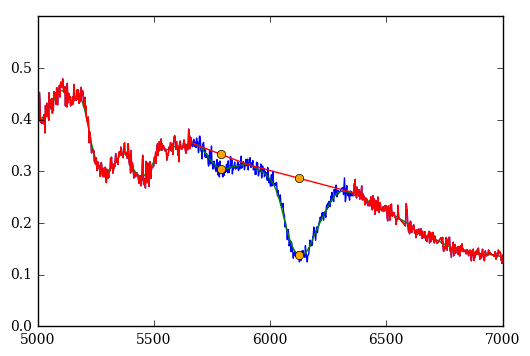

sn2004bg-20040411.39-fast.flm 1.05 0.192707922461 Check:  0.003 22.2426656805 22.2354183098
0.190526098922 93429.8317241


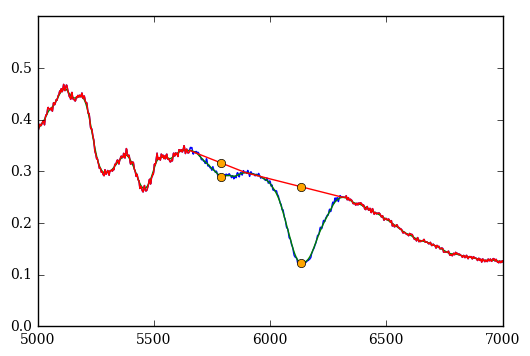

SN06ax_060330_b01_DUP_WF.dat 1.06 0.177672124534 Check:  0.002 57.6087495722 58.502090858
0.361135546562 5689.66179752


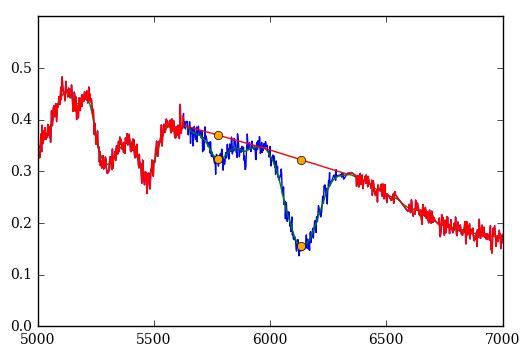

sn2006cf-20060519.25-fast.flm 1.04621465431 0.275472604427 Check:  0.003 25.2179676333 25.8546360074
0.360985259402 1083.47140876


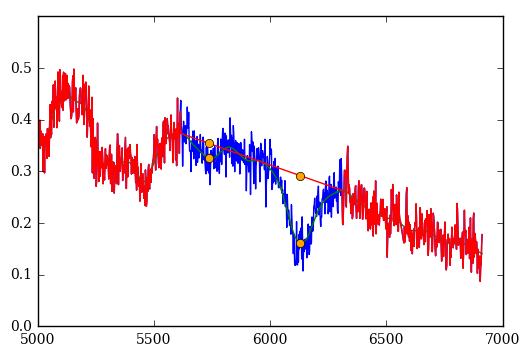

sn2007ae-20070225.54-fast.flm 0.98 0.222733271573 Check:  0.004 10.5587110727 9.77849625348
0.345515387361 10795.8707463


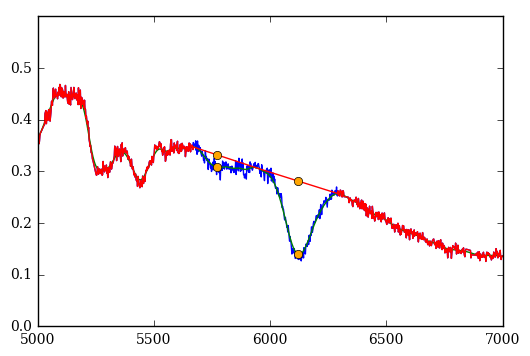

sn2007F-20070121.55-fast.flm 0.96 0.170683914499 Check:  0.003 31.2583890049 30.2675970235
0.113183220756 22627.9590925


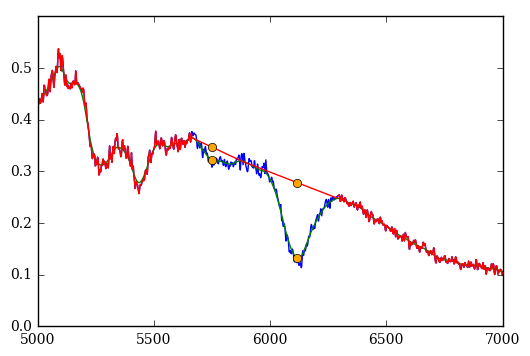

SN08bf_080328_g01_NTT_EM.dat 1.05 0.171768379688 Check:  0.003 21.7063970099 19.0359605452
0.241343723838 10450.4387856


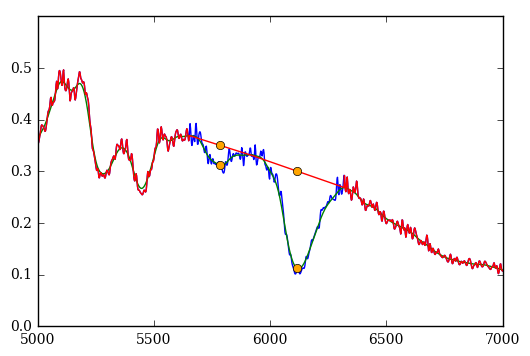

SN04ey_041025_b01_CLA_LD.dat 0.969286867038 0.203937995844 Check:  0.003 23.6978315044 23.7352288876
0.223232035768 37475.6499177


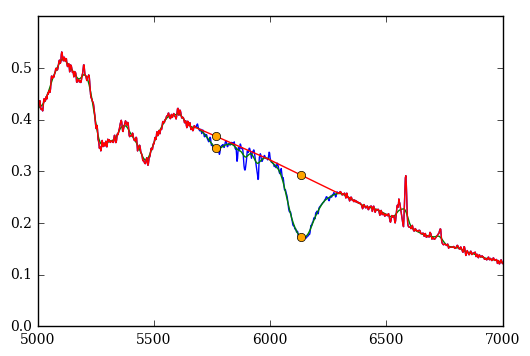

SN05bg_050412_b01_DUP_WF.dat 1.03952997066 0.193571811856 Check:  0.002 41.4114603038 37.5352772006
0.357299154992 7546.1780131


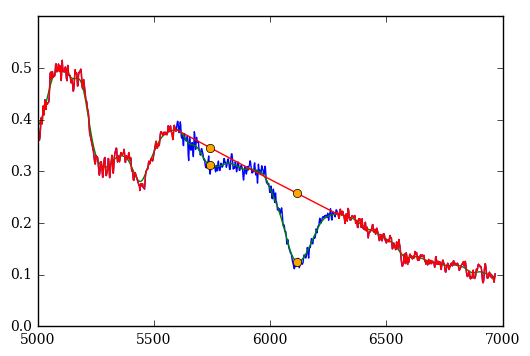

SN05hc_051024_b01_MGH_BC.dat 1.03 0.257325679082 Check:  0.003 27.1091903438 26.8404829147
0.383650357237 2117.60465648


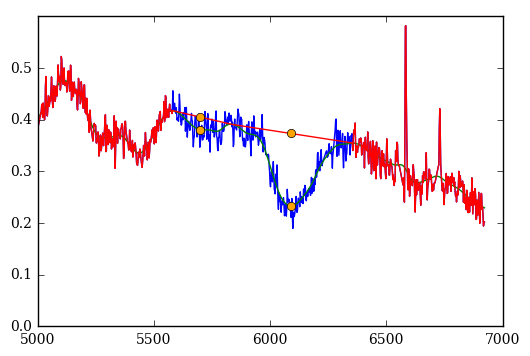

SN05ku_051125_b01_DUP_MS.dat 1.00775438382 0.173445850432 Check:  0.004 16.1167900249 17.5414206001
0.260512807808 7936.65144647


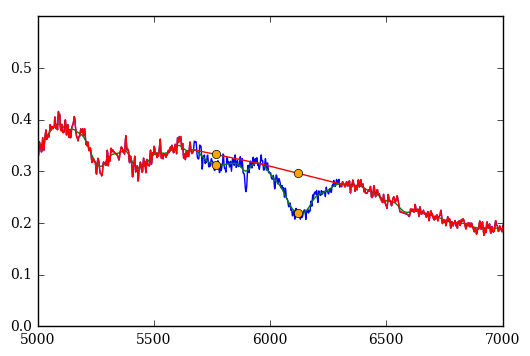

SN06hx_061010_b01_DUP_WF.dat 1.02323762266 0.275582324878 Check:  0.003 23.8190496382 24.9195403231
0.199578393289 5111.79065904


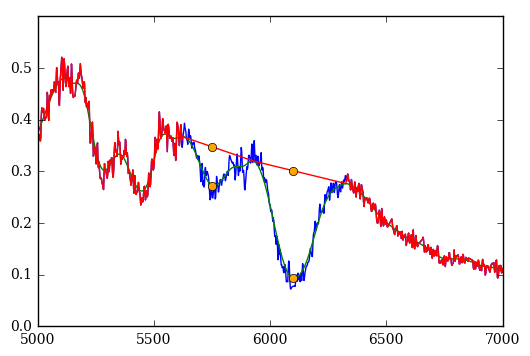

SN06os_061122_b01_DUP_WF.dat 1.06693926911 0.359456133383 Check:  0.004 13.5455057747 13.9284910072
0.19675166623 27219.083877


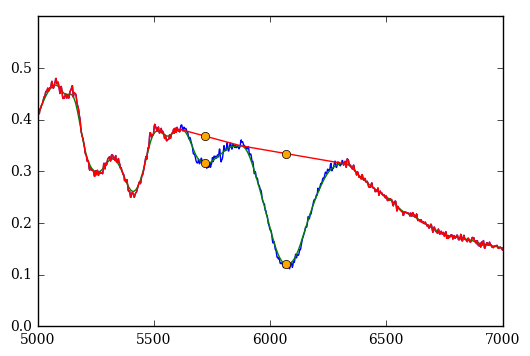

SN07as_070319_b01_DUP_BC.dat 1.09592874297 0.245141612265 Check:  0.003 39.930239501 39.7347234703
0.214256895866 26911.8495379


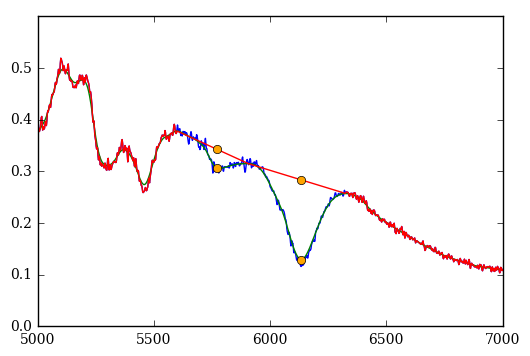

SN08bq_080407_b01_DUP_WF.dat 0.960815049016 0.234566737672 Check:  0.003 34.8817940974 36.1758382662
0.199941659769 200705.198946


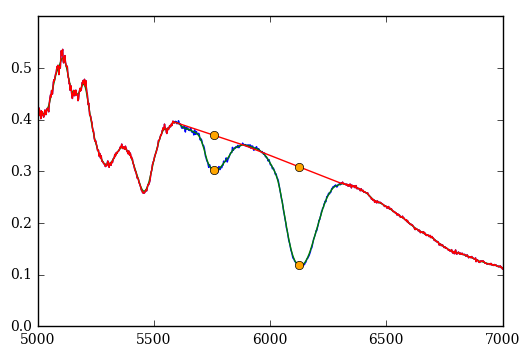

SN08hv_081218_b02_CLA_LD.dat 1.11901047681 0.355892341803 Check:  0.0015 62.4433430082 54.0657963049
0.110514040795 96.8192982834
Could not find maximum in a specified range!
sn1980n-19801213.495-iue.flm 1.11653732682 nan Check:  0.0045 2.46497839279 1.59238801376
0.173949291298 93.249175419
Could not find maximum in a specified range!
sn1981b-19810311.597-iue.flm 1.02793813584 nan Check:  0.0045 1.99339540125 1.92151779492
0.462337430297 12363.0708691
Could not find maximum in a specified range!
sn2001ba-20010508.791-hst.flm 1.01502222659 nan Check:  0.002 56.3314714057 53.5376442057
2
0.113860835646 136558.746321


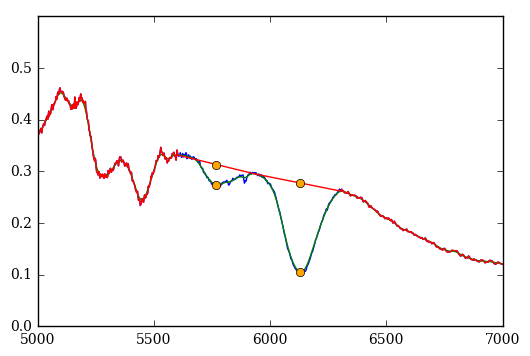

sn1995e-19950224-uoi2.flm 1.16 0.230233329742 Check:  0.002 49.7752903544 44.325356664
0.193745960083 42123.9446276


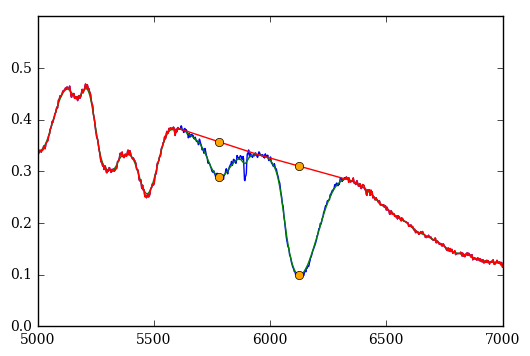

sn1997y-19970209-uohp.flm 1.15 0.318945743154 Check:  0.002 47.5264767336 44.230493937
0.138543191085 197133.015892


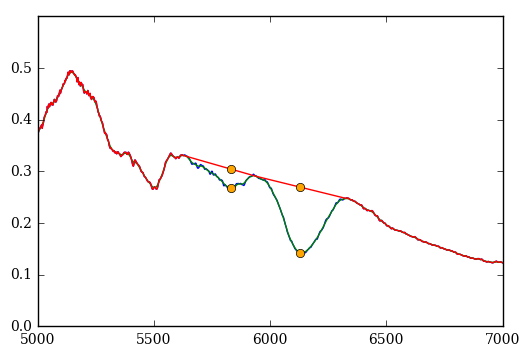

sn1999ac-19990312-ui-corrected.flm 1.23 0.291905087216 Check:  0.0015 77.5684586272 66.9161014359
0.125097145793 148795.610256


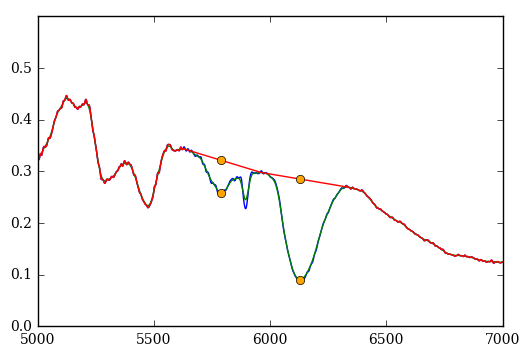

sn1999gd-19991205-uvoir.flm 1.18 0.330130962976 Check:  0.0015 69.8320445122 65.3296710526
0.151063725266 82308.6491019


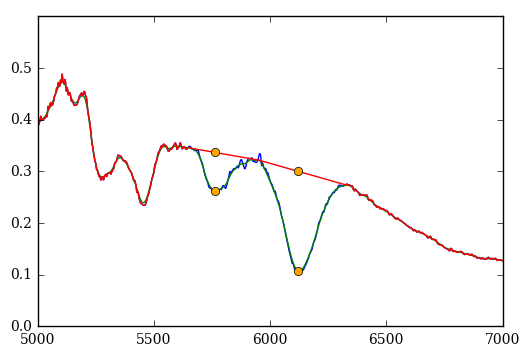

sn2002ha-20021102-ui-corrected.flm 1.22 0.385892390782 Check:  0.002 57.4558979852 48.9404969523
0.166941184096 8063.39554061


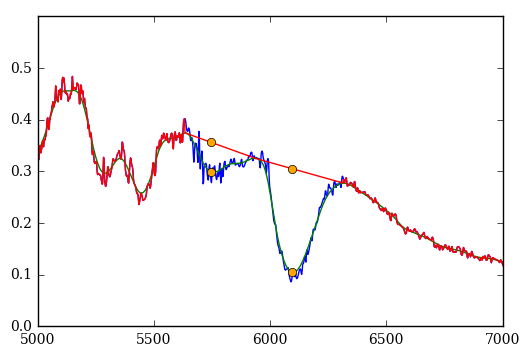

sn2003cq-20030408-ui.flm 1.2 0.282341195738 Check:  0.004 19.5823729041 15.7476139398
0.0838832457552 154.224015392


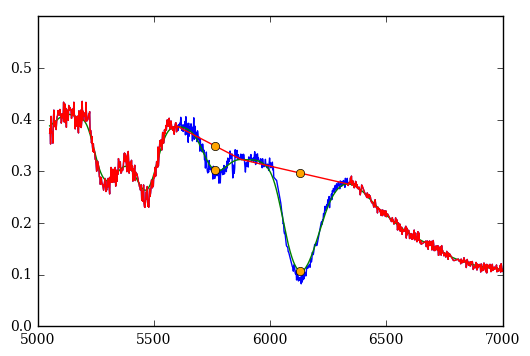

sn2005w-20050211.200-br.flm 1.2292580542 0.247645292863 Check:  0.0045 1.51992033197 0.955228
0.156066495284 43892.1286285


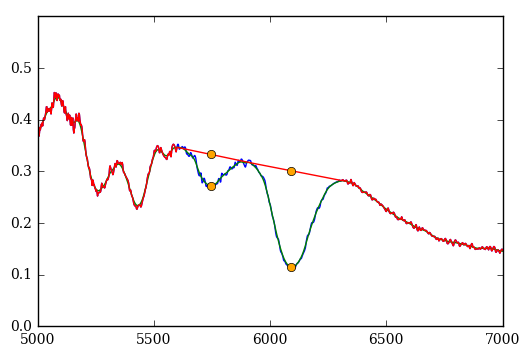

sn2006sr-20061220.097-ui.flm 1.24 0.326268979982 Check:  0.002 41.2758838412 38.6421198907
0.133171881215 53897.0117097


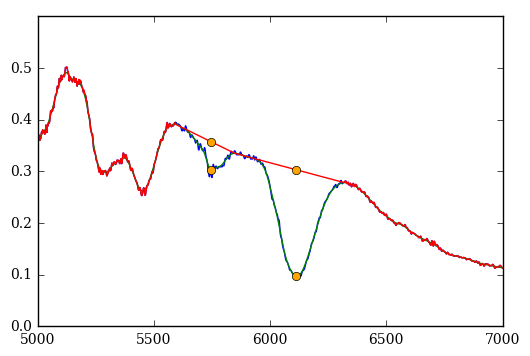

sn2007co-20070614.468-ui-corrected.flm 1.16 0.264028711736 Check:  0.002 42.9219793152 40.524617158
0.316270044627 60085.841374


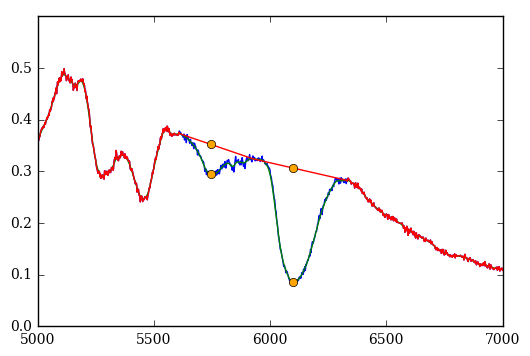

sn1998dh-19980804.36-fast.flm 1.17 0.260665351823 Check:  0.0015 67.2191417556 58.8004615819
0.331140768786 6741.91622375


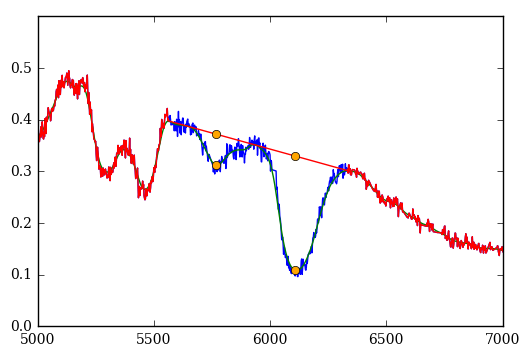

sn2001gb-20011122.50-fast.flm 1.15593128033 0.272649831807 Check:  0.003 24.4282756293 23.5406512326
0.299599097212 84734.0169194


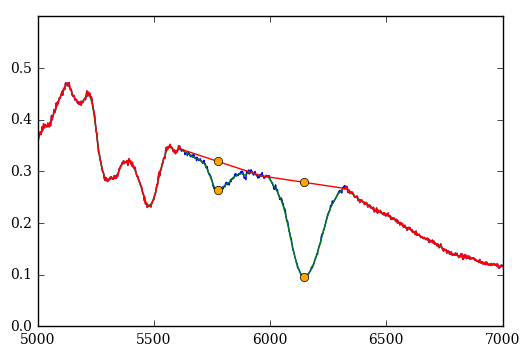

sn2002cr-20020515.28-fast.flm 1.19 0.309000154592 Check:  0.0015 78.3322928996 77.3222473254
0.31599949514 21282.0868007


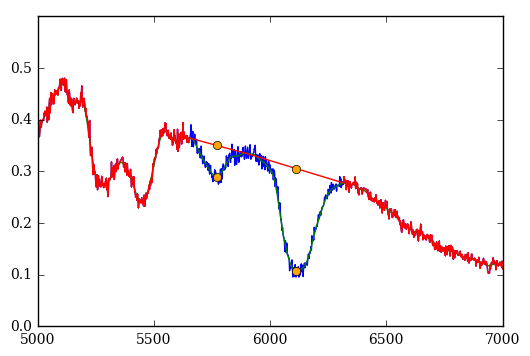

sn2002kf-20021231.34-fast.flm 1.2 0.30674664005 Check:  0.002 41.5448476077 31.8967736134
0.309127512569 11221.3555915


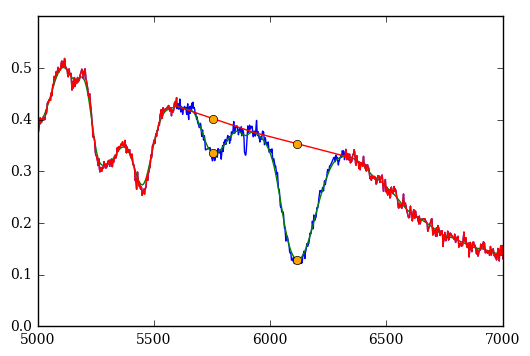

sn2003ch-20030329.11-mmt.flm 1.22 0.298469296802 Check:  0.003 30.9461085324 28.8381350326
0.361734578368 1396.55669103


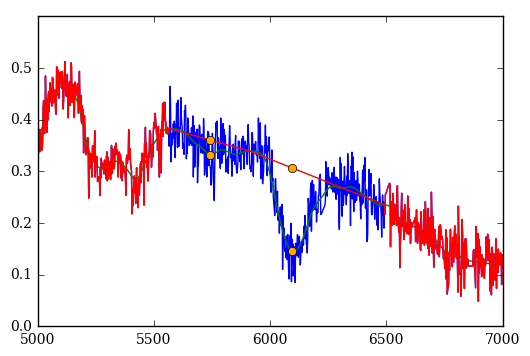

sn2003ic-20030921.36-fast.flm 1.20279024729 0.177817306599 Check:  0.004 12.6893852666 11.8373131267
0.211035107547 4237.47350729


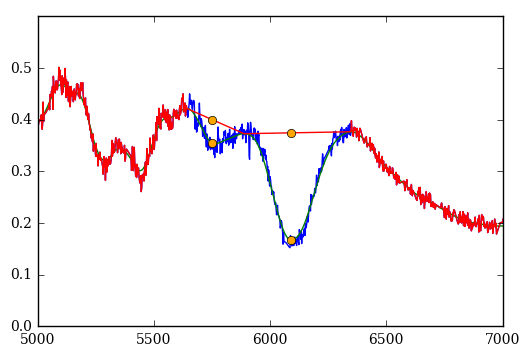

SN07jg_070922_b01_CLA_LD.dat 1.17 0.219196285893 Check:  0.004 16.6336327336 17.4357299818
0.304345971032 22805.8096695


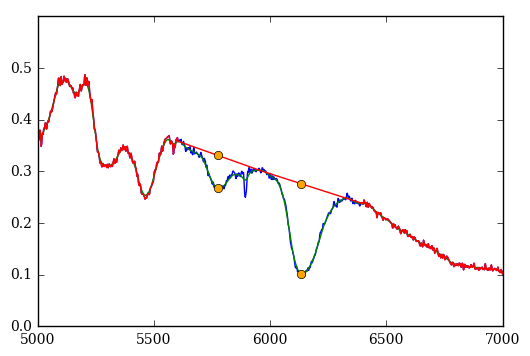

SN05kc_051125_b01_DUP_MS.dat 1.24 0.357676239892 Check:  0.002 44.7069325442 44.736357905
0.160361368336 75224.8678683


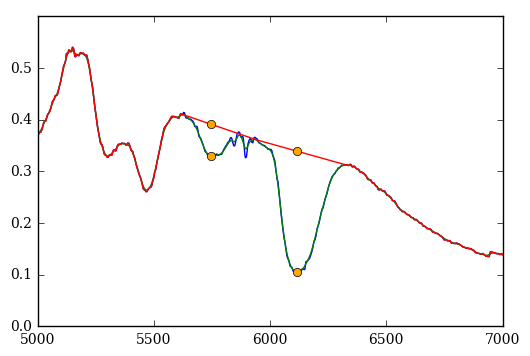

2002er_20020910_3209_9997_00.dat 1.23 0.264616368658 Check:  0.0015 74.3603541316 68.2099143412
3
0.13795480506 126462.913923


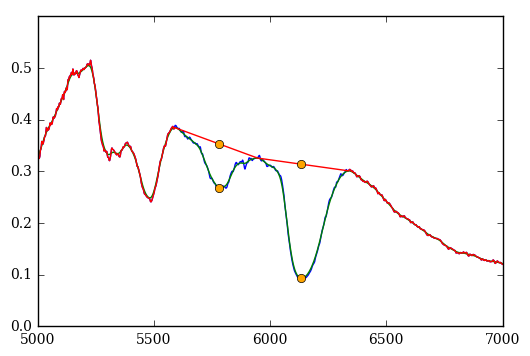

sn2001ep-20011020-ui-corrected.flm 1.3 0.383431888432 Check:  0.002 58.4877971414 50.8449098727
0.190056438201 13099.8606404


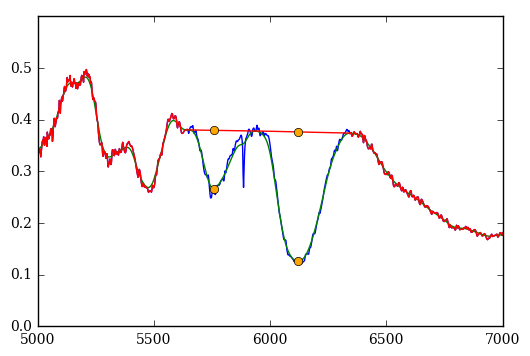

sn2004gs-20041217.447-ui-corrected.flm 1.41 0.451377883965 Check:  0.003 31.0240298068 28.3734591732
0.234089255613 126319.51776


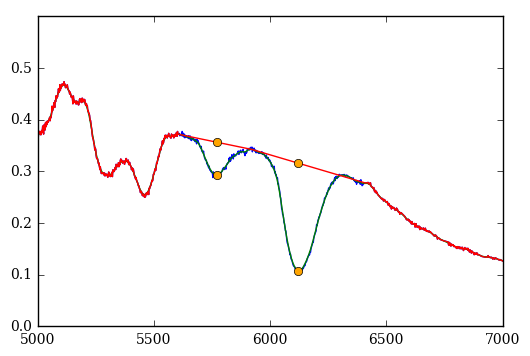

sn2005ki-20051202.649-deimos.flm 1.41 0.306636536667 Check:  0.0015 70.3109013054 69.6995974072
0.110192546316 26345.4468883


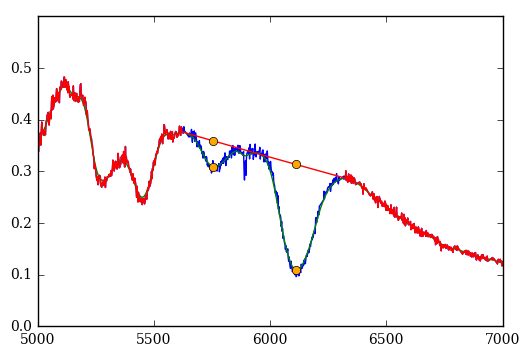

sn2005lz-20060101.381-deimos.flm 1.34 0.245190316218 Check:  0.003 23.9686369628 22.438944213
0.127563367675 143933.203255


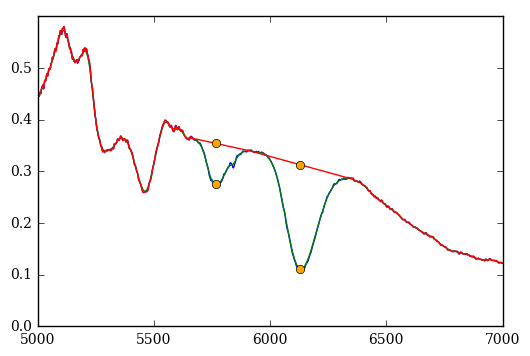

sn2006d-20060124.435-ui.flm 1.35 0.390575944138 Check:  0.0015 69.5310177044 62.424259281
0.118583422033 72378.1103335


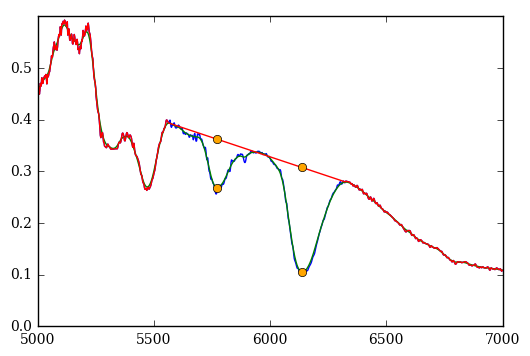

sn2007bc-20070410.323-ui-corrected.flm 1.37 0.466876590485 Check:  0.002 45.7890786639 40.8042361928
0.251344006036 71112.6156824


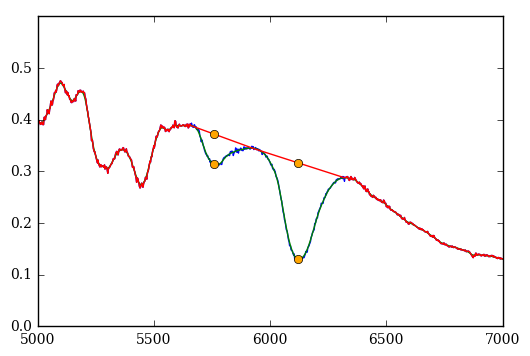

1994D_19940319_3402_9132_00.dat 1.37 0.313812272632 Check:  0.0015 71.6096560945 74.5912276722
0.332975276625 3761.27058523


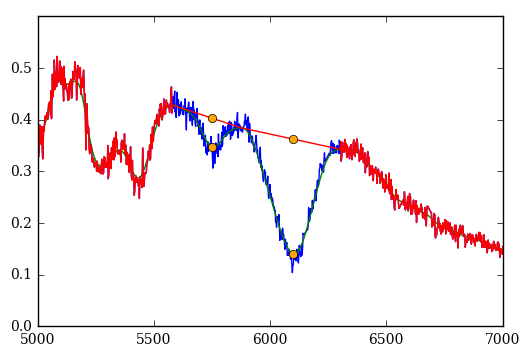

sn1994M-19940504.15-fast.flm 1.26 0.2506384245 Check:  0.004 14.9058336361 13.8602235972
0.128455362404 292215.320404


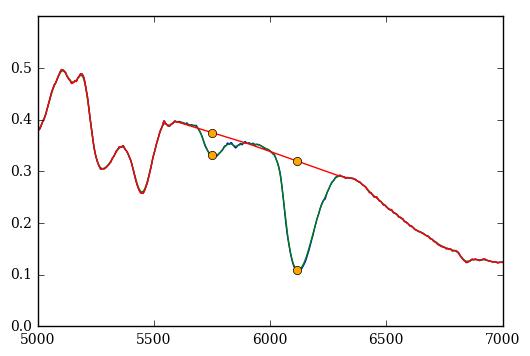

1996X_19960419_3077_10669_00.dat 1.26 0.209203800713 Check:  0.0015 96.2844626234 72.6747082167
0.359787749684 1238.46610621


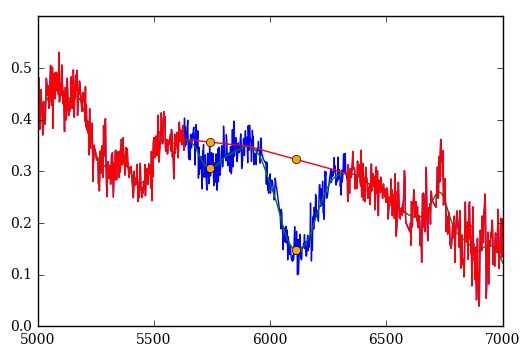

sn1998dx-19980914.18-fast.flm 1.32 0.286205184434 Check:  0.004 11.9952468746 10.9653036298
0.379582658911 14055.5880752


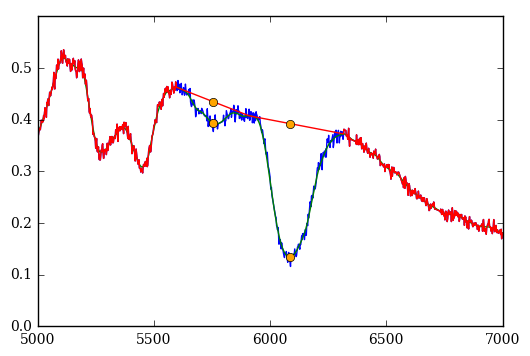

sn1998ef-19981029.31-fast.flm 1.27 0.160641354903 Check:  0.002 40.684776824 34.6262112005
0.349184337587 5224.72861748


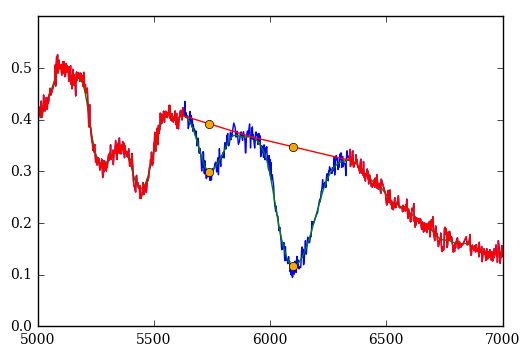

sn1999cc-19990516.34-fast.flm 1.35 0.398343178416 Check:  0.003 23.2388158502 23.2075050712
0.378751730382 1312.29547373


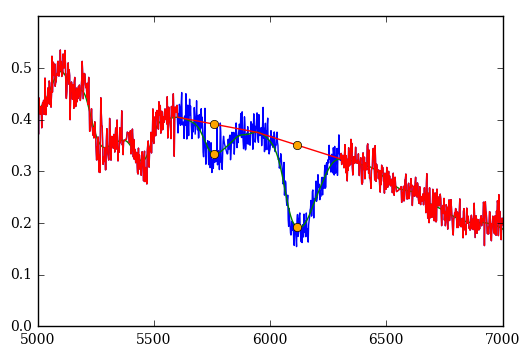

sn2002bz-20020405.37-fast.flm 1.2747935695 0.368280305286 Check:  0.004 12.6303301031 12.362291717
0.339880439772 1809.00222628


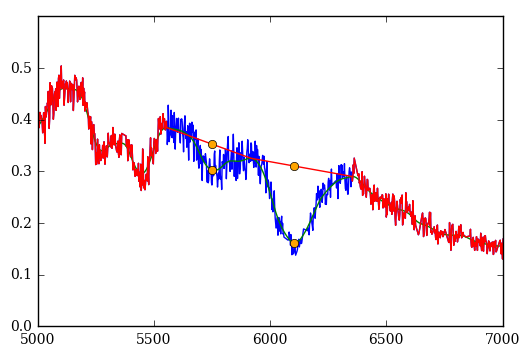

sn2002G-20020122.52-fast.flm 1.25 0.335557613636 Check:  0.004 12.5215238075 12.2192785184
0.170333004628 47781.8775797


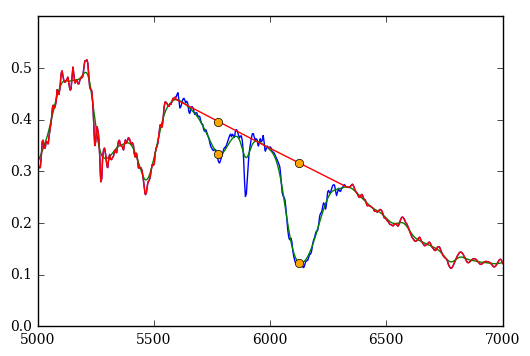

2003cg_20030401_3650_9347_00.dat 1.26 0.325458045901 Check:  0.003 31.505693216 28.619385844
0.351615447893 35276.8664644


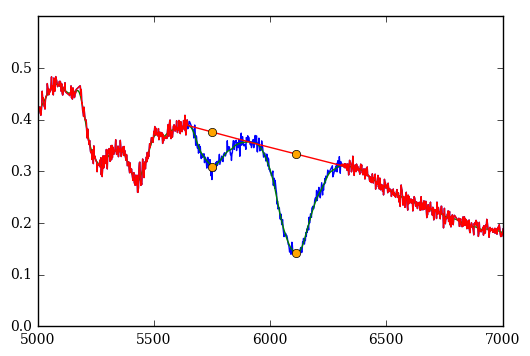

sn2003it-20031020.23-fast.flm 1.36 0.348259663886 Check:  0.002 59.8533513947 50.6117952173
0.273186826764 4153.65806


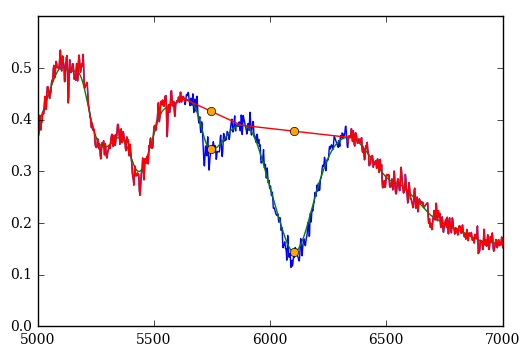

SN04ef_040914_b01_DUP_WF.dat 1.39 0.31384453548 Check:  0.004 18.7346684697 16.9958777651
0.330002162441 9905.77477864


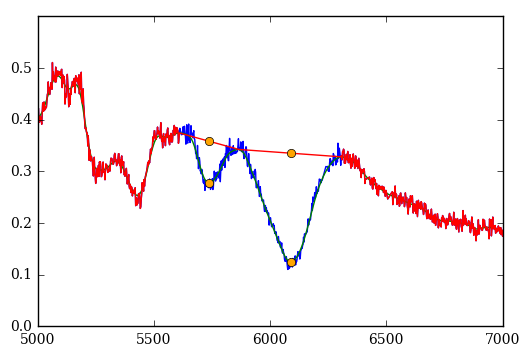

sn2005am-20050303.30-fast.flm 1.3 0.386505300218 Check:  0.003 31.4962827106 28.1181574341
0.208884376149 19457.154706


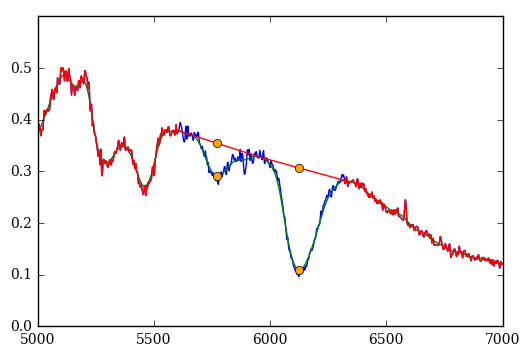

SN05bo_050418_b01_DUP_WF.dat 1.28 0.324627073418 Check:  0.003 28.7220720846 28.2383319009
0.371614285601 4879.99283835


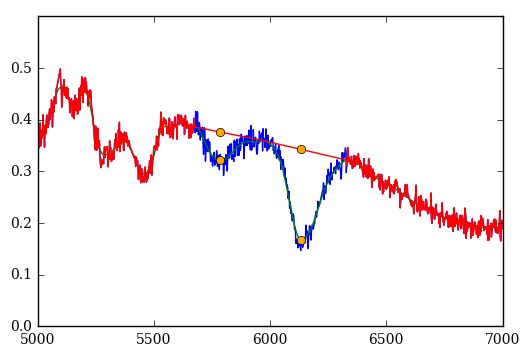

sn2006az-20060331.37-fast.flm 1.29 0.312498601397 Check:  0.003 24.4555525725 24.2208984929
0.234313203253 19688.067643


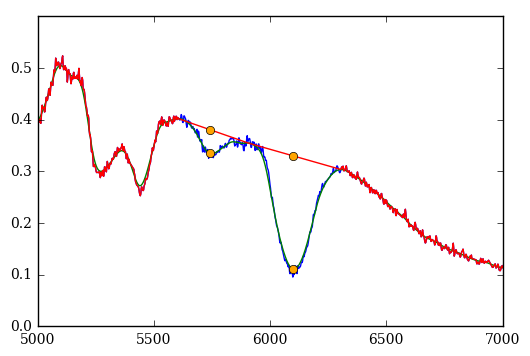

SN07bd_070417_b01_DUP_WF.dat 1.3 0.208327387964 Check:  0.003 34.2362575817 28.1437031822
0.364476885117 1953.73171751


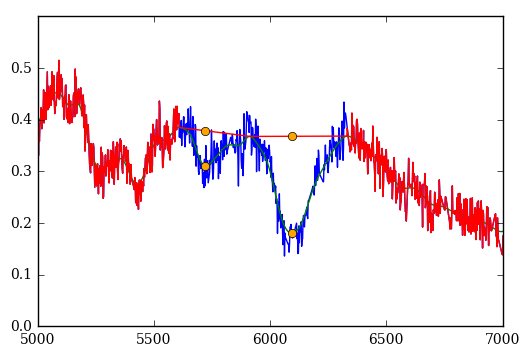

sn2007cp-20070616.17-fast.flm 1.39156314449 0.365694143057 Check:  0.004 15.3218628118 13.9159094292
0.329845905281 4356.66975379


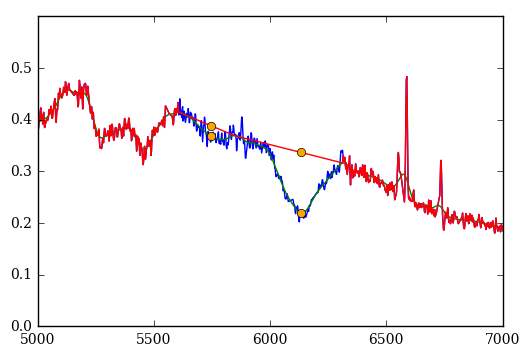

SN06fw_060927_b01_DUP_WF.dat 1.29480152261 0.172377521942 Check:  0.003 21.7497150294 21.9832913011
0.155265036268 756.578355341
Could not find maximum in a specified range!
sn1992a-19920121.574-iue.flm 1.41867253408 nan Check:  0.004 7.44891486037 3.32171273089
4
0.164244209679 182211.200201


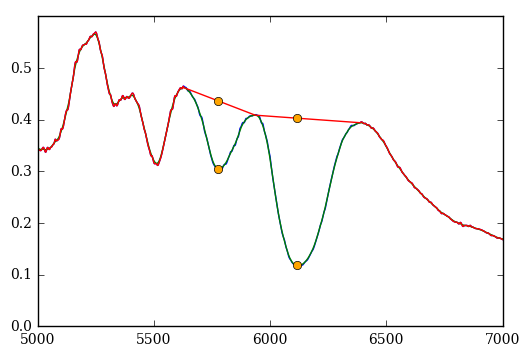

sn1999gh-19991205-uvoir.flm 1.69 0.461577112008 Check:  0.0015 99.7626053984 86.3286277312
0.185607548625 47769.2558297


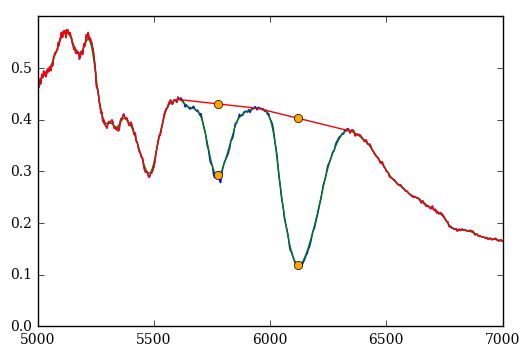

sn2000dk-20000926-ui-corrected.flm 1.62 0.488087997723 Check:  0.002 55.1361421673 46.5582359543
0.327560040184 77240.0183499


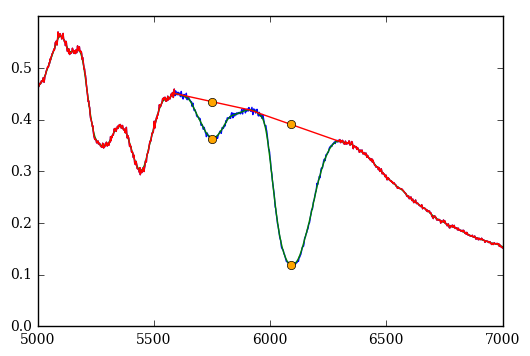

sn2002he-20021108-br.flm 1.44 0.263095238831 Check:  0.0015 73.7951134135 70.9263350618
0.217245931456 13276.9384173


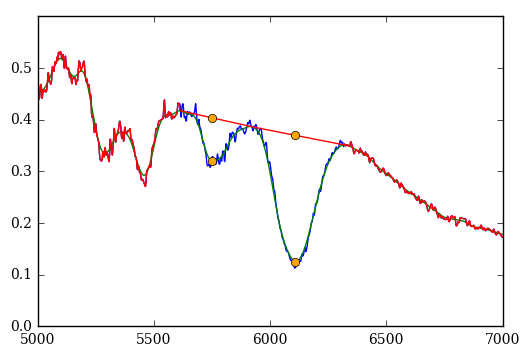

sn2003U-20030204-ui.flm 1.46 0.340418864353 Check:  0.003 31.2827657256 29.2694201484
0.219323623889 2302.83276289


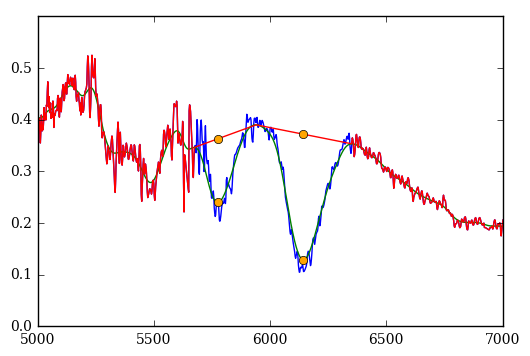

sn2006gt-20060925.348-ui.flm 1.66 0.508307761504 Check:  0.004 14.1992333442 13.2277066775
0.193585908818 46161.9062669


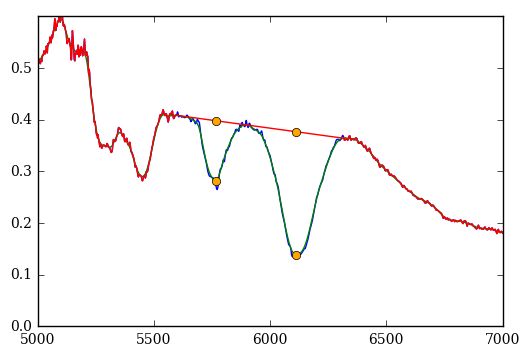

sn2006kf-20061030.385-ui.flm 1.55 0.490333824976 Check:  0.002 50.8172290495 46.137845191
0.193684351879 23599.4893125


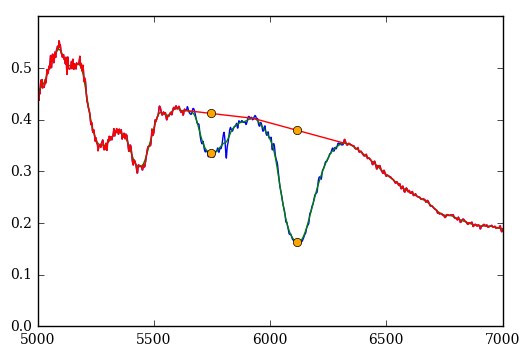

sn2006n-20060123.286-ui.flm 1.5 0.352886917211 Check:  0.002 41.8689607985 36.4972497748
0.176884216016 31190.3195754


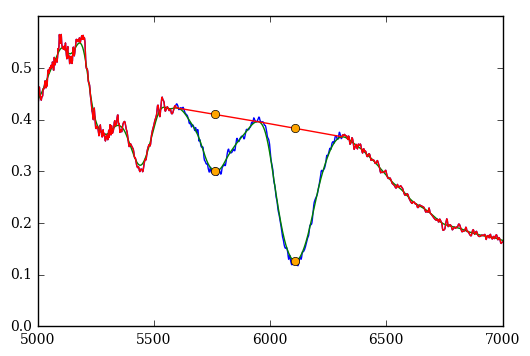

sn2007ci-20070524.264-ui-corrected.flm 1.6 0.425075221514 Check:  0.003 37.0916621558 36.9959617847
0.297383838025 178520.179388


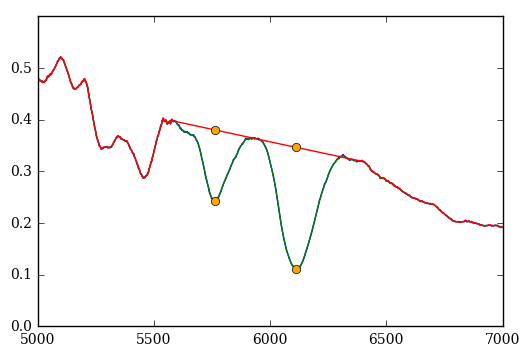

sn2007on-20071112.468-br.flm 1.68116315739 0.582389987815 Check:  0.001 122.586031725 108.709607589
0.355140523069 165.060941627


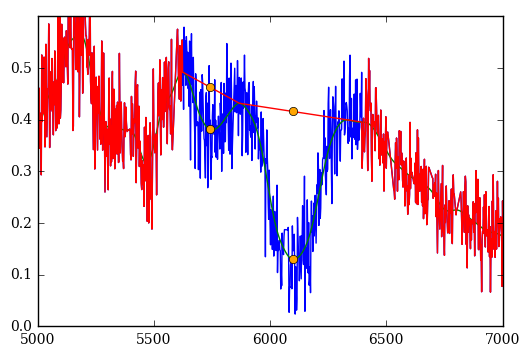

sn1994T-19940612.19-fast.flm 1.51 0.286942746488 Check:  0.0045 4.04000772481 3.62813221224
0.367484989169 21360.5695307


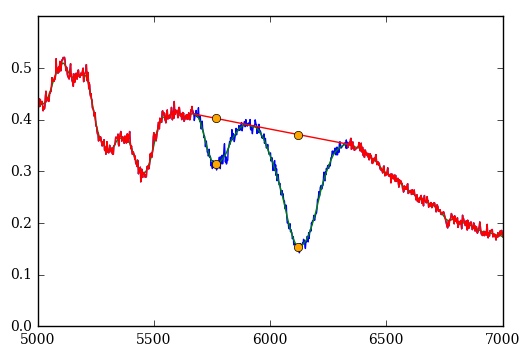

sn1999ej-19991030.28-fast.flm 1.48 0.411570423163 Check:  0.002 48.1134579702 41.0343492423
0.375992468787 53436.9559223


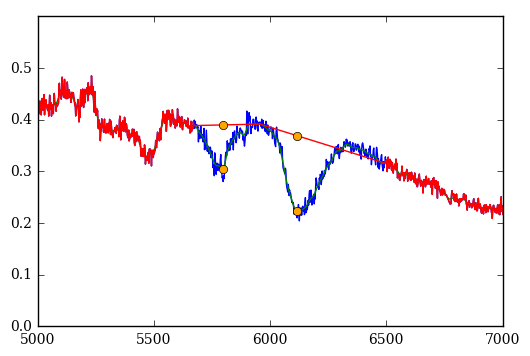

sn2002do-20020619.43-fast.flm 1.56 0.586118974579 Check:  0.0015 78.2062633873 30.1719891566
0.379822086658 965.55444543


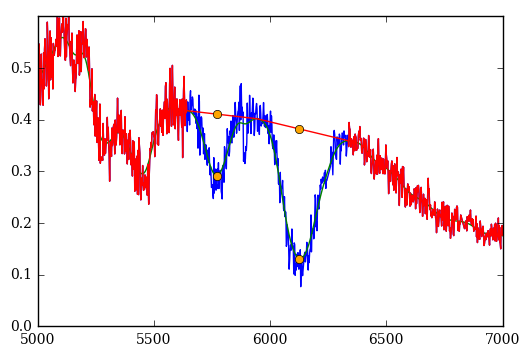

sn2002hw-20021114.10-fast.flm 1.44 0.474413180619 Check:  0.004 10.1475155127 7.34338813404
0.366950272154 2988.86234299


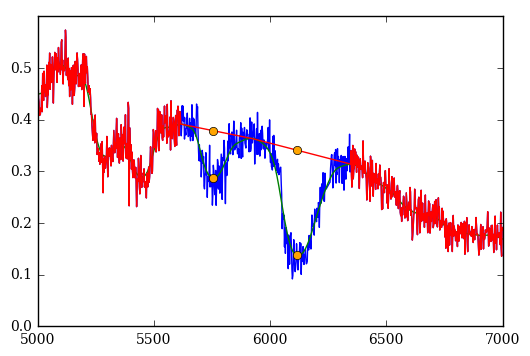

sn2003iv-20031019.38-fast.flm 1.65 0.453086289963 Check:  0.004 19.4936582378 13.1166289473
0.391911249034 4500.46296197


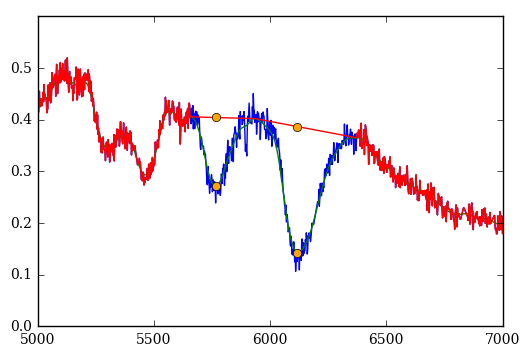

sn2006gj-20060920.43-fast.flm 1.48 0.541458980632 Check:  0.003 22.9998126788 19.217234825
0.375007859516 2487.29815702


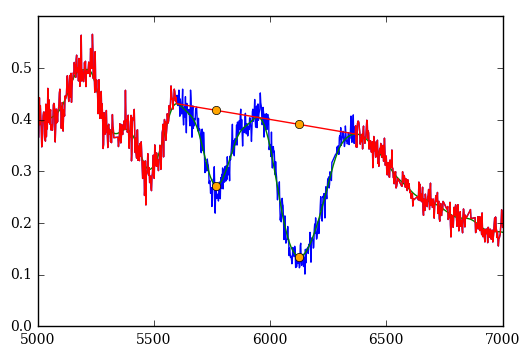

sn2007au-20070326.15-fast.flm 1.69 0.569265006736 Check:  0.004 17.4953662769 14.5404931844
5
0.27636476675 36086.1455108


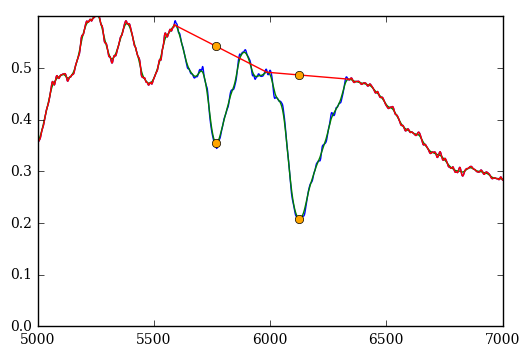

sn1991bg-19911214-noz.flm 1.88326464208 0.675237733334 Check:  0.0015 61.9607667493 55.4333249814
0.244384552841 20436.1322013


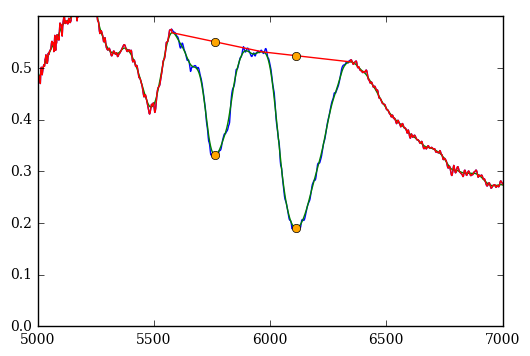

sn1999da-19990709-ui.flm 1.9 0.654825527403 Check:  0.002 44.5859389912 35.441805608
0.297457384944 1223.13317348


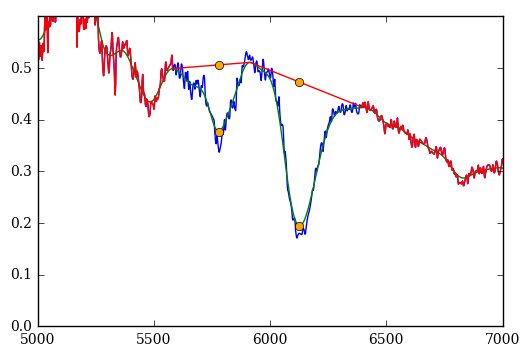

sn2006cs-20060605.335-ui.flm 2.00347119949 0.46401447019 Check:  0.004 18.3329672237 11.9352989284
0.302710501189 31266.9339752


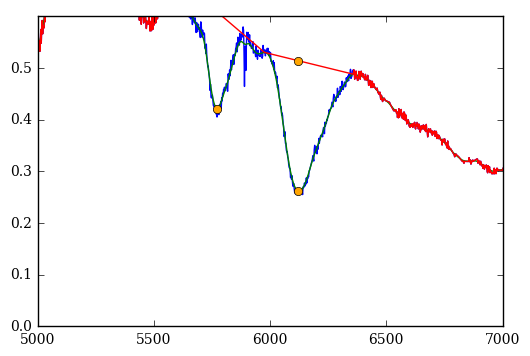

sn2007n-20070122.583-deimos.flm 1.98748908247 0.745984550204 Check:  0.002 46.7261431046 46.123607582
0.458142065465 6954.27037291


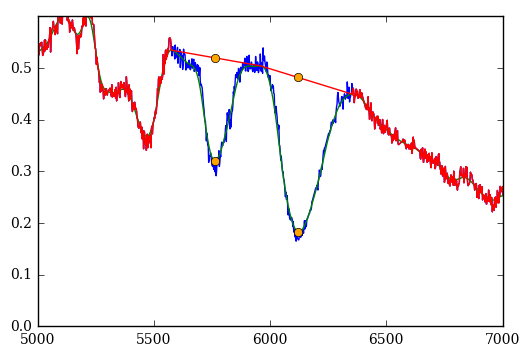

sn1998bp-19980430.47-fast.flm 1.79 0.667901513742 Check:  0.003 34.8882040327 28.7557905032
0.456601943121 1584.49200464


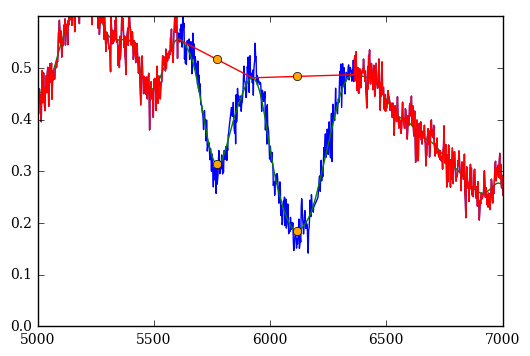

sn1998de-19980730.46-fast.flm 1.88 0.679004768556 Check:  0.004 15.7792854356 13.7634061513
0.282934437836 83021.1236406


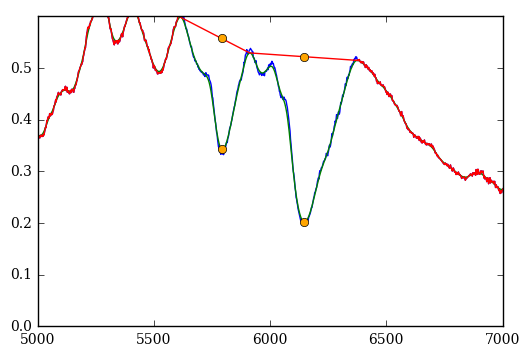

sn1999by-19990514.15-fast.flm 1.97 0.67141415027 Check:  0.001 102.043448121 96.4401838766
0.468944923109 894.008627518


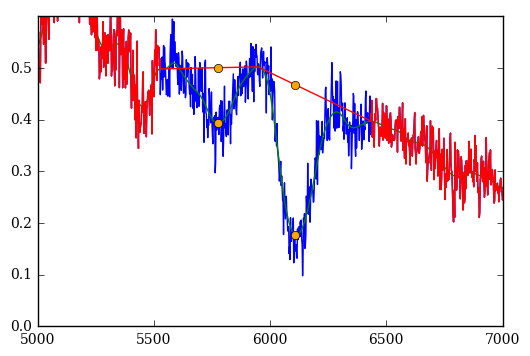

sn2002fb-20020907.51-fast.flm 1.77 0.369562098928 Check:  0.004 11.0495136625 8.93070306932
0.420839442841 32866.702396


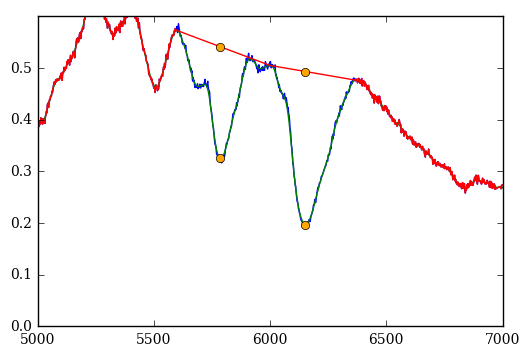

sn2005ke-20051125.30-fast.flm 1.82 0.729328326687 Check:  0.0015 75.9301264392 77.2516834187
0.456935812775 2562.10652636


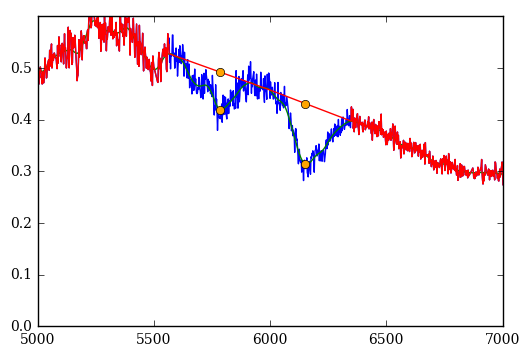

sn2007al-20070312.31-fast.flm 1.89 0.618950528011 Check:  0.003 22.3092048266 22.2710890498
0.256257960452 4321.8775109


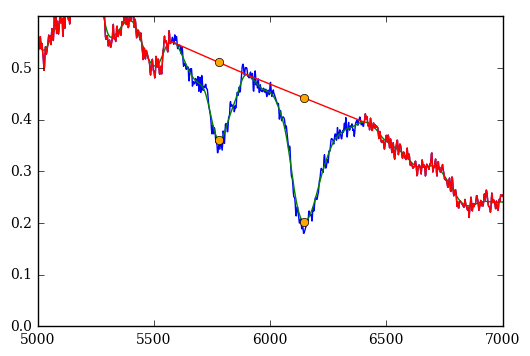

SN07ax_070326_b01_DUP_BC.dat 1.87 0.625011654389 Check:  0.003 21.3397283289 19.8323399731
0.312303867948 4933.08464909


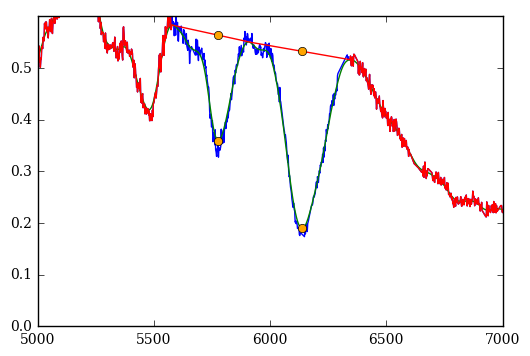

SN07ba_070409_b01_BAA_IM.dat 1.89 0.595324786169 Check:  0.003 22.7623499194 20.9643804101


In [25]:
all_dm15s_med = []
all_ratios_med = []
i=0
bad_measurements = ['sn2004dt-20040816.413-ui-corrected.flm','sn1997bp-19970407.42-mmt.flm','sn2003W-20030207.40-fast.flm',
                    'sn2005A-20050107.25-fast.flm','SN08ia_081210_r01_NTT_EF.dat','SN06mr_061109_r01_CLA_LD.dat',
                    'sn2006bt-20060428.425-ui.flm', 'sn1998es-19981125-ui-corrected.flm','sn1999aa-19990223-ui.flm',
                    'sn1999dq-19990911.46-fast.flm','sn2001V-20010301.47-fast.flm','sn2007S-20070209.30-fast.flm',
                    'SN08fp_080921_b01_DUP_WF.dat','sn2001bf-20010516-ui-corrected.flm','sn2006cz-20060626.304-ui.flm',
                    'sn1999cl-19990612.17-fast.flm','sn2005el-20050928.47-fast.flm']
for sn_arr in sn_arrays_med:
    print i
    dm15_bin = []
    ratio_bin = []
    for SN in sn_arr:
        if SN.dm15_source != None:
            dm15 = SN.dm15_source
        else:
            dm15 = SN.dm15_from_fits
        var = 1./SN.ivar
        if SN.source != 'swift_uv' and SN.filename not in bad_measurements:
            print np.median(SN.flux[SN.x1:SN.x2]), np.median(SN.ivar[SN.x1:SN.x2])
            vexp, SNR = sa.autosmooth(SN.wavelength[SN.x1:SN.x2], SN.flux[SN.x1:SN.x2], var_y = var[SN.x1:SN.x2])
            r = sa.measure_si_ratio(SN.wavelength[SN.x1:SN.x2], SN.flux[SN.x1:SN.x2], varflux = var[SN.x1:SN.x2], vexp=vexp, dm15 = dm15)
            print SN.filename, dm15, r, 'Check: ', vexp, SNR, SN.SNR
            dm15_bin.append(dm15)
            ratio_bin.append(r)
    all_dm15s_med.append(dm15_bin)
    all_ratios_med.append(ratio_bin)
    i+=1

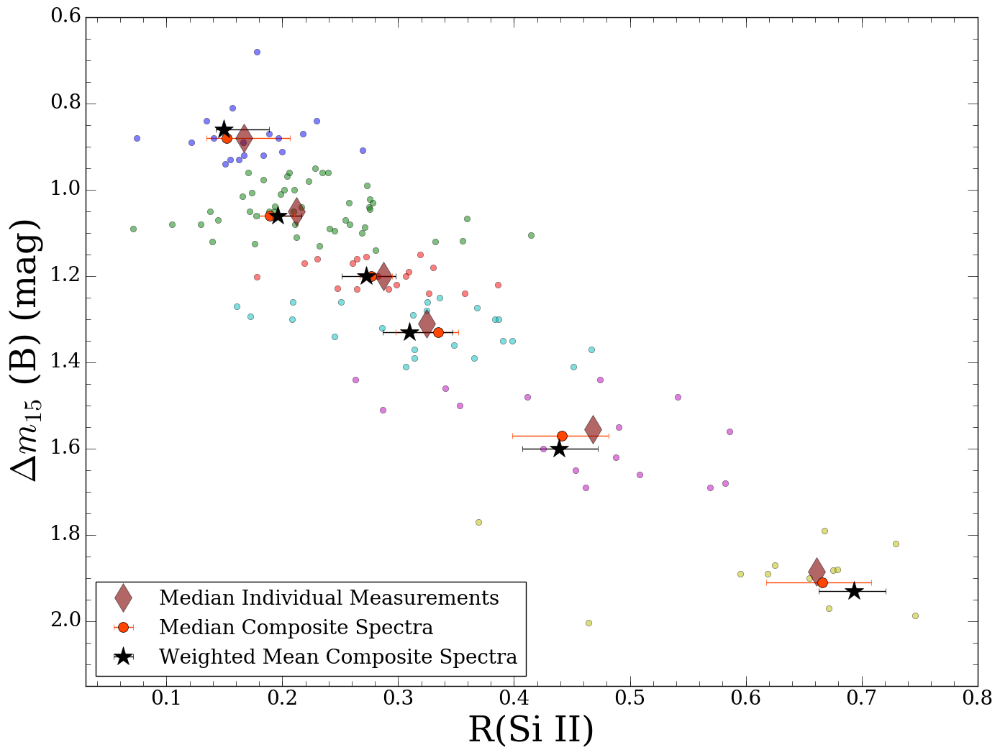

In [27]:
plt.rc('font', family='serif')
fig, ax = plt.subplots(1,1)
fig.set_size_inches(16, 12, forward = True)
plt.minorticks_on()
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.xlabel('R(Si II)', fontsize = 35)
plt.ylabel('$\Delta m_{15}$ (B) (mag)', fontsize = 35)
plt.tick_params(
    which='major', 
    bottom='on', 
    top='on',
    left='on',
    right='on',
    length=10)
plt.tick_params(
    which='minor', 
    bottom='on', 
    top='on',
    left='on',
    right='on',
    length=5)
dm15_bin_medians = []
ratio_bin_medians = []
for i in range(len(all_dm15s_med)):
    dm15_bin_medians.append(np.nanmedian(all_dm15s_med[i]))
    ratio_bin_medians.append(np.nanmedian(all_ratios_med[i]))
    plt.plot(np.asarray(all_ratios_med[i]), all_dm15s_med[i], 'o', alpha=.5)
plt.plot(ratio_bin_medians, dm15_bin_medians, 'd', markersize=20, alpha=.6, color = 'maroon', label='Median Individual Measurements')
plt.errorbar(si_ratios_med, dm15s_med, xerr=errors_med, color = 'orangered', fmt='o', markersize=10, label='Median Composite Spectra')
plt.errorbar(si_ratios_mean, dm15s_mean, xerr=errors_mean, fmt='k*', markersize=20, label='Weighted Mean Composite Spectra')
plt.gca().invert_yaxis()
plt.xlim([0.03,0.8])
plt.ylim([2.15, 0.6])
plt.legend(loc=3, fontsize = 20, numpoints=1)
plt.savefig('../../../Paper_Drafts/main_composites/si_ratio_wmedian.pdf', dpi = 300, bbox_inches = 'tight')
plt.savefig('../../../FLASH/si_ratio_median.png', dpi = 300, bbox_inches = 'tight')
plt.show()

In [38]:
test_dm15s = []
test_ratios = []
for SN in sn_arrays_med[1]:
    if SN.dm15_source != None:
        dm15 = SN.dm15_source
    else:
        dm15 = SN.dm15_from_fits
    var = 1./SN.ivar
#     r = sa.measure_si_ratio(SN.wavelength[SN.x1:SN.x2], SN.flux[SN.x1:SN.x2], varflux = var[SN.x1:SN.x2], vexp=.002, dm15 = dm15)
    print SN.filename, dm15, SN.phase

sn1998dk-19980831-ui.flm 1.05 -0.54
sn2001bf-20010516-ui-corrected.flm 0.99 1.22
sn2001da-20010716-ui-corrected.flm 1.12 -1.12
sn2001fe-20011115-ui.flm 1.0 -0.99
sn2002bo-20020322-ui-corrected.flm 1.08 -1.08
sn2002de-20020608.374-ui-corrected.flm 0.96 -0.32
sn2004dt-20040824-vis2-corrected.flm 1.14 1.38
sn2004fu-20041119-ui.flm 1.08 2.43
sn2005ag-20050212.596-br.flm 1.01576626674 0.52
sn2005cf-20050610.7-uvot.flm 1.1 -2.7
sn2005ms-20060106.400-ui.flm 0.977959604108 -1.88
sn2005na-20060105.335-ui.flm 1.09 0.03
sn2006bt-20060505.444-ui.flm 1.0 2.27
sn2006cz-20060620.266-ui.flm 1.00098460136 1.12
sn2006or-20061123.654-br.flm 1.0351558298 -2.79
sn2007a-20070113.208-br.flm 0.95 2.37
sn2007af-20070313.545-ui-corrected.flm 1.04 -1.25
sn2007bz-20070426.419-ui.flm 1.05 1.65
sn2007o-20070122.663-deimos.flm 1.08812276376 -0.33
sn1994ae-19941201.50-fast.flm 0.96 2.0
sn1996ab-19960522.37-fast.flm 1.01 1.47
sn1996bl-19961018.18-fast.flm 1.07 -2.32
sn1997dt-19971204.11-fast.flm 1.04 0.209999999999
sn

In [130]:
comp1 = comps_dm15_max_fewer_bins_med[0]
comp2 = comps_dm15_max_fewer_bins_mean[0]

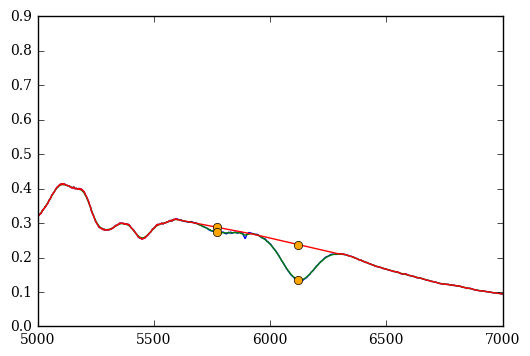

0.142816643794
done
done
done
done
done
done


In [131]:
r = sa.measure_si_ratio(comp2.wavelength[comp2.x1:comp2.x2], comp2.flux[comp2.x1:comp2.x2], vexp=.002)
print r
scale_n = np.linspace(.1,3,100)
r_dist_comps = []
noise_level_comps = []
for comp in comps_dm15_max_fewer_bins_mean:
    r_dist = []
    noise_level = []
    for n in scale_n:
        noise = np.random.normal(0., scale=n*.01, size=len(comp.flux))
        r_noise = sa.measure_si_ratio(comp.wavelength[comp.x1:comp.x2], comp.flux[comp.x1:comp.x2]+noise[comp.x1:comp.x2], vexp=.002, plot=False)
        noise_level.append(n*.01)
        r_dist.append(r_noise)
    r_dist_comps.append(r_dist)
    noise_level_comps.append(noise_level)
    print 'done'

0.189457511023


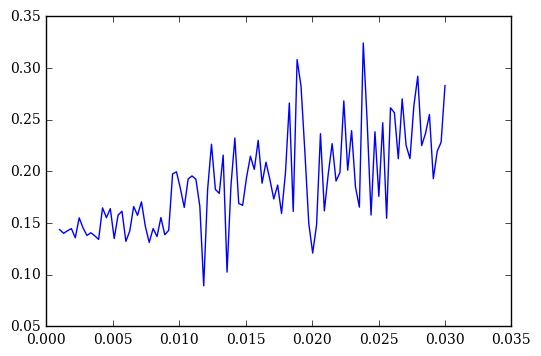

0.209406689513


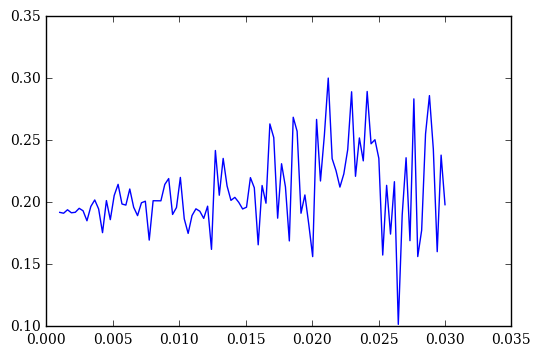

0.278637559562


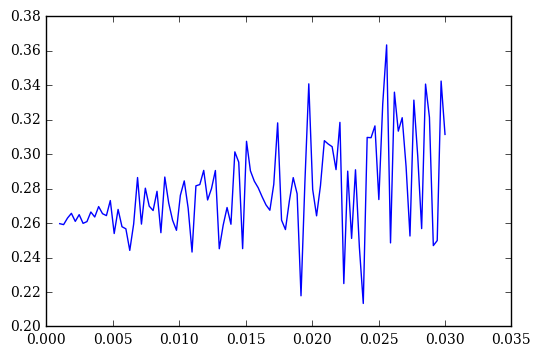

0.328324350482


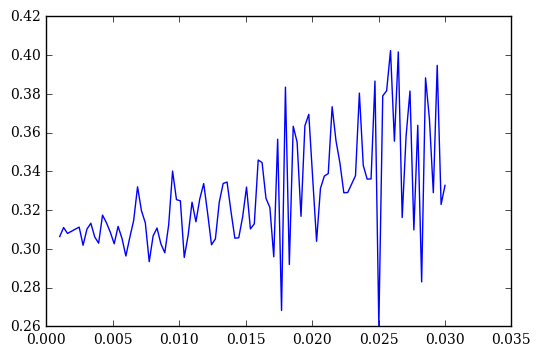

0.429638891641


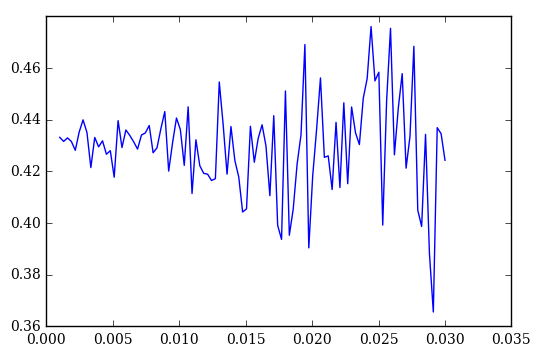

0.673744013832


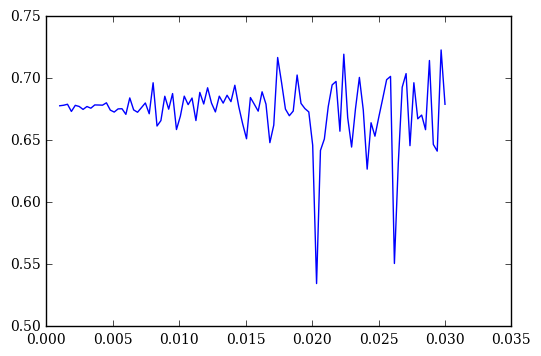

In [132]:
for i in range(len(r_dist_comps)):
    print np.average(r_dist_comps[i])
    plt.plot(noise_level_comps[i], r_dist_comps[i])
    plt.show()

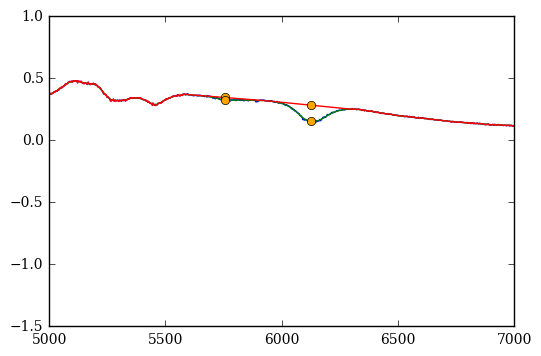

0.151973550521
done
done
done
done
done
done


In [133]:
r = sa.measure_si_ratio(comp1.wavelength[comp1.x1:comp1.x2], comp1.flux[comp1.x1:comp1.x2], vexp=.002)
print r
scale_n = np.linspace(.1,3,100)
r_dist_comps = []
noise_level_comps = []
for comp in comps_dm15_max_fewer_bins_med:
    r_dist = []
    noise_level = []
    for n in scale_n:
        noise = np.random.normal(0., scale=n*.01, size=len(comp.flux))
        r_noise = sa.measure_si_ratio(comp.wavelength[comp.x1:comp.x2], comp.flux[comp.x1:comp.x2]+noise[comp.x1:comp.x2], vexp=.002, plot=False)
        noise_level.append(n*.01)
        r_dist.append(r_noise)
    r_dist_comps.append(r_dist)
    noise_level_comps.append(noise_level)
    print 'done'

0.176726577757


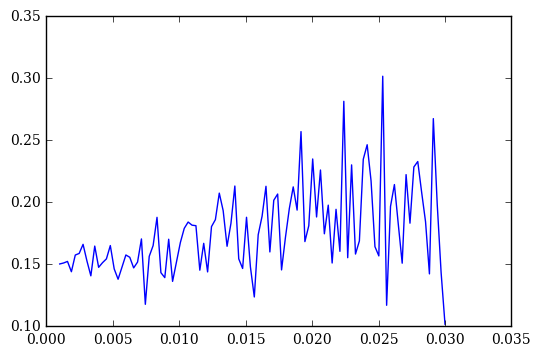

0.206528972512


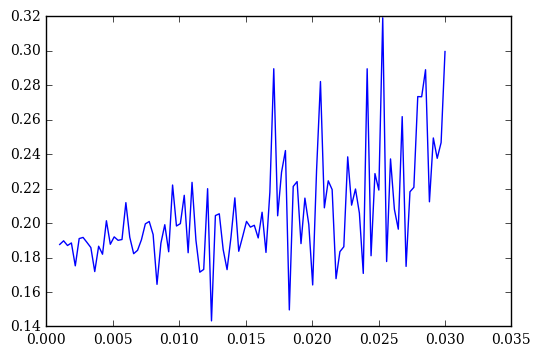

0.291981386018


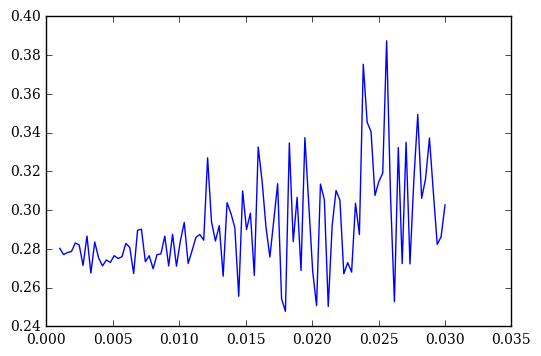

0.341507161476


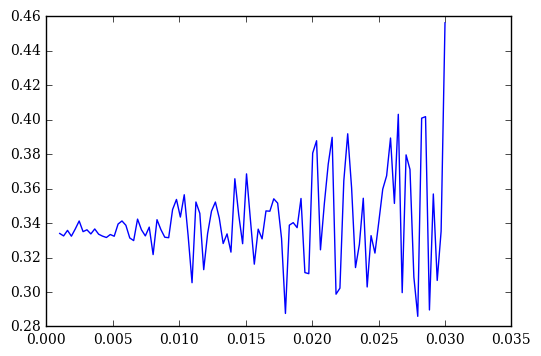

0.436933812483


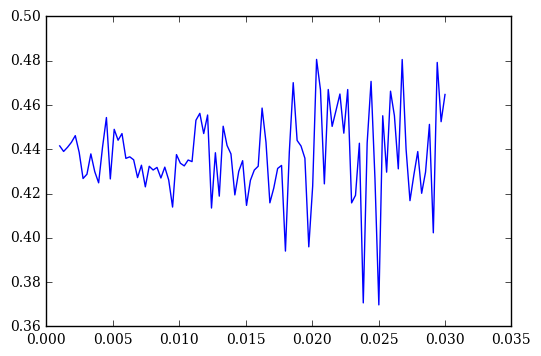

0.658354289286


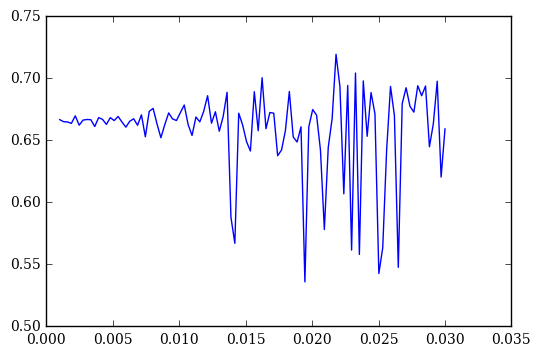

In [134]:
for i in range(len(r_dist_comps)):
    print np.average(r_dist_comps[i])
    plt.plot(noise_level_comps[i], r_dist_comps[i])
    plt.show()